# Предсказания заболеваний поджелудочной железы

# Описание задачи

Данные взяты из статьи 2020 года: https://journals.plos.org/plosmedicine/article?id=10.1371/journal.pmed.1003489
Сам датасет можно скачать отсюда: https://www.kaggle.com/datasets/johnjdavisiv/urinary-biomarkers-for-pancreatic-cancer

В статье Сильваны Дебернарди и ее коллег, опубликованной в 2020 году в журнале PLOS Medicine, международная команда исследователей пыталась разработать точный диагностический тест для наиболее распространенного типа рака поджелудочной железы, называемого раком поджелудочной железы с протоковыми аденокарциномами или PDAC. Они собрали ряд биомаркеров из мочи трех групп пациентов:

**Здоровые и контрольные группы**
В датасете содержатся данные следующих пациентов:
*   Пациенты с неопухолевыми заболеваниями поджелудочной железы, такими как хронический панкреатит
*   Пациенты с раком поджелудочной железы с протоковыми аденокарциномами

При возможности эти пациенты были стратифицированы по возрасту и полу. Цель заключалась в разработке точного способа идентификации пациентов с раком поджелудочной железы.


**Данные**
Основными характеристиками являются четыре мочевых биомаркера: креатинин, LYVE1, REG1B и TFF1.

Креатинин - это белок, который часто используется как показатель функции почек.

YVLE1 - это рецептор гиалуронана лимфатических сосудов эндотелия, белок, который может играть роль в метастазировании опухолей.

REG1B - это белок, который может быть связан с регенерацией поджелудочной железы.

TFF1 - трефоил фактор 1, который может быть связан с регенерацией и восстановлением мочевого тракта.

Возраст и пол, также включенные в набор данных, могут также играть роль в том, кто страдает раком поджелудочной железы. В набор данных также включены несколько других биомаркеров, но они не были измерены у всех пациентов (они были собраны частично для измерения того, как различные кровяные биомаркеры сравниваются с мочевыми биомаркерами).

**Целевая колонка** называется diagnosis.

*   1 - здоровый пациент
*   2 - неопухолевое заболевание поджелудочной железы
*   3 - злокачественная опухоль поджелудочной железы с протоковыми аденокарциномами

# Загрузка библиотек

In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
import joblib
import time
import pickle
import joblib
import optuna
import os
import tqdm
import ast
import lightautoml
import torch
import torch.nn as nn
import torch.optim as optim
import copy

from mpl_toolkits.mplot3d import Axes3D
from torch.utils.data import DataLoader, TensorDataset, Subset
from pytorch_tabnet.tab_model import TabNetClassifier
from tabpfn import TabPFNClassifier
from sklearn.inspection import permutation_importance
from catboost import CatBoostClassifier
from sklearn.utils import resample
from sklearn.model_selection import cross_val_score, StratifiedKFold, KFold
from sklearn.metrics import (accuracy_score, f1_score, roc_auc_score,
                             average_precision_score, precision_score, 
                            recall_score, roc_curve, auc, confusion_matrix, 
                            precision_recall_curve, RocCurveDisplay, ConfusionMatrixDisplay, 
                            classification_report)

from sklearn import metrics
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler, RobustScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from ydata_profiling import ProfileReport
from ydata_profiling.config import Settings
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from lightautoml.automl.presets.tabular_presets import TabularUtilizedAutoML
from lightautoml.tasks import Task

%matplotlib inline
plt.style.use("seaborn-v0_8")
sns.set_style('white')

'nlp' extra dependency package 'gensim' isn't installed. Look at README.md in repo 'LightAutoML' for installation instructions.
'nlp' extra dependency package 'nltk' isn't installed. Look at README.md in repo 'LightAutoML' for installation instructions.
'nlp' extra dependency package 'transformers' isn't installed. Look at README.md in repo 'LightAutoML' for installation instructions.
'nlp' extra dependency package 'gensim' isn't installed. Look at README.md in repo 'LightAutoML' for installation instructions.
'nlp' extra dependency package 'nltk' isn't installed. Look at README.md in repo 'LightAutoML' for installation instructions.
'nlp' extra dependency package 'transformers' isn't installed. Look at README.md in repo 'LightAutoML' for installation instructions.


D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\lightautoml\ml_algo\dl_model.py:42: UserWarning: 'transformers' - package isn't installed
  warnings.warn("'transformers' - package isn't installed")
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\lightautoml\text\embed.py:22: UserWarning: 'transformers' - package isn't installed
  warnings.warn("'transformers' - package isn't installed")
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\lightautoml\text\dl_transformers.py:25: UserWarning: 'transformers' - package isn't installed
  warnings.warn("'transformers' - package isn't installed")


# Загрузка данных

In [10]:
df = pd.read_csv (r'C:\Users\555\Desktop\BioML\NN\practice\Debernardi_et_al_2020_data.csv')

In [22]:
print(df.shape)
df.head()

(590, 14)


,sample_id,patient_cohort,sample_origin,age,sex,diagnosis,stage,benign_sample_diagnosis,plasma_CA19_9,creatinine,LYVE1,REG1B,TFF1,REG1A
0,S1,Cohort1,BPTB,33,F,1,NaN,NaN,11.7,1.83222,0.893219,52.94884,654.282174,1262.000
1,S10,Cohort1,BPTB,81,F,1,NaN,NaN,NaN,0.97266,2.037585,94.46703,209.488250,228.407
2,S100,Cohort2,BPTB,51,M,1,NaN,NaN,7.0,0.78039,0.145589,102.36600,461.141000,NaN
3,S101,Cohort2,BPTB,61,M,1,NaN,NaN,8.0,0.70122,0.002805,60.57900,142.950000,NaN
4,S102,Cohort2,BPTB,62,M,1,NaN,NaN,9.0,0.21489,0.000860,65.54000,41.088000,NaN


# EDA

In [12]:
# Просмотр числа пропусков
df.isnull().sum()

sample_id                    0
patient_cohort               0
sample_origin                0
age                          0
sex                          0
diagnosis                    0
stage                      391
benign_sample_diagnosis    382
plasma_CA19_9              240
creatinine                   0
LYVE1                        0
REG1B                        0
TFF1                         0
REG1A                      284
dtype: int64

In [14]:
df.describe(include='all')

,sample_id,patient_cohort,sample_origin,age,sex,diagnosis,stage,benign_sample_diagnosis,plasma_CA19_9,creatinine,LYVE1,REG1B,TFF1,REG1A
count,590,590,590,590.000000,590,590.000000,199,208,350.000000,590.000000,590.000000,590.000000,590.000000,306.000000
unique,590,2,4,NaN,2,NaN,8,52,NaN,NaN,NaN,NaN,NaN,NaN
top,S1,Cohort1,BPTB,NaN,F,NaN,III,Pancreatitis,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,332,409,NaN,299,NaN,76,41,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,59.079661,NaN,2.027119,NaN,NaN,654.002944,0.855383,3.063530,111.774090,597.868722,735.281222
std,NaN,NaN,NaN,13.109520,NaN,0.804873,NaN,NaN,2430.317642,0.639028,3.438796,196.267110,1010.477245,1477.247724
min,NaN,NaN,NaN,26.000000,NaN,1.000000,NaN,NaN,0.000000,0.056550,0.000129,0.001104,0.005293,0.000000
25%,NaN,NaN,NaN,50.000000,NaN,1.000000,NaN,NaN,8.000000,0.373230,0.167179,10.757216,43.961000,80.692000
50%,NaN,NaN,NaN,60.000000,NaN,2.000000,NaN,NaN,26.500000,0.723840,1.649862,34.303353,259.873974,208.538500
75%,NaN,NaN,NaN,69.000000,NaN,3.000000,NaN,NaN,294.000000,1.139482,5.205037,122.741013,742.736000,649.000000


In [246]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590 entries, 0 to 589
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   sample_id                590 non-null    object 
 1   patient_cohort           590 non-null    object 
 2   sample_origin            590 non-null    object 
 3   age                      590 non-null    int64  
 4   sex                      590 non-null    object 
 5   diagnosis                590 non-null    int64  
 6   stage                    199 non-null    object 
 7   benign_sample_diagnosis  208 non-null    object 
 8   plasma_CA19_9            350 non-null    float64
 9   creatinine               590 non-null    float64
 10  LYVE1                    590 non-null    float64
 11  REG1B                    590 non-null    float64
 12  TFF1                     590 non-null    float64
 13  REG1A                    306 non-null    float64
dtypes: float64(6), int64(2), o

In [20]:
# Просмтор числа значений-выбросов
for feature in df.select_dtypes(include=['float64', 'int64']).columns:
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    IQR = Q3 - Q1
    outliers = df[(df[feature] < Q1 - 1.5 * IQR) | (df[feature] > Q3 + 1.5 * IQR)]
    print(f"{feature}: {len(outliers)} выбросов")

age: 0 выбросов
diagnosis: 0 выбросов
plasma_CA19_9: 55 выбросов
creatinine: 26 выбросов
LYVE1: 8 выбросов
REG1B: 58 выбросов
TFF1: 48 выбросов
REG1A: 43 выбросов


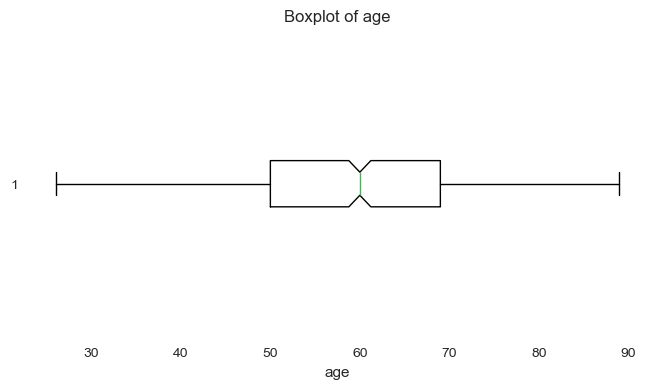

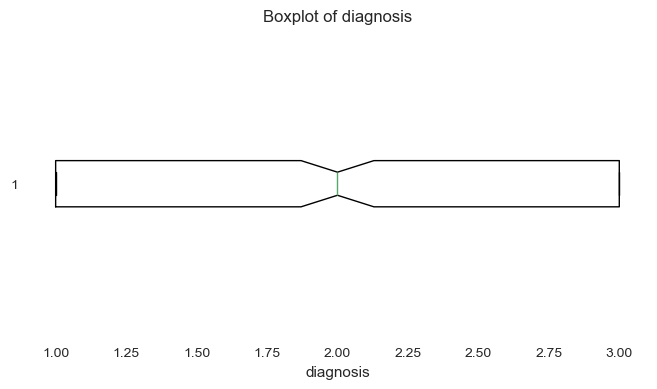

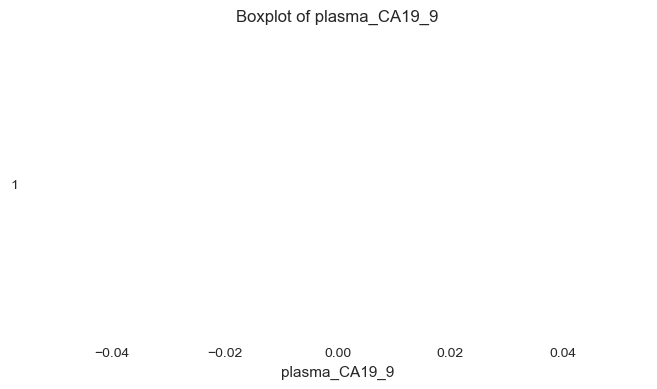

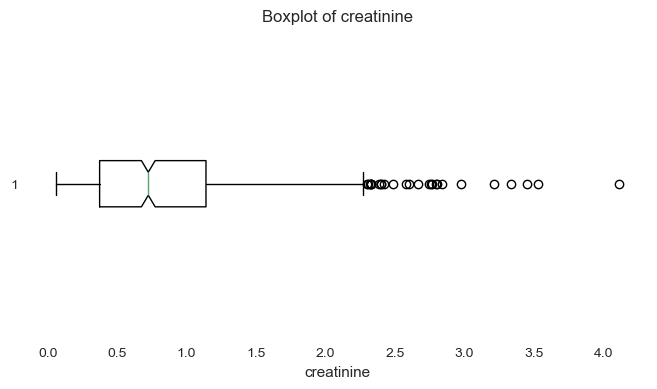

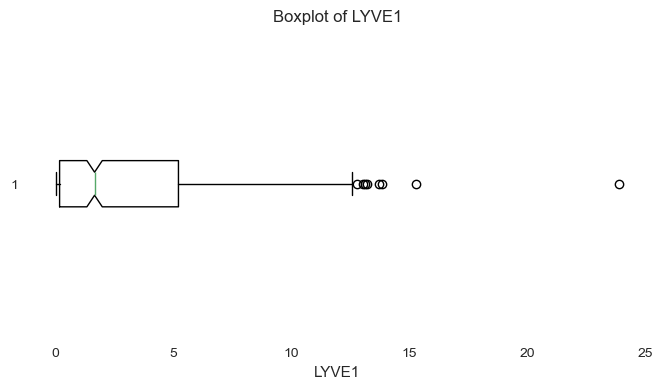

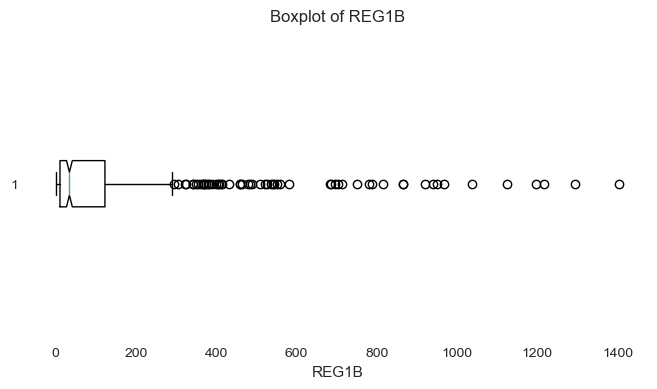

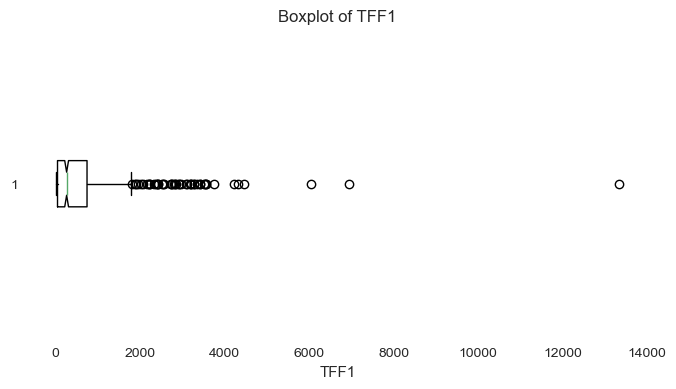

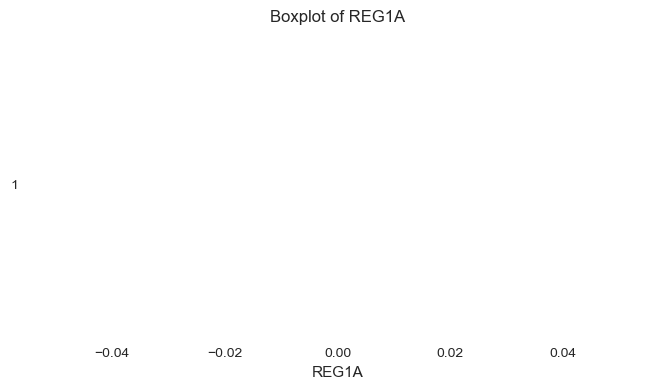

In [22]:
# ВИзуализация выбросов

def plot_individual_boxplots(df):
    num_cols = df.select_dtypes(include=['float64', 'int64']).columns

    for col in num_cols:
        plt.figure(figsize=(8, 4))
        plt.boxplot(df[col], vert=False, notch=True)
        plt.title(f"Boxplot of {col}")
        plt.xlabel(col)
        plt.show()

plot_individual_boxplots(df)

In [24]:
#  Корреляция числовых признаков
correlation_matrix = df.select_dtypes(['int64', 'float64']).corr()
print("Correlation Matrix:")
print(correlation_matrix)

Correlation Matrix:
                    age  diagnosis  plasma_CA19_9  creatinine     LYVE1  \
age            1.000000   0.308251       0.143203   -0.069393  0.329805   
diagnosis      0.308251   1.000000       0.263950    0.074888  0.540384   
plasma_CA19_9  0.143203   0.263950       1.000000   -0.029418  0.257115   
creatinine    -0.069393   0.074888      -0.029418    1.000000  0.338533   
LYVE1          0.329805   0.540384       0.257115    0.338533  1.000000   
REG1B          0.204317   0.383516       0.175814    0.261906  0.543075   
TFF1           0.207868   0.392613       0.150694    0.397795  0.577363   
REG1A          0.060082   0.260110       0.123293    0.060248  0.277696   

                  REG1B      TFF1     REG1A  
age            0.204317  0.207868  0.060082  
diagnosis      0.383516  0.392613  0.260110  
plasma_CA19_9  0.175814  0.150694  0.123293  
creatinine     0.261906  0.397795  0.060248  
LYVE1          0.543075  0.577363  0.277696  
REG1B          1.000000  0.6

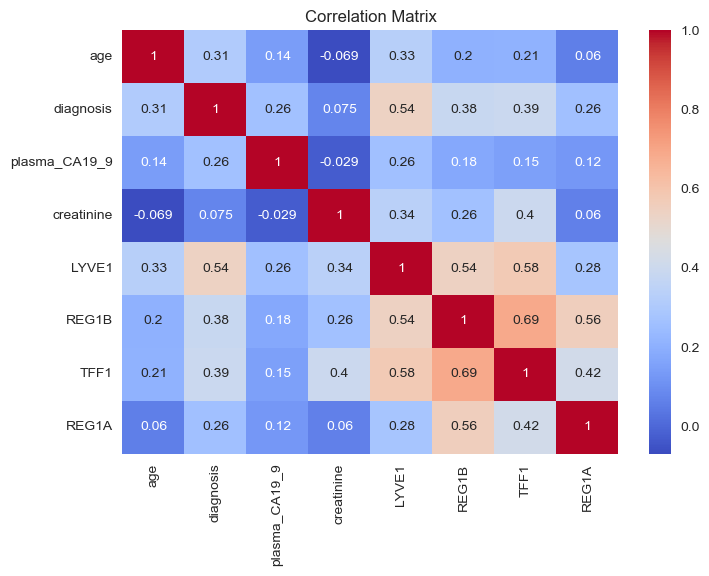

In [26]:
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.title("Correlation Matrix")
plt.show();

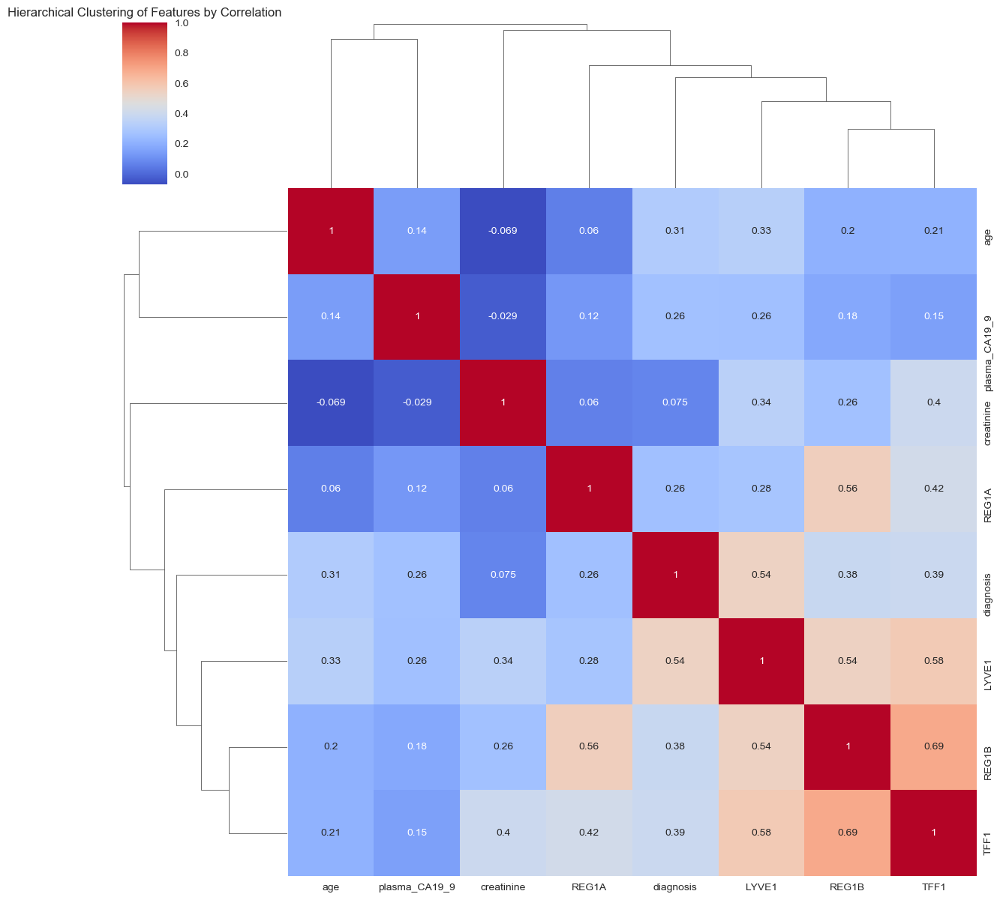

In [28]:
sns.clustermap(correlation_matrix, cmap='coolwarm', figsize=(12, 12), annot=True)
plt.title("Hierarchical Clustering of Features by Correlation")
plt.show()

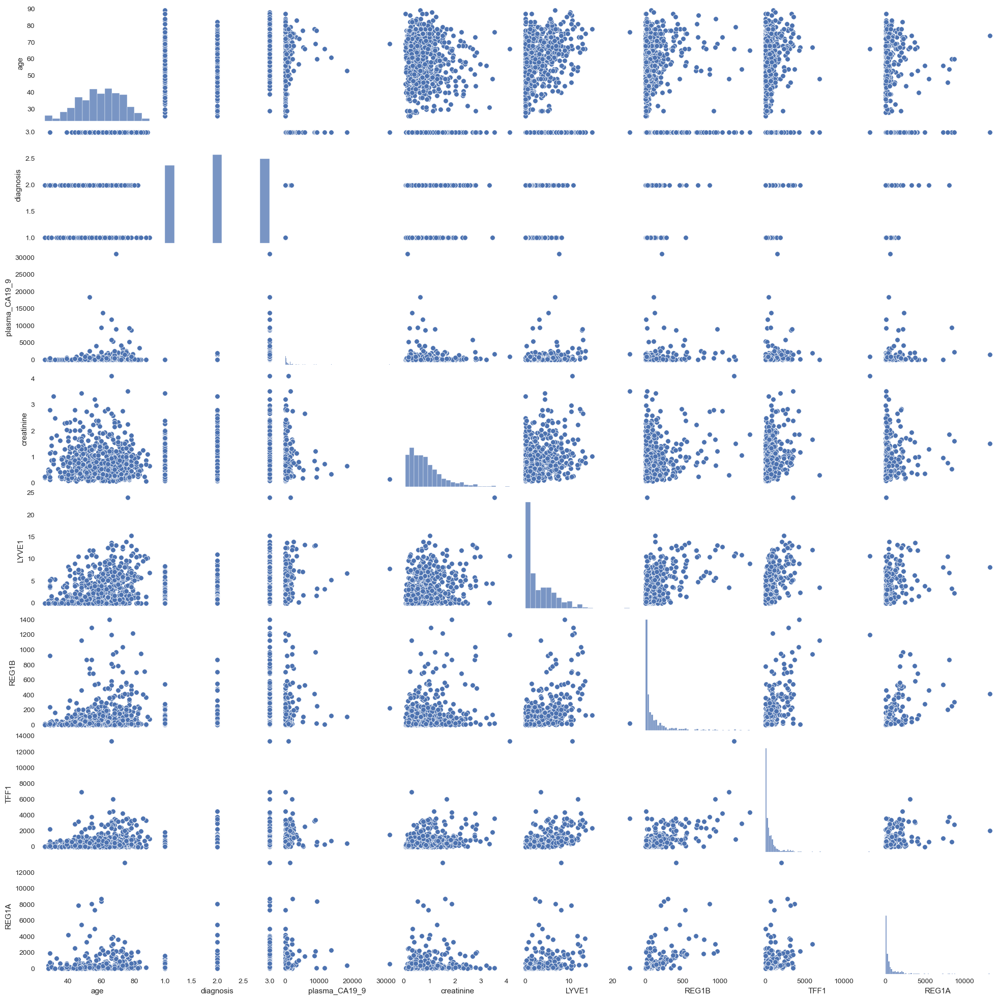

In [30]:
# Визуализация взаимосвязей
sns.pairplot(df.select_dtypes(['int64', 'float64']))
plt.show()

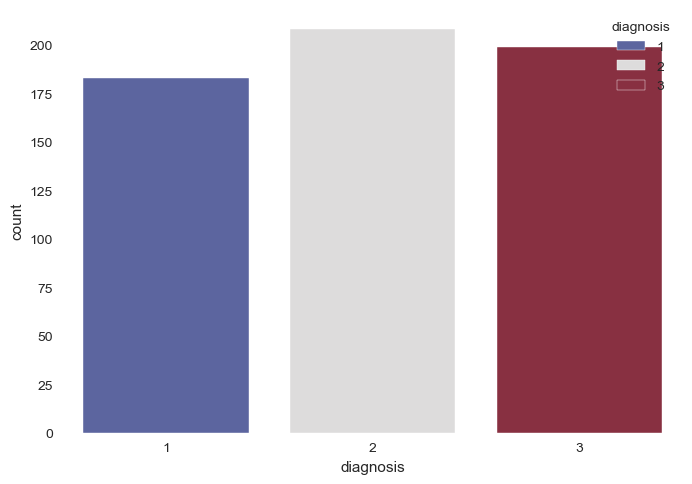

In [32]:
# Визулизация распределения тагретной переменной
sns.countplot(data=df, x='diagnosis', hue='diagnosis', palette='coolwarm', legend='auto', saturation=0.5);

In [34]:
# Отчет из ydata-profiling
# Создаём базовые настройки
base_config = Settings()

# Обновляем необходимые параметры
custom_config = base_config.update({
    "correlations": {
        "pearson": {"active": True},
        "spearman": {"active": True},
        "kendall": {"active": True},
        "phi_k": {"active": True},
        "cramers": {"active": True}
    },
    "missing_diagrams": {
        "heatmap": True,
        "dendrogram": True
    },
    "interactions": {
        "continuous": True
    },
    "duplicates": {
        "head": 10
    }
})

profile = ProfileReport(
    df,
    config=custom_config,
    title="Pancreatic Cancer Biomarkers EDA Report",
    explorative=True
)

profile.to_file("eda_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 14/14 [00:00<00:00, 796.35it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [36]:
profile

In [264]:
# Категориальные признаки

In [38]:
types = df.dtypes
cat_features = list(types[(types == 'object')].index)
cat_features

['sample_id',
 'patient_cohort',
 'sample_origin',
 'sex',
 'stage',
 'benign_sample_diagnosis']

In [40]:
cat_features = cat_features[1:]

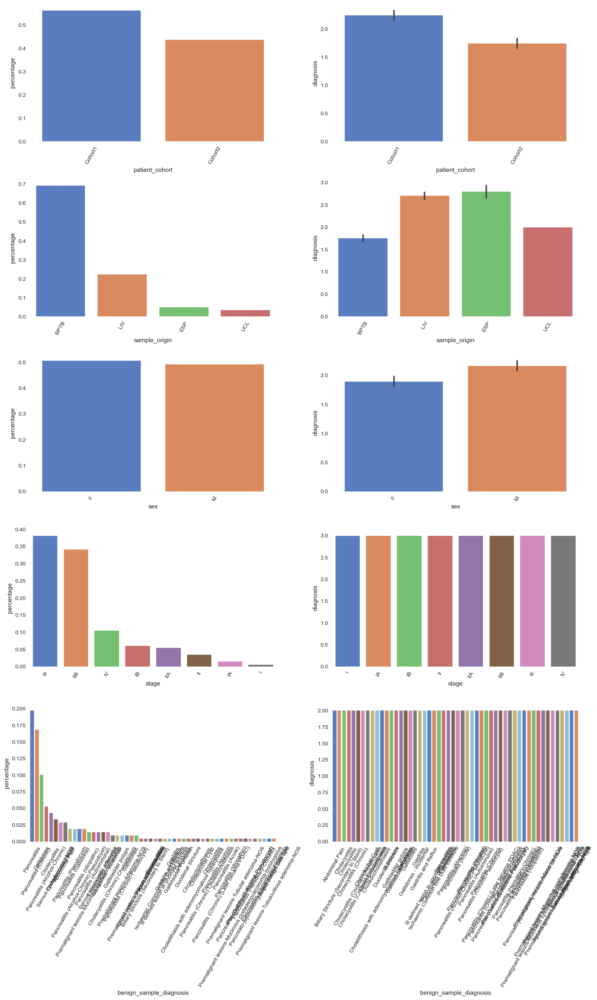

In [44]:
n = len(cat_features)
fig, axes = plt.subplots(n, 2, figsize=(15, 5 * n))  # динамическая высота

for i, feature in enumerate(cat_features):
    count_data = (df[feature].value_counts(normalize=True)
                  .sort_values(ascending=False)
                  .rename('percentage')
                  .reset_index()
                  .rename(columns={'index': feature}))

    sns.barplot(data=count_data, x=feature, y='percentage', ax=axes[i][0],
                hue=feature, palette="muted", legend=False)
    axes[i][0].xaxis.set_tick_params(rotation=60)

    sns.barplot(data=df, x=feature, y='diagnosis', ax=axes[i][1],
                hue=feature, palette="muted", legend=False)
    axes[i][1].xaxis.set_tick_params(rotation=60)

plt.tight_layout()

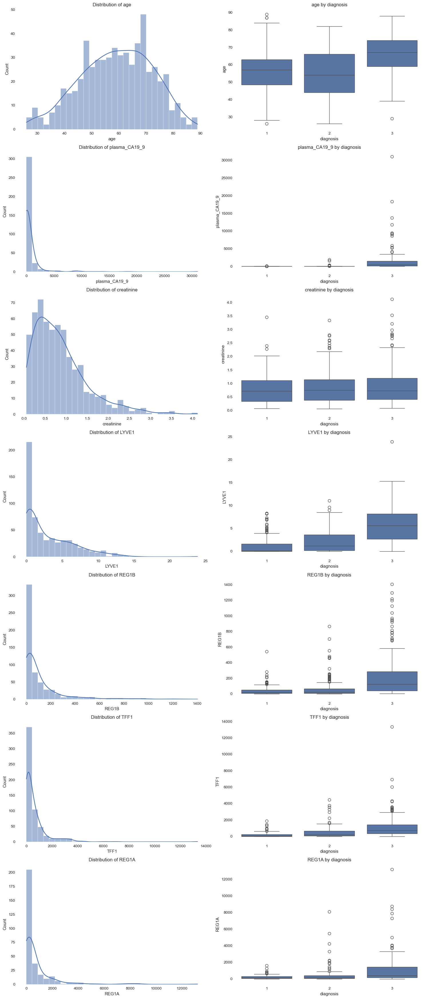

In [46]:
# Получаем числовые фичи
num_features = list(df.select_dtypes(include=['int64', 'float64']).columns)
num_features.remove('diagnosis') 

n = len(num_features)
fig, axes = plt.subplots(n, 2, figsize=(15, 5 * n))

for i, feature in enumerate(num_features):
    # Распределение признака (гистограмма + KDE)
    sns.histplot(data=df, x=feature, kde=True, ax=axes[i][0], bins=30)
    axes[i][0].set_title(f'Distribution of {feature}')

    # Boxplot по классам
    sns.boxplot(data=df, x='diagnosis', y=feature, ax=axes[i][1])
    axes[i][1].set_title(f'{feature} by diagnosis')

plt.tight_layout()

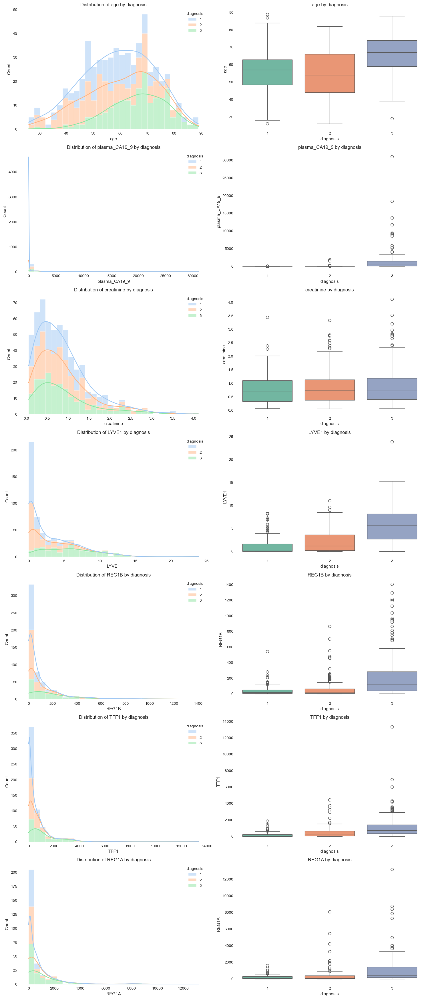

In [48]:
n = len(num_features)
fig, axes = plt.subplots(n, 2, figsize=(15, 5 * n))

for i, feature in enumerate(num_features):
    # Гистограмма по классам (с цветом)
    sns.histplot(data=df, x=feature, hue='diagnosis', kde=True, ax=axes[i][0], bins=30, palette='pastel', multiple='stack')
    axes[i][0].set_title(f'Distribution of {feature} by diagnosis')

    # Boxplot по классам (с цветом)
    sns.boxplot(data=df, x='diagnosis', y=feature, hue='diagnosis',
            ax=axes[i][1], palette='Set2', legend=False)
    axes[i][1].set_title(f'{feature} by diagnosis')

plt.tight_layout()

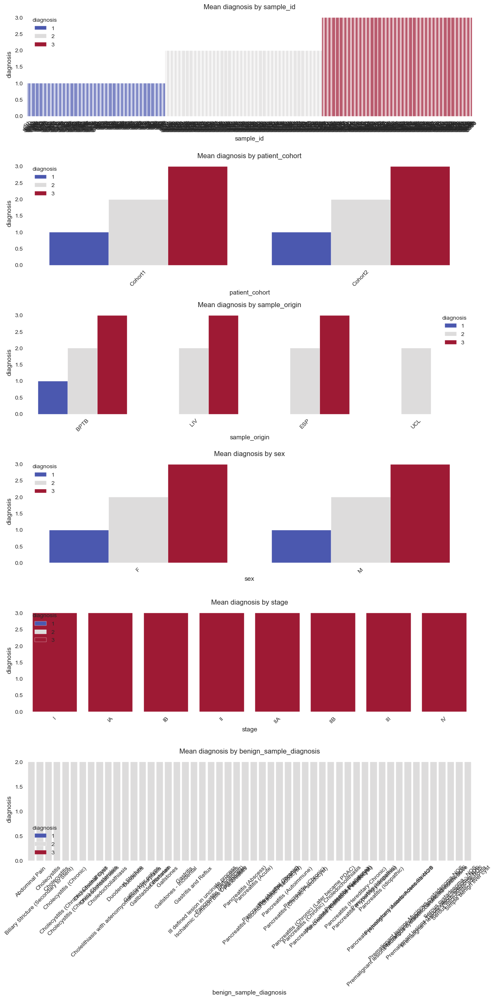

In [50]:
#Группировка категориальных признаков по целевой переменной

cat_features = df.select_dtypes(include='object').columns

n = len(cat_features)
fig, axes = plt.subplots(n, 1, figsize=(12, 4 * n))

for i, feature in enumerate(cat_features):
    sns.barplot(data=df, x=feature, y='diagnosis', estimator=np.mean, ax=axes[i], hue='diagnosis', palette='coolwarm')
    axes[i].set_title(f'Mean diagnosis by {feature}')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()

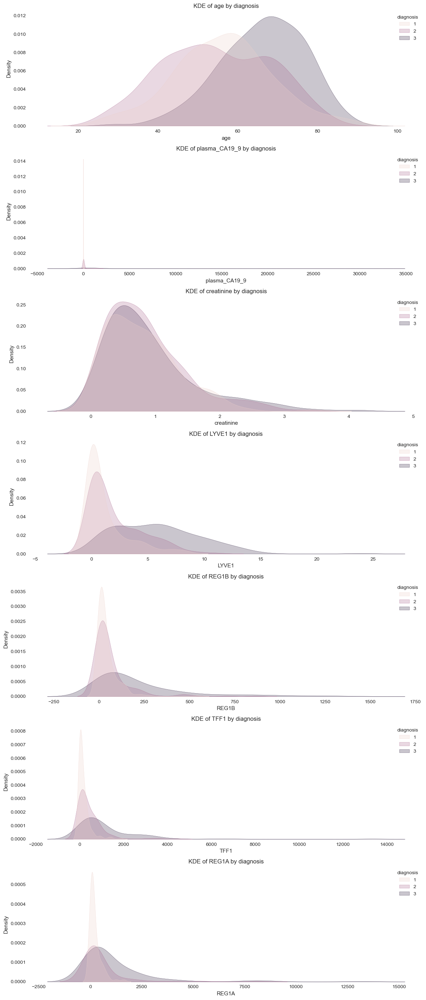

In [52]:
# KDE-графики для числовых признаков по классам
# Числовые признаки (кроме diagnosis)
num_features = df.select_dtypes(include=['int64', 'float64']).columns.drop('diagnosis')

n = len(num_features)
fig, axes = plt.subplots(n, 1, figsize=(12, 4 * n))

for i, feature in enumerate(num_features):
    sns.kdeplot(data=df, x=feature, hue='diagnosis', fill=True, ax=axes[i])
    axes[i].set_title(f'KDE of {feature} by diagnosis')

plt.tight_layout()

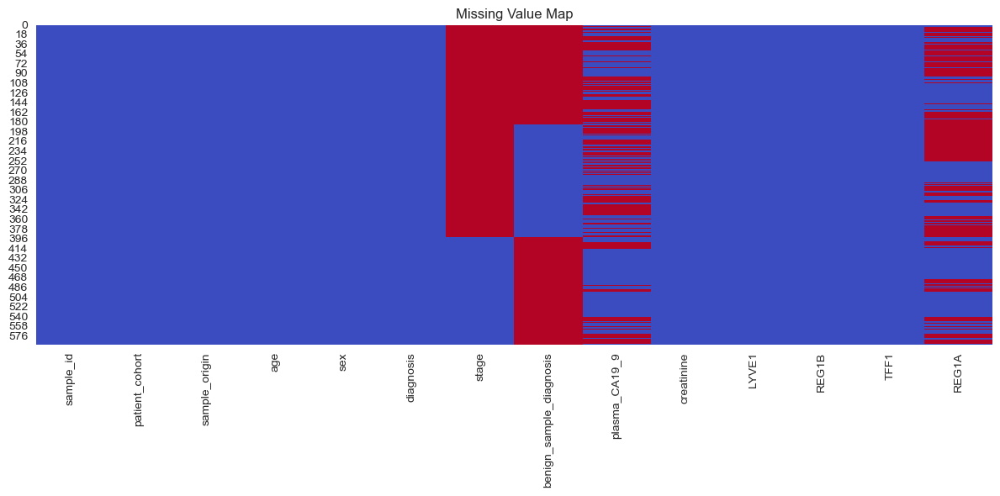

In [54]:
# Визуализация пропущенных значений (тепловая карта)
plt.figure(figsize=(12, 6))
sns.heatmap(df.isnull(), cbar=False, cmap='coolwarm')
plt.title("Missing Value Map")
plt.tight_layout()

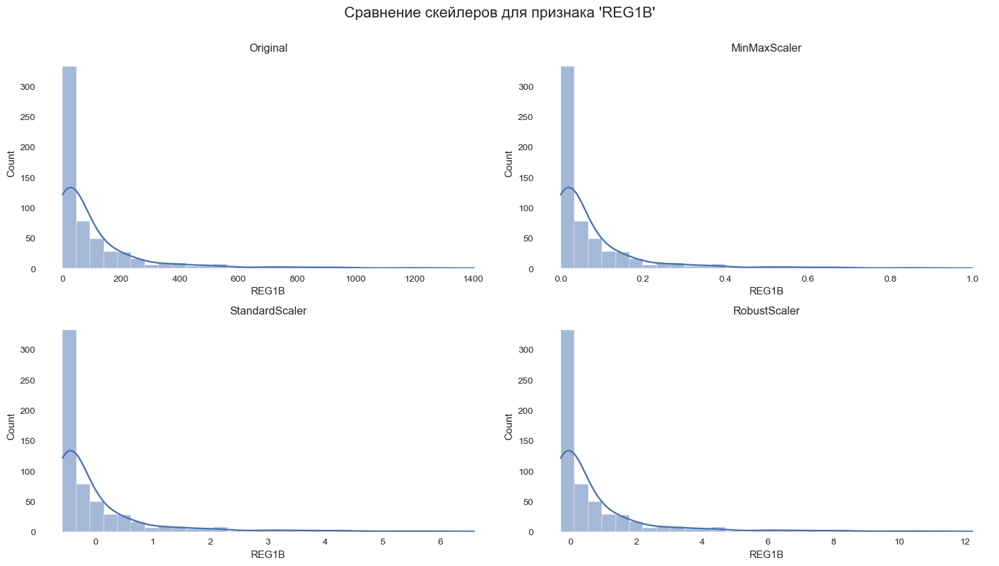

In [56]:
# Сравнение скейлеров
feature = 'REG1B'
original = np.array(df[[feature]].dropna())

# Инициализация скейлеров
scalers = {
    'Original': original,
    'MinMaxScaler': MinMaxScaler().fit_transform(original),
    'StandardScaler': StandardScaler().fit_transform(original),
    'RobustScaler': RobustScaler().fit_transform(original)
}

# Визуализация
plt.figure(figsize=(15, 8))

for i, (name, scaled) in enumerate(scalers.items()):
    plt.subplot(2, 2, i + 1)
    sns.histplot(scaled.ravel(), bins=30, kde=True)
    plt.title(name)
    plt.xlabel(feature)
    plt.tight_layout()

plt.suptitle(f"Сравнение скейлеров для признака '{feature}'", fontsize=16, y=1.05)
plt.show()

# Итоговые выводы по EDA (Exploratory Data Analysis)

# Целевая переменная
diagnosis — мультиклассовая (1 — контроль, 2 — доброкачественные, 3 — PDAC).
Распределение классов довольно равномерное: 183, 208, 199 — классовый дисбаланс отсутствует.

# Числовые признаки
Ключевые биомаркеры: LYVE1, REG1A, REG1B, TFF1, CA19-9, creatinine, age.
Выбросы присутствуют у большинства биомаркеров.
Распределения (особенно у биомаркеров) скошены, логарифмирование (np.log1p из-за наличия пропусков) улучшит нормальность.
Корреляции: сильная связь между REG1A и REG1B (возможно, биологическая избыточность).
Пропущенные значения: встречаются, будут заменены на нули.

# Категориальные признаки
sex (пол) будет преобразован в бинарную переменную (0 = M, 1 = F), возможен слабый вклад в модель.
Остальные признаки (stage, sample_origin, cohort) будут удалены для исключения target leakage.
Анализ связи категориальных переменных с целевой проведён через группировку и barplot'ы.

# Визуализация
Гистограммы и KDE-графики по классам (с hue='diagnosis') позволяют понять различия между группами.
Boxplots и heatmap'ы выявляют выбросы и коррелирующие признаки.
Пропуски визуализированы через sns.heatmap.

# Размерность
Признаков немного (около 12), снижение размерности (с помощью PCA) не требуется.

# Скейлинг
Сравнены MinMaxScaler и RobustScaler.
Различия минимальны, но при наличии выбросов предпочтителен RobustScaler.

# Подготовка данных 

In [48]:
# Копия исходного датафрейма
df_processed = df.copy()

# Бинаризация пола
df_processed['sex'] = df_processed['sex'].map({'F': 1, 'M': 0})

# Перевод идентификатора в индекс (для читаемости)
df_processed = df_processed.set_index('sample_id')

# Удаляем потенциально утечные признаки (неизвестны до постановки диагноза)
leaky_cols = ['patient_cohort', 'sample_origin', 'stage', 'benign_sample_diagnosis']
df_processed = df_processed.drop(columns=leaky_cols)

# Список числовых признаков (биомаркеры + возраст)
numerical_cols = ['age', 'plasma_CA19_9', 'creatinine', 'LYVE1', 'REG1B', 'TFF1', 'REG1A']

# Применим log1p ко всем признакам, кроме возраста (он уже распределён нормально)
for col in numerical_cols[1:]:  # без 'age'
    df_processed[col] = np.log1p(df_processed[col])

# Добавим пол в признаки (если хотим его использовать)
feature_cols = numerical_cols + ['sex']

# Добавляем целевую переменную
final_cols = feature_cols + ['diagnosis']

# Финальный датафрейм
dataset = df_processed[final_cols]

# Заполняем пропуски нулями (альтернатива — использовать импретеры)
dataset = dataset.fillna(0)

# Отдельно сохраним матрицу признаков и вектор ответов
X = dataset.drop(columns='diagnosis').values
y = dataset['diagnosis'].values

print(f"Финальная форма X: {X.shape}, y: {y.shape}")

Финальная форма X: (590, 8), y: (590,)


In [36]:
# Сохраняем названия признаков
feature_names = dataset.drop(columns='diagnosis').columns.tolist()

# Опционально: сохраняем в файл (например, на случай работы в разных ноутбуках)
with open(r'C:\Users\555\Desktop\BioML\NN\practice\feature_names.txt', 'w') as f:
    for name in feature_names:
        f.write(f"{name}\n")

In [38]:
dataset.head()

,age,plasma_CA19_9,creatinine,LYVE1,REG1B,TFF1,REG1A,sex,diagnosis
sample_id,,,,,,,,,
S1,33,2.541602,1.041061,0.638279,3.988036,6.485066,7.141245,1,1
S10,81,0.000000,0.679383,1.111063,4.558781,5.349430,5.435498,1,1
S100,51,2.079442,0.576832,0.135919,4.638276,6.135870,0.000000,0,1
S101,61,2.197225,0.531346,0.002801,4.120321,4.969466,0.000000,0,1
S102,62,2.302585,0.194654,0.000859,4.197803,3.739763,0.000000,0,1


In [50]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state = 1, test_size = 0.2)

In [52]:
# Стандартизация

scaler = RobustScaler()
scaler.fit(X_train)

X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

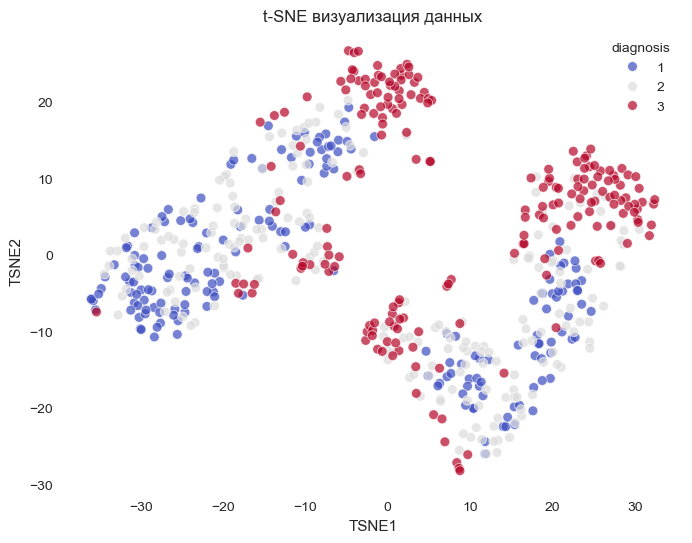

In [232]:
# t-SNE визуализация данных
scaler = StandardScaler()
X_scaled = scaler.fit_transform(dataset.drop(columns=["diagnosis"]).select_dtypes(['int64', 'float64']))

tsne = TSNE(n_components=2, perplexity=30, random_state=42, max_iter=1000)
X_tsne = tsne.fit_transform(X_scaled)

df_tsne = pd.DataFrame(X_tsne, columns=["TSNE1", "TSNE2"])
df_tsne["diagnosis"] = df["diagnosis"].values

plt.figure(figsize=(8, 6))
sns.scatterplot(data=df_tsne, x="TSNE1", y="TSNE2", hue=df_tsne["diagnosis"], palette="coolwarm", alpha=0.7)
plt.title("t-SNE визуализация данных")
plt.show();

# Обучение моделей

In [44]:
metrics_path = r'C:\Users\555\Desktop\BioML\NN\practice\metrics_all_models.csv'

# Общая функция для собра метрик
def evaluate_model(y_true, y_pred, y_proba, model_name, stage='test', fit_time=None, num_classes=3, csv_path=metrics_path):
    result = {
        'model': model_name,
        'stage': stage,
        'accuracy': accuracy_score(y_true, y_pred),
        'f1_macro': f1_score(y_true, y_pred, average='macro'),
        'precision_macro': precision_score(y_true, y_pred, average='macro'),
        'recall_macro': recall_score(y_true, y_pred, average='macro'),
        'roc_auc_ovr': roc_auc_score(y_true, y_proba, multi_class='ovr') if num_classes > 2 else roc_auc_score(y_true, y_proba[:, 1]),
        'pr_auc_macro': average_precision_score(y_true, y_proba, average='macro'),
        'fit_time_sec': fit_time
    }

    # Сохраняем в CSV (если файл есть — добавляем строку, иначе создаём)
    try:
        df_existing = pd.read_csv(metrics_path)
        df_new = pd.concat([df_existing, pd.DataFrame([result])], ignore_index=True)
    except FileNotFoundError:
        df_new = pd.DataFrame([result])
    
    df_new.to_csv(metrics_path, index=False)
    return result

# Логистическая регрессия

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\linear_model\_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\linear_model\_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\linear_model\_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Best params: {'solver': 'liblinear', 'penalty': 'l1', 'C': 34.82790270981284}


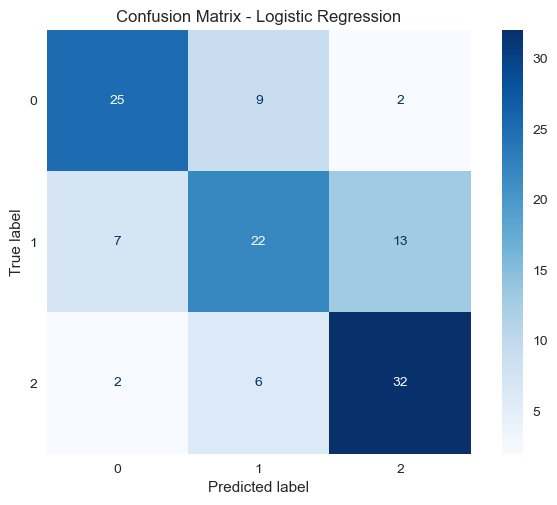

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1188: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


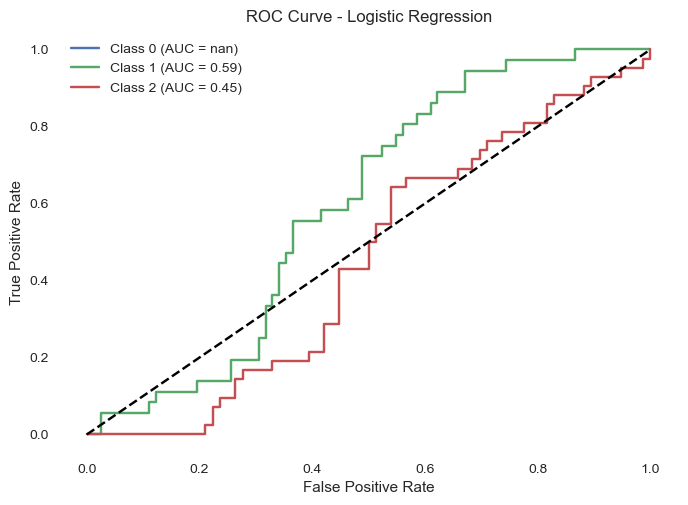

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1033: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(


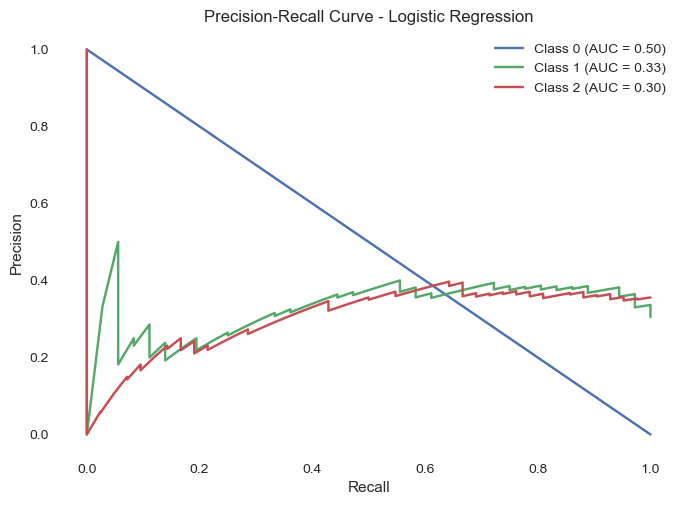

In [58]:
# 1. Optuna
def objective(trial):
    solver = trial.suggest_categorical("solver", ["liblinear", "saga", "lbfgs", "newton-cg", "sag"])

    if solver in ["liblinear", "saga"]:
        penalty = trial.suggest_categorical("penalty", ["l1", "l2"])
    else:
        penalty = "l2"

    C = trial.suggest_float("C", 1e-3, 1e2, log=True)

    try:
        clf = LogisticRegression(
            C=C,
            solver=solver,
            penalty=penalty,
            random_state=42,
            max_iter=1000
        )
        scores = cross_val_score(clf, X_train_scaled, y_train, cv=5, scoring='f1_weighted')
        return scores.mean()
    except Exception:
        return 0.0

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)
best_params = study.best_params
print("Best params:", best_params)

# 2. Обучение и оценка с записью метрик
start_time = time.time()
final_model = LogisticRegression(**best_params, random_state=42, max_iter=1000)
final_model.fit(X_train_scaled, y_train)
train_time = time.time() - start_time

# Предсказания
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Сохраняем метрики (train/test) в CSV
evaluate_model(y_train, y_train_pred, y_train_proba, model_name='LogReg', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test, y_test_pred, y_test_proba, model_name='LogReg', stage='test', fit_time=train_time, csv_path=metrics_path)

# 3. Визуализации — Confusion Matrix, ROC, PR
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - Logistic Regression")
plt.show()

# ROC-кривые
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Logistic Regression')
plt.legend()
plt.show()

# Precision-Recall кривые
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - Logistic Regression')
plt.legend()
plt.show()

# Decision Tree

Best params: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 10, 'min_samples_leaf': 9, 'max_features': None}


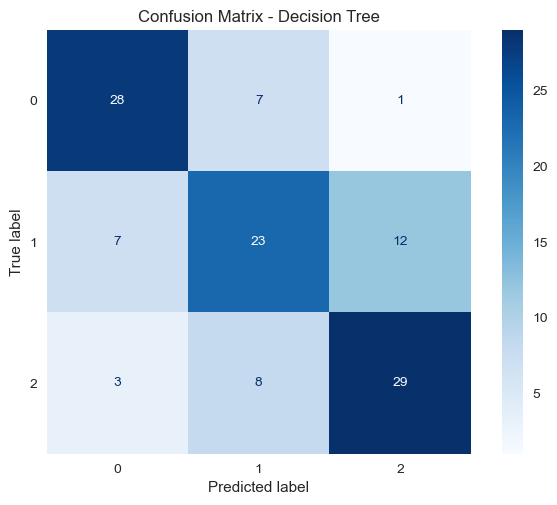

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1188: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


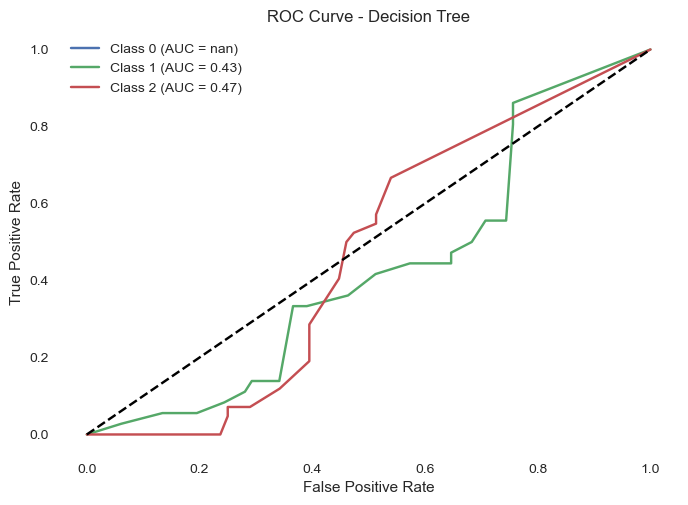

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1033: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(


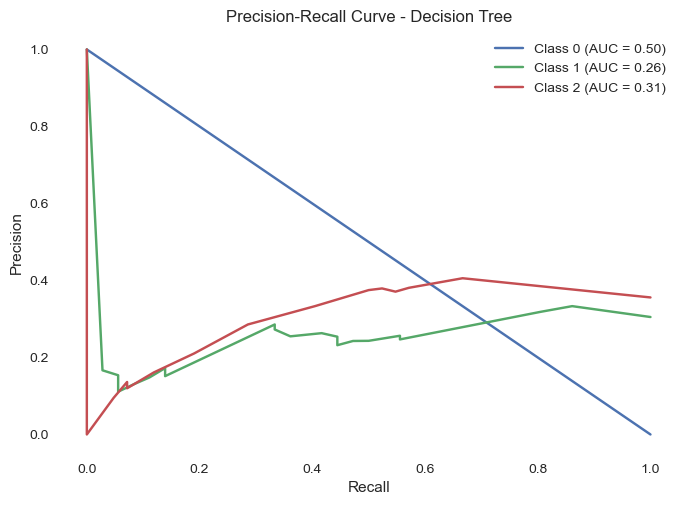

In [64]:
# Optuna Objective for Decision Tree
def objective(trial):
    params = {
        "criterion": trial.suggest_categorical("criterion", ["gini", "entropy", "log_loss"]),
        "max_depth": trial.suggest_int("max_depth", 3, 30),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 20),
        "max_features": trial.suggest_categorical("max_features", ["sqrt", "log2", None]),
        "random_state": 42
    }

    model = DecisionTreeClassifier(**params)
    scores = cross_val_score(model, X_train_scaled, y_train, cv=5, scoring="f1_weighted")
    return scores.mean()

# Оптимизация
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=40)
best_params = study.best_params
print("Best params:", best_params)

# Обучение и предсказания
start_time = time.time()
final_model = DecisionTreeClassifier(**best_params, random_state=42)
final_model.fit(X_train_scaled, y_train)
train_time = time.time() - start_time

# Предсказания и вероятности
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Сбор метрик и запись в файл
evaluate_model(y_train, y_train_pred, y_train_proba, model_name='DecisionTree', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test, y_test_pred, y_test_proba, model_name='DecisionTree', stage='test', fit_time=train_time, csv_path=metrics_path)

# Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - Decision Tree")
plt.show()

# ROC-кривая
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Decision Tree')
plt.legend()
plt.show()

# PR-кривая
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - Decision Tree')
plt.legend()
plt.show()

# Random Forest 

Best params: {'n_estimators': 71, 'max_depth': 25, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': None, 'bootstrap': True}


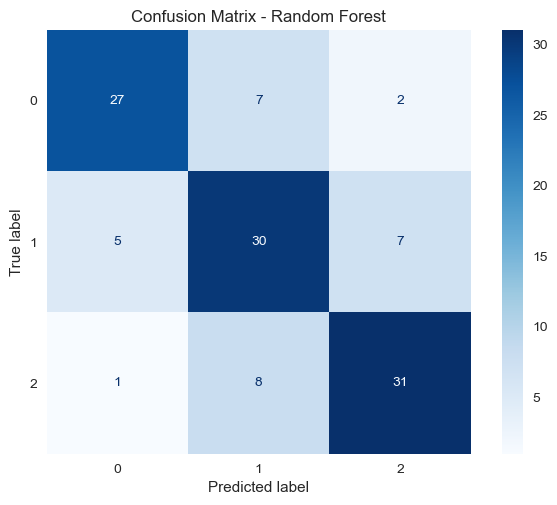

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1188: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


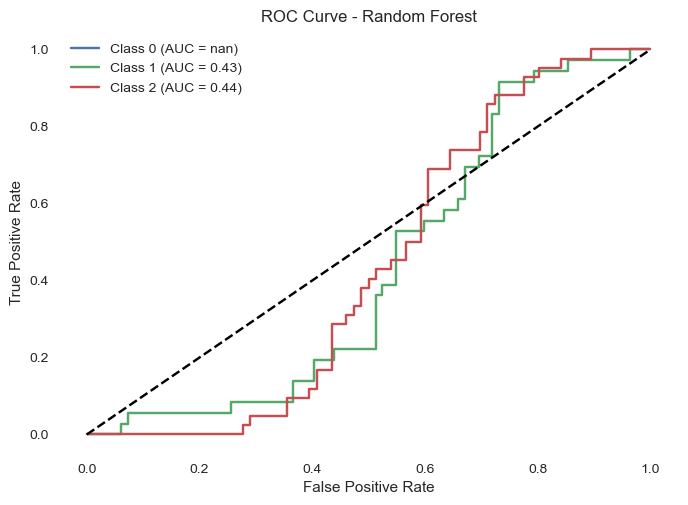

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1033: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(


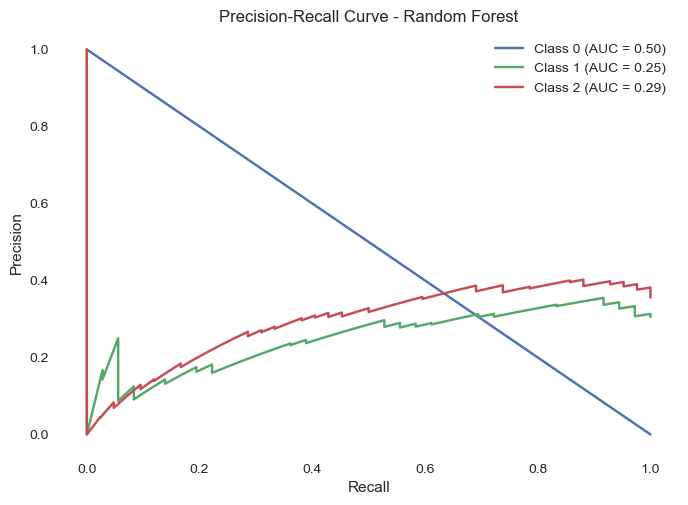

In [66]:
# Optuna Objective for Random Forest
def objective(trial):
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 300),
        "max_depth": trial.suggest_int("max_depth", 3, 30),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 20),
        "max_features": trial.suggest_categorical("max_features", ["sqrt", "log2", None]),
        "bootstrap": trial.suggest_categorical("bootstrap", [True, False]),
        "random_state": 42
    }

    model = RandomForestClassifier(**params)
    scores = cross_val_score(model, X_train_scaled, y_train, cv=5, scoring="f1_weighted")
    return scores.mean()

# Оптимизация
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=40)
best_params = study.best_params
print("Best params:", best_params)

# Обучение модели
start_time = time.time()
final_model = RandomForestClassifier(**best_params, random_state=42)
final_model.fit(X_train_scaled, y_train)
train_time = time.time() - start_time

# Предсказания
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Сбор метрик в файл
evaluate_model(y_train, y_train_pred, y_train_proba, model_name='RandomForest', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test, y_test_pred, y_test_proba, model_name='RandomForest', stage='test', fit_time=train_time, csv_path=metrics_path)

# Визуализация Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - Random Forest")
plt.show()

# ROC-кривая
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Random Forest')
plt.legend()
plt.show()

# PR-кривая
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - Random Forest')
plt.legend()
plt.show()

# SVC

Best params: {'C': 28.201197257453007, 'gamma': 0.07570672510909904, 'kernel': 'rbf'}


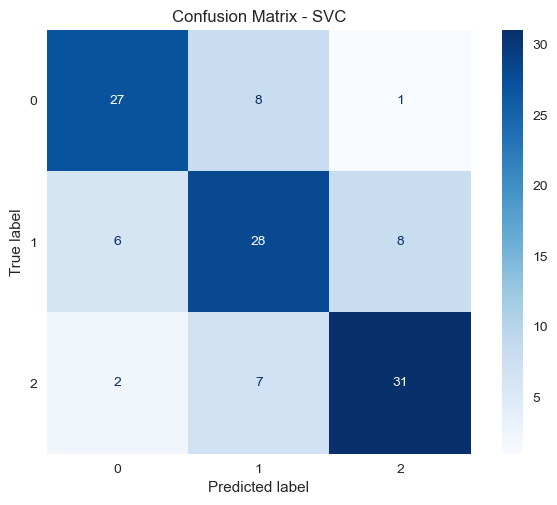

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1188: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


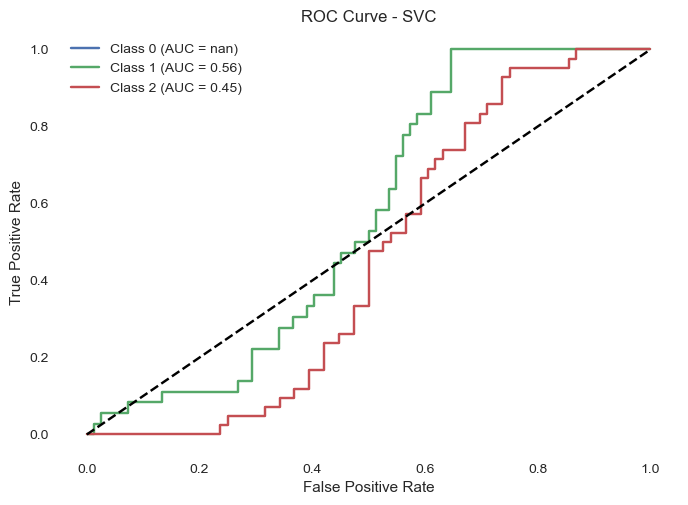

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\metrics\_ranking.py:1033: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(


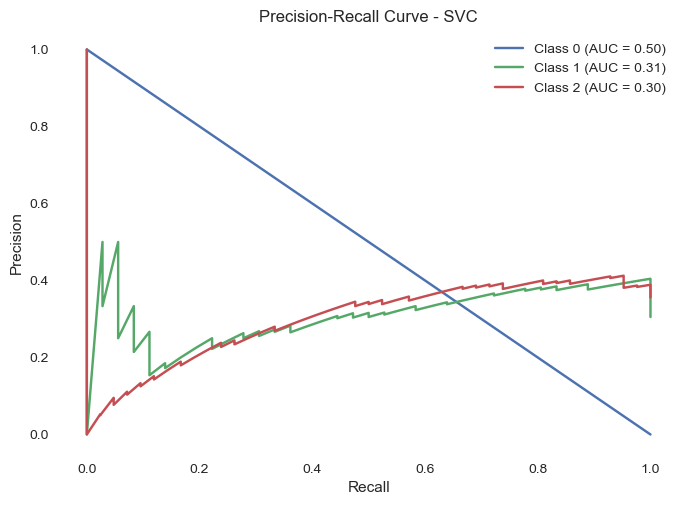

In [68]:
# Optuna Objective for SVC
def objective(trial):
    C = trial.suggest_float("C", 1e-3, 1e3, log=True)
    gamma = trial.suggest_float("gamma", 1e-4, 1e-1, log=True)
    kernel = trial.suggest_categorical("kernel", ["rbf", "poly", "sigmoid"])

    clf = SVC(C=C, gamma=gamma, kernel=kernel, probability=True, random_state=42)
    scores = cross_val_score(clf, X_train_scaled, y_train, cv=5, scoring='f1_weighted')
    return scores.mean()

# Гиперпараметры
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)
best_params = study.best_params
print("Best params:", best_params)

# Обучение
start_time = time.time()
final_model = SVC(**best_params, probability=True, random_state=42)
final_model.fit(X_train_scaled, y_train)
train_time = time.time() - start_time

# Предсказания и вероятности
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Запись метрик в файл
evaluate_model(y_train, y_train_pred, y_train_proba, model_name='SVC', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test, y_test_pred, y_test_proba, model_name='SVC', stage='test', fit_time=train_time, csv_path=metrics_path)

# Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - SVC")
plt.show()

# ROC-кривая
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - SVC')
plt.legend()
plt.show()

# Precision-Recall кривая
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - SVC')
plt.legend()
plt.show()

# XGBoost

Best params: {'n_estimators': 118, 'max_depth': 10, 'learning_rate': 0.1835758554952134, 'subsample': 0.6257340472500693, 'colsample_bytree': 0.5821430861799988, 'gamma': 0.07523295516554432, 'reg_alpha': 3.9997571730033274, 'reg_lambda': 0.9583488280945717}


D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\xgboost\core.py:158: UserWarning: [12:37:29] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


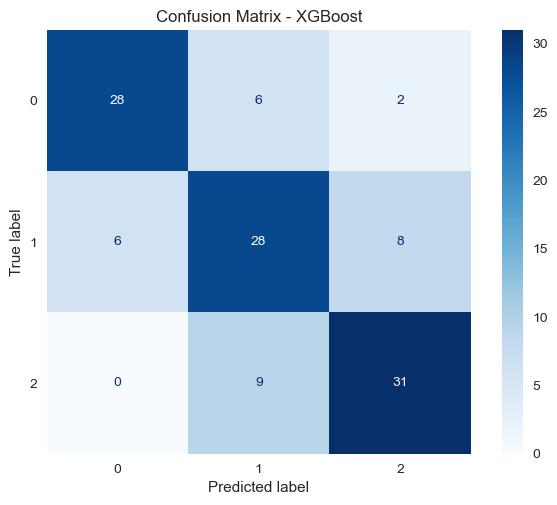

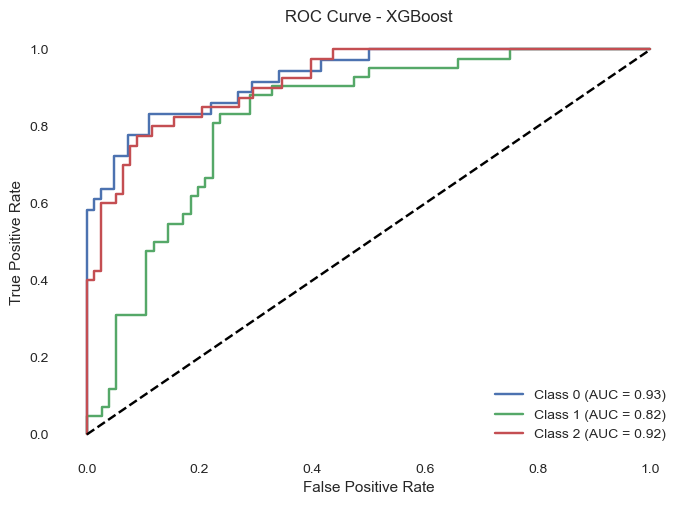

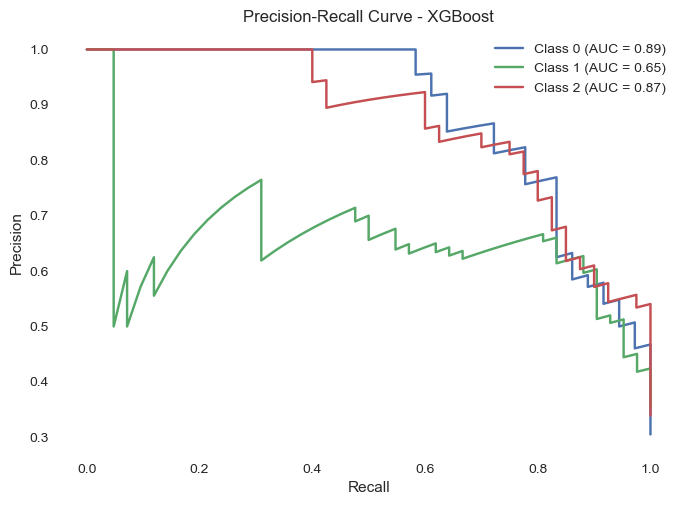

In [70]:
# Кодировщик меток для XGBoost
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
y_test_enc = le.transform(y_test)

# Optuna Objective
def objective(trial):
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 100, 300),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "gamma": trial.suggest_float("gamma", 0, 5),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 5.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.0, 5.0),
        "random_state": 42,
        "use_label_encoder": False,
        "eval_metric": "mlogloss",
        "verbosity": 0
    }
    model = XGBClassifier(**param)
    scores = cross_val_score(model, X_train_scaled, y_train_enc, cv=5, scoring='f1_weighted')
    return scores.mean()

# Оптимизация
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)
best_params = study.best_params
print("Best params:", best_params)

# Обучение
start_time = time.time()
final_model = XGBClassifier(**best_params, use_label_encoder=False, eval_metric="mlogloss", random_state=42)
final_model.fit(X_train_scaled, y_train_enc)
train_time = time.time() - start_time

# Предсказания
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Метрики
evaluate_model(y_train_enc, y_train_pred, y_train_proba, model_name='XGBoost', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test_enc, y_test_pred, y_test_proba, model_name='XGBoost', stage='test', fit_time=train_time, csv_path=metrics_path)

# Confusion Matrix
cm = confusion_matrix(y_test_enc, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - XGBoost")
plt.show()

# ROC-кривая
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_enc == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - XGBoost')
plt.legend()
plt.show()

# PR-кривая
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test_enc == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - XGBoost')
plt.legend()
plt.show()

# LIGHTGBM


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000273 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 656
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [W

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 662
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.044545
[LightGBM] [Info] Start training from score -1.090707
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 662
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.044545
[LightGBM] [Info] Start training from score -1.090707
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 654
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.052092
[LightGBM] [Info] Start training from score -1.082864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000484 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 662
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.044545
[LightGBM] [Info] Start training from score -1.090707
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 654
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.052092
[LightGBM] [Info] Start training from score -1.082864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 656
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 656
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 659
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.044545
[LightGBM] [Info] Start training from score -1.090707
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000128 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 654
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.052092
[LightGBM] [Info] Start training from score -1.082864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 653
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 654
[LightGBM] [Info] Number of data points in the train set: 378, number of used features: 8
[LightGBM] [Info] Start training from score -1.164210
[LightGBM] [Info] Start training from score -1.052092
[LightGBM] [Info] Start training from score -1.082864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 656
[LightGBM] [Info] Number of data points in the train set: 377, number of used features: 8
[LightGBM] [Info] Start training from score -1.170071
[LightGBM] [Info] Start training from score -1.041896
[LightGBM] [Info] Start training from score -1.088058
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fit

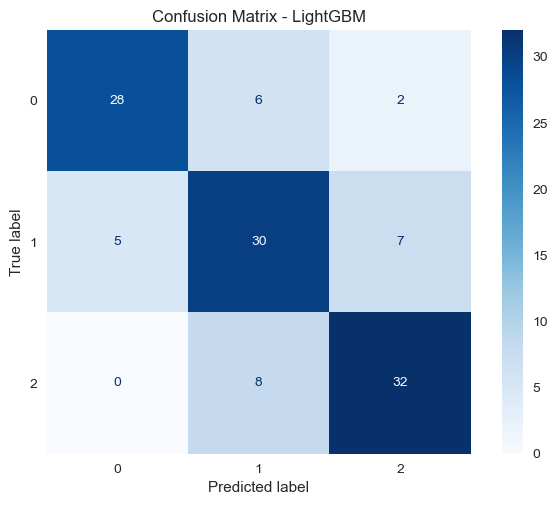

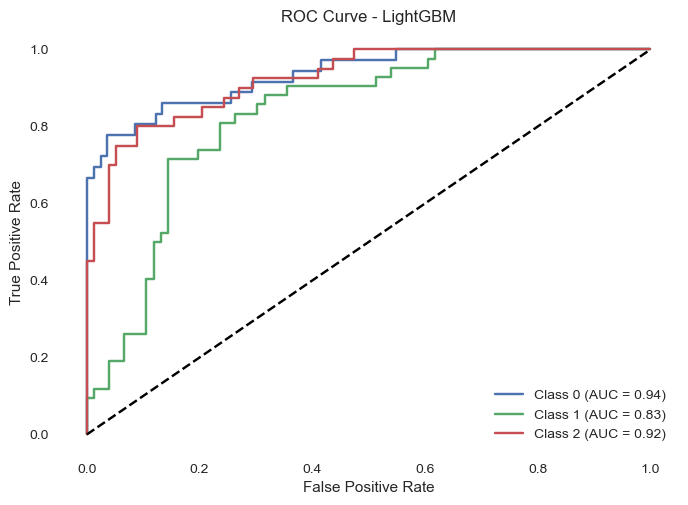

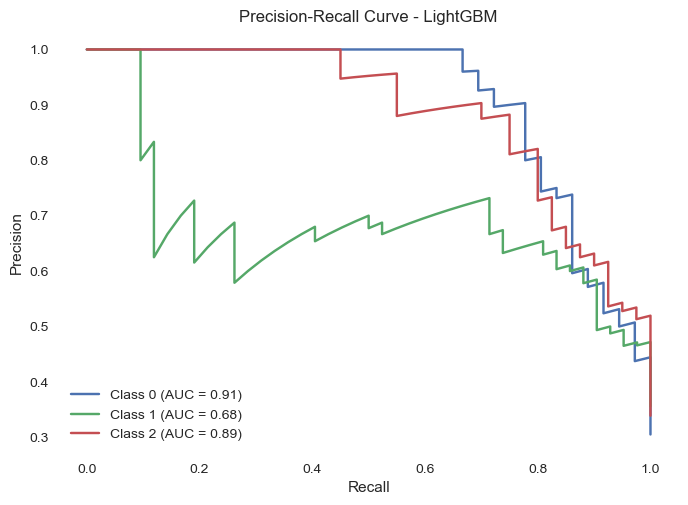

In [72]:
# Оптимизация с Optuna
def objective(trial):
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 100, 300),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 5.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.0, 5.0),
        "random_state": 42,
        "n_jobs": -1
    }
    model = LGBMClassifier(**param)
    scores = cross_val_score(model, X_train_scaled, y_train_enc, cv=5, scoring='f1_weighted')
    return scores.mean()

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)
best_params = study.best_params
print("Best params:", best_params)

# Обучение и замер времени
start_time = time.time()
final_model = LGBMClassifier(**best_params, random_state=42, verbose=-1)
final_model.fit(X_train_scaled, y_train_enc)
train_time = time.time() - start_time

# Предсказания
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Сбор метрик
evaluate_model(y_train_enc, y_train_pred, y_train_proba, model_name='LightGBM', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test_enc, y_test_pred, y_test_proba, model_name='LightGBM', stage='test', fit_time=train_time, csv_path=metrics_path)

# Confusion Matrix
cm = confusion_matrix(y_test_enc, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - LightGBM")
plt.show()

# ROC-кривая
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_enc == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - LightGBM')
plt.legend()
plt.show()

# PR-кривая
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test_enc == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - LightGBM')
plt.legend()
plt.show()

# CATBOOST

Best params: {'iterations': 201, 'depth': 10, 'learning_rate': 0.1235388039723867, 'l2_leaf_reg': 7.6635143748557955}


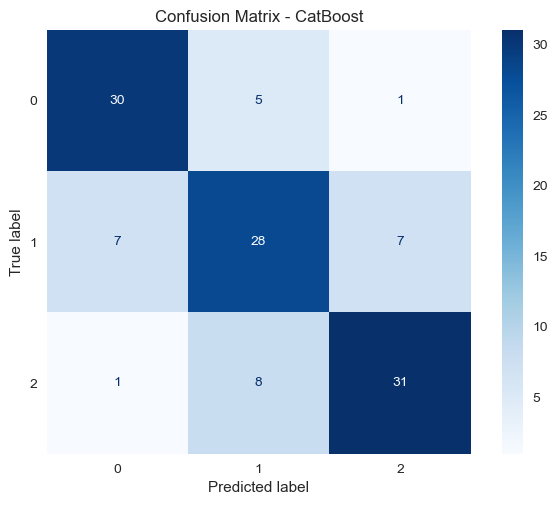

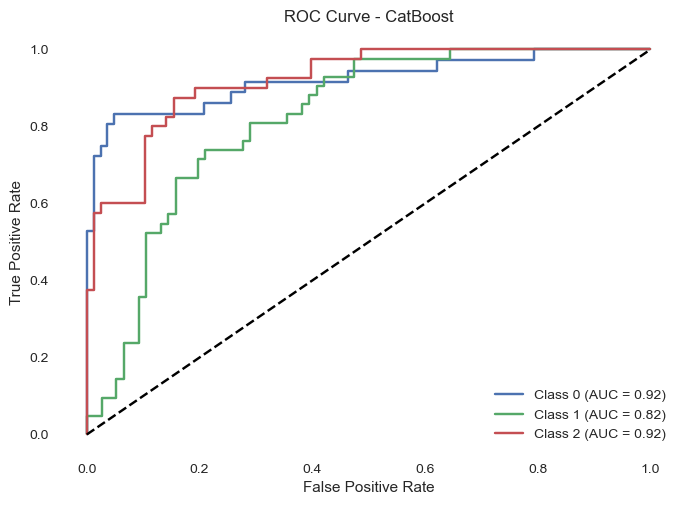

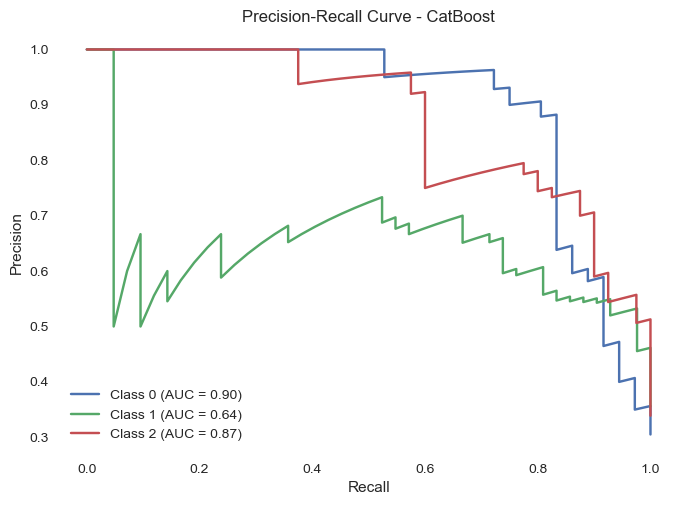

In [76]:
# Optuna Objective для CatBoost
def objective(trial):
    param = {
        "iterations": trial.suggest_int("iterations", 100, 300),
        "depth": trial.suggest_int("depth", 3, 10),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1.0, 10.0),
        "random_seed": 42,
        "verbose": 0
    }
    model = CatBoostClassifier(**param)
    scores = cross_val_score(model, X_train_scaled, y_train_enc, cv=5, scoring='f1_weighted')
    return scores.mean()

# Гиперпараметры через Optuna
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)
best_params = study.best_params
print("Best params:", best_params)

# Обучение CatBoost
start_time = time.time()
final_model = CatBoostClassifier(**best_params, random_seed=42, verbose=0)
final_model.fit(X_train_scaled, y_train_enc)
train_time = time.time() - start_time

# Предсказания
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)
y_train_proba = final_model.predict_proba(X_train_scaled)
y_test_proba = final_model.predict_proba(X_test_scaled)

# Метрики
evaluate_model(y_train_enc, y_train_pred, y_train_proba, model_name='CatBoost', stage='train', fit_time=train_time, csv_path=metrics_path)
evaluate_model(y_test_enc, y_test_pred, y_test_proba, model_name='CatBoost', stage='test', fit_time=train_time, csv_path=metrics_path)

# Confusion Matrix
cm = confusion_matrix(y_test_enc, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - CatBoost")
plt.show()

# ROC-кривая
fpr, tpr, roc_auc_dict = {}, {}, {}
n_classes = y_test_proba.shape[1]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_enc == i, y_test_proba[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

plt.figure()
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc_dict[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - CatBoost')
plt.legend()
plt.show()

# Precision-Recall кривая
precision, recall, pr_auc = {}, {}, {}
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test_enc == i, y_test_proba[:, i])
    pr_auc[i] = auc(recall[i], precision[i])

plt.figure()
for i in range(n_classes):
    plt.plot(recall[i], precision[i], label=f'Class {i} (AUC = {pr_auc[i]:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - CatBoost')
plt.legend()
plt.show()

# Permutation Importance для CatBoost

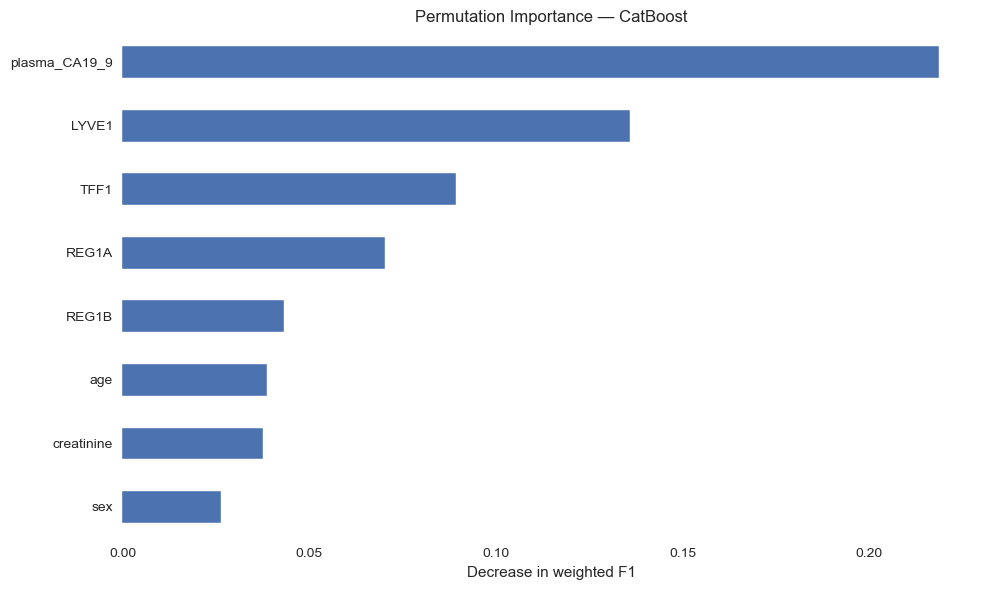

In [84]:
catboost_params = {
    'iterations': 201,
    'depth': 10,
    'learning_rate': 0.1235388039723867,
    'l2_leaf_reg': 7.6635143748557955
}

# Обучаем модель с этими параметрами
final_model = CatBoostClassifier(**catboost_params, random_seed=42, verbose=0)
final_model.fit(X_train_scaled, y_train_enc)

# Восстанавливаем имена признаков
with open(r'C:\Users\555\Desktop\BioML\NN\practice\feature_names.txt', 'r') as f:
    feature_names = [line.strip() for line in f]

X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Пермутационная важность
result = permutation_importance(
    final_model,
    X_test_df,
    y_test_enc,
    n_repeats=30,
    random_state=42,
    scoring='f1_weighted'
)

# Визуализация
importances = pd.Series(result.importances_mean, index=feature_names)

plt.figure(figsize=(10, 6))
importances.sort_values().plot(kind='barh')
plt.title("Permutation Importance — CatBoost")
plt.xlabel("Decrease in weighted F1")
plt.tight_layout()
plt.show()

# Permutation Importance для XGBoost

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\xgboost\core.py:158: UserWarning: [13:07:07] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


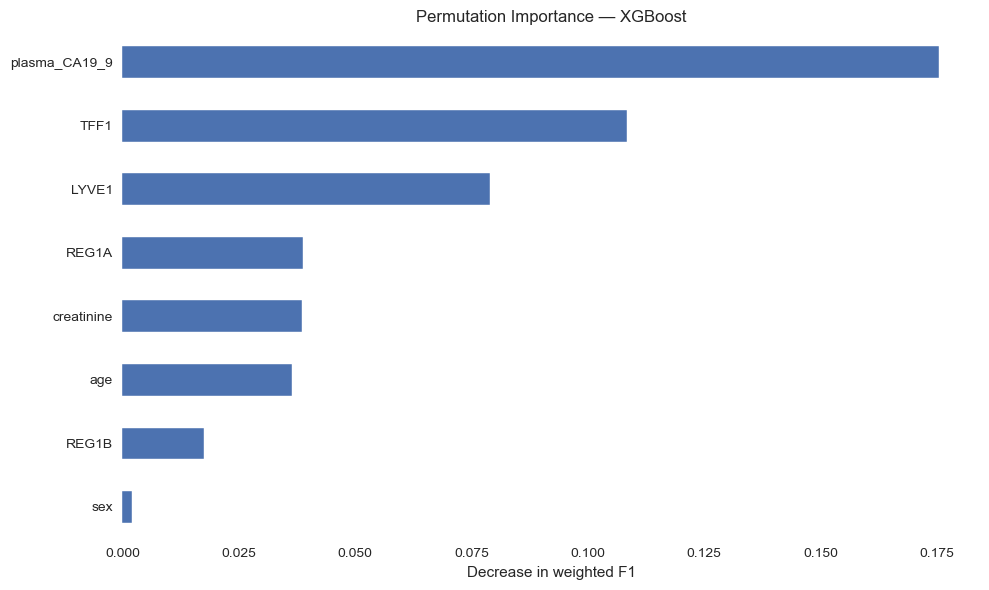

In [86]:
xgb_params = {
    'n_estimators': 118,
    'max_depth': 10,
    'learning_rate': 0.1835758554952134,
    'subsample': 0.6257340472500693,
    'colsample_bytree': 0.5821430861799988,
    'gamma': 0.07523295516554432,
    'reg_alpha': 3.9997571730033274,
    'reg_lambda': 0.9583488280945717
}

# Обучение модели
final_model = XGBClassifier(**xgb_params, use_label_encoder=False, eval_metric="mlogloss", random_state=42)
final_model.fit(X_train_scaled, y_train_enc)

# Восстанавливаем имена признаков
with open(r'C:\Users\555\Desktop\BioML\NN\practice\feature_names.txt', 'r') as f:
    feature_names = [line.strip() for line in f]

X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Пермутационная важность
result = permutation_importance(
    final_model,
    X_test_df,
    y_test_enc,
    n_repeats=30,
    random_state=42,
    scoring='f1_weighted'
)

# Визуализация
importances = pd.Series(result.importances_mean, index=feature_names)

plt.figure(figsize=(10, 6))
importances.sort_values().plot(kind='barh')
plt.title("Permutation Importance — XGBoost")
plt.xlabel("Decrease in weighted F1")
plt.tight_layout()
plt.show()

# Permutation Importance для LightGBM

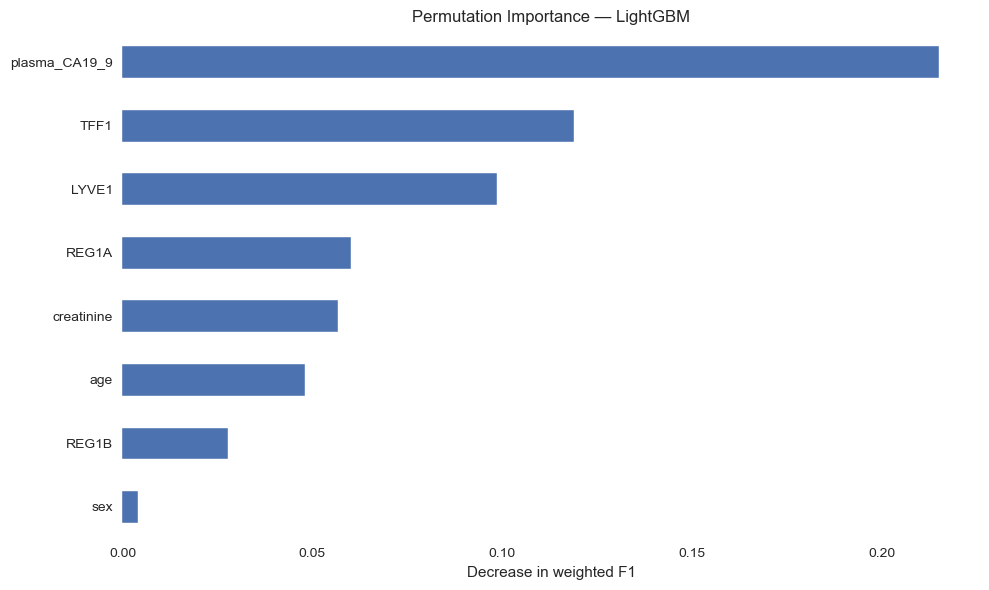

In [90]:
# Подавляем ворнинги от LightGBM
import warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)

lgbm_params = {
    'n_estimators': 118,
    'max_depth': 6,
    'learning_rate': 0.08883644669071239,
    'subsample': 0.8858917633250423,
    'colsample_bytree': 0.6194676350151797,
    'reg_alpha': 1.1220751791859715,
    'reg_lambda': 1.2117764815576089
}

# Обучение модели
final_model = LGBMClassifier(**lgbm_params, random_state=42)
final_model.fit(X_train_scaled, y_train_enc)

# Восстанавливаем имена признаков
with open(r'C:\Users\555\Desktop\BioML\NN\practice\feature_names.txt', 'r') as f:
    feature_names = [line.strip() for line in f]

X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Пермутационная важность
result = permutation_importance(
    final_model,
    X_test_df,
    y_test_enc,
    n_repeats=30,
    random_state=42,
    scoring='f1_weighted'
)

# Визуализация
importances = pd.Series(result.importances_mean, index=feature_names)

plt.figure(figsize=(10, 6))
importances.sort_values().plot(kind='barh')
plt.title("Permutation Importance — LightGBM")
plt.xlabel("Decrease in weighted F1")
plt.tight_layout()
plt.show()

# Сравнение метрик классических методов

In [95]:
df_metrics.head(50)

,model,stage,accuracy,f1_macro,precision_macro,recall_macro,roc_auc_ovr,pr_auc_macro,fit_time_sec
0,LogReg,train,0.680085,0.676338,0.673901,0.680485,0.846930,0.727465,0.002126
1,LogReg,test,0.669492,0.668960,0.670247,0.672751,0.826024,0.720154,0.002126
2,DecisionTree,train,0.809322,0.810412,0.810164,0.811882,0.944141,0.889095,0.003002
3,DecisionTree,test,0.677966,0.679691,0.677527,0.683466,0.826759,0.725480,0.003002
4,RandomForest,train,0.908898,0.910280,0.911229,0.909645,0.986851,0.977755,0.145122
5,RandomForest,test,0.745763,0.749088,0.753283,0.746429,0.897062,0.835048,0.145122
6,SVC,train,0.790254,0.790297,0.790194,0.790447,0.921739,0.834117,0.044562
7,SVC,test,0.728814,0.731462,0.732530,0.730556,0.867666,0.766190,0.044562
8,XGBoost,train,0.858051,0.859019,0.859399,0.858685,0.965196,0.937738,0.150549
9,XGBoost,test,0.737288,0.741419,0.743597,0.739815,0.889185,0.806081,0.150549


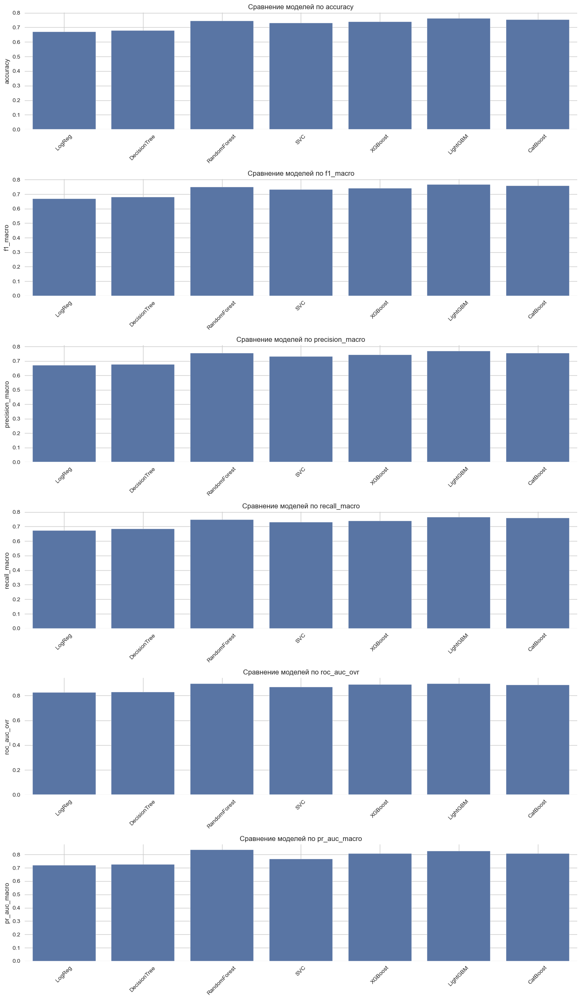

In [93]:
# Загружаем метрики
df_metrics = pd.read_csv(r'C:\Users\555\Desktop\BioML\NN\practice\metrics_all_models.csv')

# Оставляем только test stage
df_test = df_metrics[df_metrics['stage'] == 'test'].copy()

# Список метрик для сравнения
metric_columns = [
    'accuracy',
    'f1_macro',
    'precision_macro',
    'recall_macro',
    'roc_auc_ovr',
    'pr_auc_macro'
]

# Построение barplot'ов
plt.figure(figsize=(14, len(metric_columns) * 4))
for idx, metric in enumerate(metric_columns, 1):
    plt.subplot(len(metric_columns), 1, idx)
    sns.barplot(data=df_test, x='model', y=metric)
    plt.title(f'Сравнение моделей по {metric}')
    plt.ylabel(metric)
    plt.xlabel('')
    plt.xticks(rotation=45)
    plt.grid(True)

plt.tight_layout()
plt.show()

In [99]:
metrics = [
    'accuracy',
    'f1_macro',
    'precision_macro',
    'recall_macro',
    'roc_auc_ovr',
    'pr_auc_macro'
]

# Поиск лучших моделей по каждой метрике
best_models = {}
for metric in metrics:
    best_row = df_test.loc[df_test[metric].idxmax()]
    best_models[metric] = {
        'model': best_row['model'],
        'value': best_row[metric]
    }

# Вывод результатов
print("Лучшие модели по каждой метрике (на тестовой выборке):\n")
for metric, info in best_models.items():
    print(f"{metric:16} → {info['model']:12} = {info['value']:.4f}")

Лучшие модели по каждой метрике (на тестовой выборке):

accuracy         → LightGBM     = 0.7627
f1_macro         → LightGBM     = 0.7665
precision_macro  → LightGBM     = 0.7703
recall_macro     → LightGBM     = 0.7640
roc_auc_ovr      → RandomForest = 0.8971
pr_auc_macro     → RandomForest = 0.8350


Выводы по результатам сравнения моделей на тестовой выборке

LightGBM — лидер по метрикам accuracy, F1, precision_macro, recall_macro:
Занимает первое место по:

accuracy = 0.7627

f1_macro = 0.7665

precision_macro = 0.7703

recall_macro = 0.7640

Это говорит о сбалансированности модели: она хорошо классифицирует все классы и даёт устойчивые предсказания как по полноте, так и по точности.

Подходит как основная модель, если критично качество классификации по всем классам.

Random Forest — лидер по метрикам ранжирования:
Побеждает в:

roc_auc_ovr = 0.8971

pr_auc_macro = 0.8350

Это значит:

Модель лучше отделяет классы вероятностно (важно при принятии решений с порогами).

Имеет лучшее поведение при дисбалансе классов, особенно когда важен recall или Precision-Recall trade-off

Заключение:
LightGBM — самый универсальный и мощный алгоритм для большинства задач.

Random Forest — отличная альтернатива при ограниченных ресурсах или в продакшене, особенно если требуется высокая надёжность ранжирования.

Остальные модели — полезны как baseline или в ансамблях.

# Нейросети (PyTorch MLP)

In [103]:
# Общие переменные
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [105]:
# Подготовка данных
X_tensor = torch.tensor(X_train_scaled, dtype=torch.float32)
y_tensor = torch.tensor(y_train_enc, dtype=torch.long)
dataset = TensorDataset(X_tensor, y_tensor)

In [107]:
def get_random_directions(model):
    direction1 = []
    direction2 = []
    for param in model.parameters():
        if param.requires_grad:
            rand1 = torch.randn_like(param)
            rand2 = torch.randn_like(param)
            direction1.append(rand1 / torch.norm(rand1))
            direction2.append(rand2 / torch.norm(rand2))
    return direction1, direction2

def perturb_model(model, base_state_dict, dir1, dir2, alpha, beta):
    new_state = copy.deepcopy(base_state_dict)
    for (name, param), d1, d2 in zip(model.named_parameters(), dir1, dir2):
        if param.requires_grad:
            new_state[name] = base_state_dict[name] + alpha * d1 + beta * d2
    model.load_state_dict(new_state)

# Подбор функции активации через StratifiedKFold


Активация: ReLU


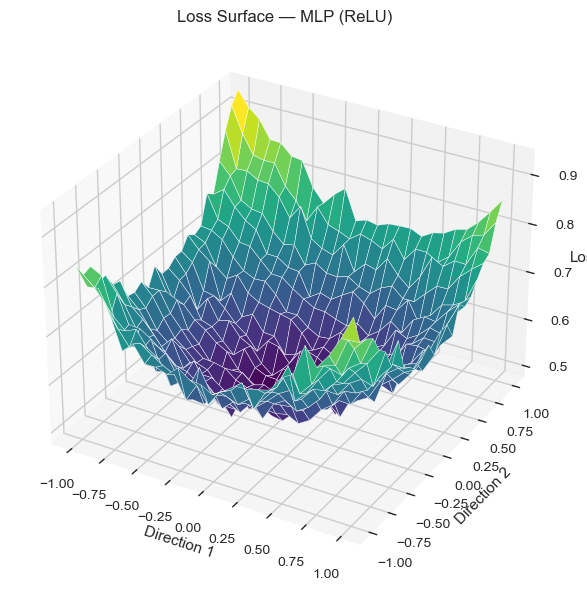


Активация: LeakyReLU


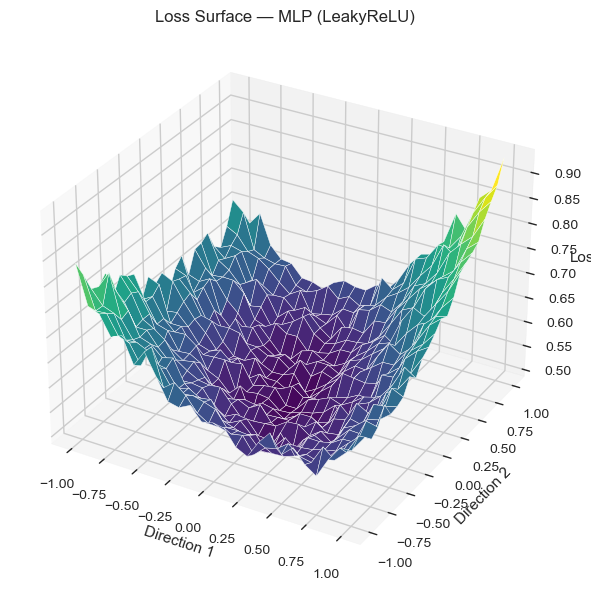


Активация: GELU


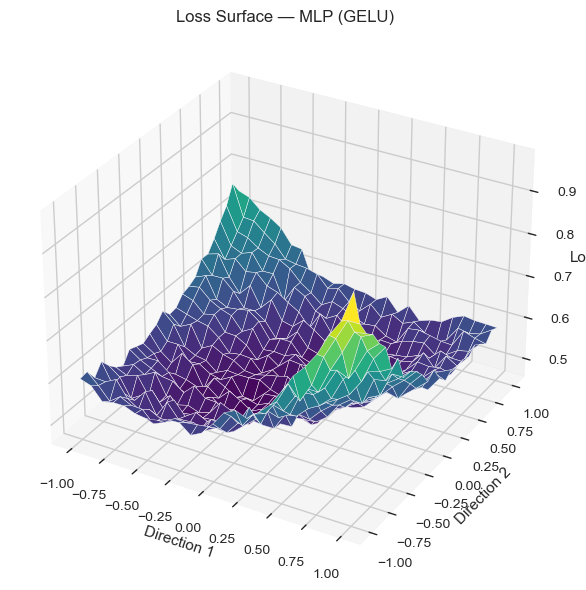

In [140]:
# Гиперпараметры
k_folds = 10  
batch_size = 32
epochs = 30
input_dim = X_tensor.shape[1]
num_classes = len(torch.unique(y_tensor))

# Словарь активаций
activations = {
    "ReLU": nn.ReLU,
    "LeakyReLU": nn.LeakyReLU,
    "GELU": nn.GELU
}

# Модель
class MLP(nn.Module):
    def __init__(self, input_dim, num_classes, activation_fn):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.BatchNorm1d(32),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(32, num_classes)
        )
    def forward(self, x):
        return self.net(x)

# Stratified KFold
skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

for act_name, act_fn in activations.items():
    print(f"\nАктивация: {act_name}")
    fold_metrics = []
    start_time = time.time()

    for fold, (train_idx, val_idx) in enumerate(skf.split(X_tensor, y_tensor)):
        model = MLP(input_dim, num_classes, act_fn).to(device)
        criterion = nn.CrossEntropyLoss()
        optimizer = optim.Adam(model.parameters(), lr=1e-3)

        train_loader = DataLoader(Subset(dataset, train_idx), batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(Subset(dataset, val_idx), batch_size=batch_size)

        # Обучение
        for epoch in range(epochs):
            model.train()
            for xb, yb in train_loader:
                xb, yb = xb.to(device), yb.to(device)
                optimizer.zero_grad()
                out = model(xb)
                loss = criterion(out, yb)
                loss.backward()
                optimizer.step()

        # Оценка fold
        model.eval()
        with torch.inference_mode():
            X_val = X_tensor[val_idx].to(device)
            y_val = y_tensor[val_idx].to(device)
            out = model(X_val)
            y_pred = torch.argmax(out, dim=1).cpu().numpy()
            y_proba = torch.softmax(out, dim=1).cpu().numpy()
            y_true = y_val.cpu().numpy()

        fold_metrics.append({
            'accuracy': accuracy_score(y_true, y_pred),
            'f1_macro': f1_score(y_true, y_pred, average='macro'),
            'precision_macro': precision_score(y_true, y_pred, average='macro'),
            'recall_macro': recall_score(y_true, y_pred, average='macro'),
            'roc_auc_ovr': roc_auc_score(y_true, y_proba, multi_class='ovr'),
            'pr_auc_macro': average_precision_score(y_true, y_proba, average='macro')
        })

    # Средние метрики
    mean_metrics = pd.DataFrame(fold_metrics).mean().to_dict()
    total_time = time.time() - start_time

    evaluate_model(
        y_true=y_true,
        y_pred=y_pred,
        y_proba=y_proba,
        model_name=f"MLP_{act_name}",
        stage='test',
        fit_time=total_time,
        num_classes=num_classes,
        csv_path=metrics_path
    )

    # Финальное обучение и сохранение
    full_model = MLP(input_dim, num_classes, act_fn).to(device)
    optimizer = optim.Adam(full_model.parameters(), lr=1e-3)
    full_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        full_model.train()
        for xb, yb in full_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            loss = criterion(full_model(xb), yb)
            loss.backward()
            optimizer.step()

    torch.save(full_model.state_dict(), f'mlp_{act_name}.pth')

    # LOSS Landscape
    base_state_dict = copy.deepcopy(full_model.state_dict())
    dir1, dir2 = get_random_directions(full_model)
    loss_surface = []

    for alpha in np.linspace(-1, 1, 25):
        row = []
        for beta in np.linspace(-1, 1, 25):
            perturb_model(full_model, base_state_dict, dir1, dir2, alpha, beta)
            with torch.inference_mode():
                out = full_model(X_tensor.to(device))
                loss = criterion(out, y_tensor.to(device)).item()
            row.append(loss)
        loss_surface.append(row)

    A, B = np.meshgrid(np.linspace(-1, 1, 25), np.linspace(-1, 1, 25))
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(A, B, np.array(loss_surface), cmap='viridis')
    ax.set_title(f"Loss Surface — MLP ({act_name})")
    ax.set_xlabel('Direction 1')
    ax.set_ylabel('Direction 2')
    ax.set_zlabel('Loss')
    plt.tight_layout()
    plt.show()

# Анализ сравнения функций потерь

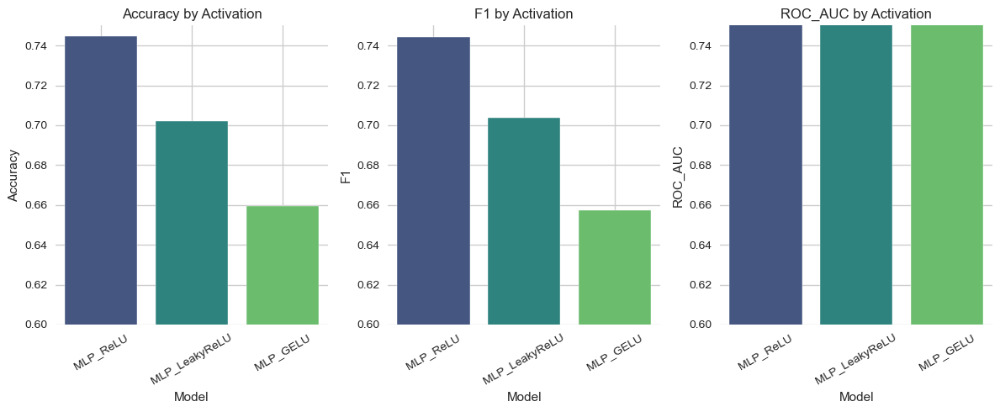

Лучшие функции активации по метрикам (на тестовой выборке):

Accuracy   →   MLP_ReLU = 0.7447
F1         →   MLP_ReLU = 0.7444
ROC_AUC    →   MLP_ReLU = 0.8580


In [144]:
# Загрузка метрик
df = pd.read_csv(metrics_path)

# Фильтрация только MLP с активациями (stage == test)
df_activation = df[(df['model'].str.startswith('MLP_')) & (df['stage'] == 'test')].copy()

# Переименование столбцов для удобства визуализации
df_activation = df_activation.rename(columns={
    'model': 'Model',
    'accuracy': 'Accuracy',
    'f1_macro': 'F1',
    'roc_auc_ovr': 'ROC_AUC'
})

# Графики по метрикам
metrics_to_plot = ['Accuracy', 'F1', 'ROC_AUC']
plt.figure(figsize=(12, 5))

for i, metric in enumerate(metrics_to_plot, 1):
    plt.subplot(1, 3, i)
    sns.barplot(data=df_activation, x='Model', y=metric, hue='Model', palette='viridis')
    plt.title(f'{metric} by Activation')
    plt.xticks(rotation=30)
    plt.ylim(0.6, 0.75)
    plt.grid(True)

plt.tight_layout()
plt.show()

# Вывод лучших функций активации по метрикам
print("Лучшие функции активации по метрикам (на тестовой выборке):\n")
for metric in metrics_to_plot:
    best_row = df_activation.loc[df_activation[metric].idxmax()]
    print(f"{metric:<10} → {best_row['Model']:>10} = {best_row[metric]:.4f}")

Вывод:
Функция активации ReLU продемонстрировала наилучшие результаты по всем ключевым метрикам:

Accuracy = 0.7447

F1 = 0.7444

ROC AUC = 0.8580

LeakyReLU показал умеренные результаты, уступая ReLU примерно на 4% по Accuracy и F1, но всё ещё удерживая стабильность на уровне.

GELU в данной конфигурации проигрывает обеим другим активациям, особенно по F1 и Accuracy, и потому не рекомендуется к использованию в текущей архитектуре..

# Подбор оптимизатора через StratifiedKFold


Оптимизатор: SGD


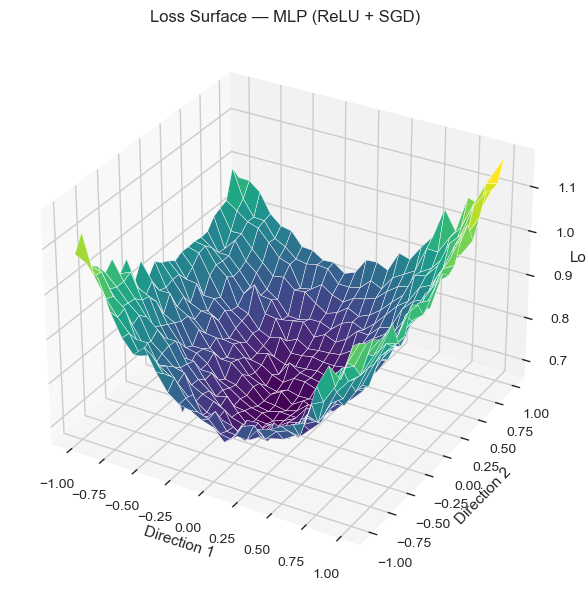


Оптимизатор: SGD_Momentum


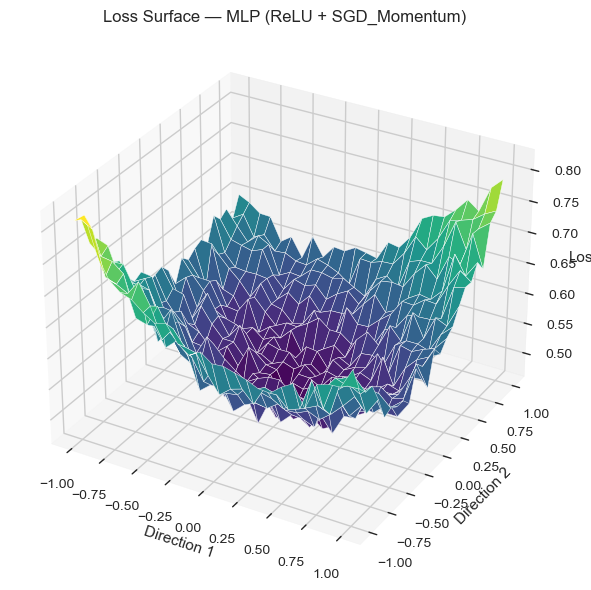


Оптимизатор: Adam


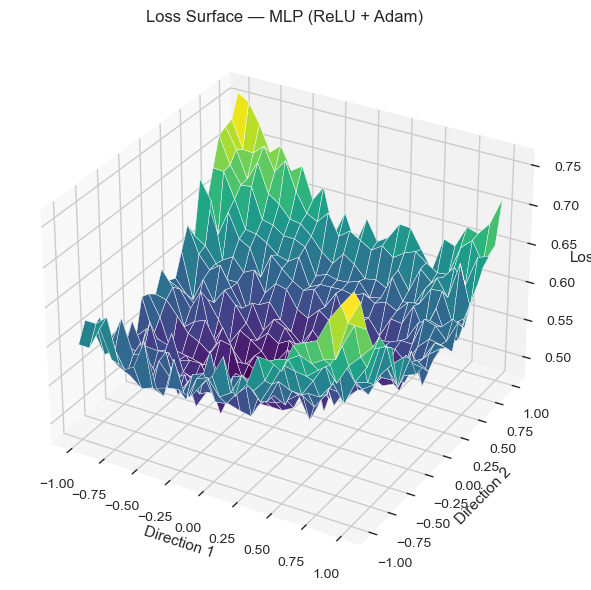


Оптимизатор: RMSprop


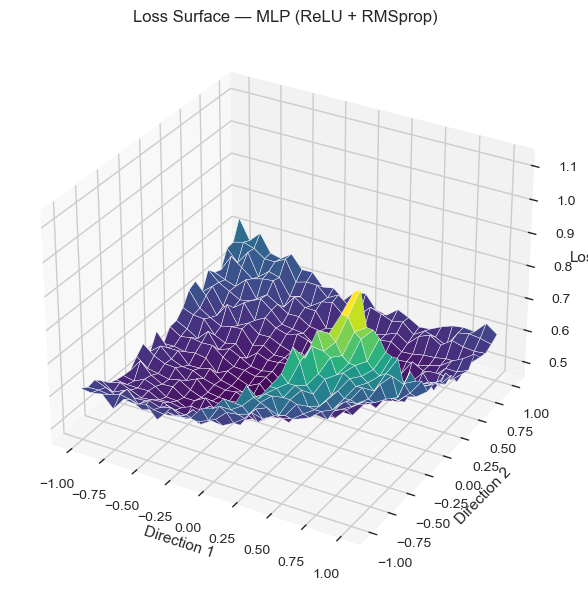


Оптимизатор: AdamW


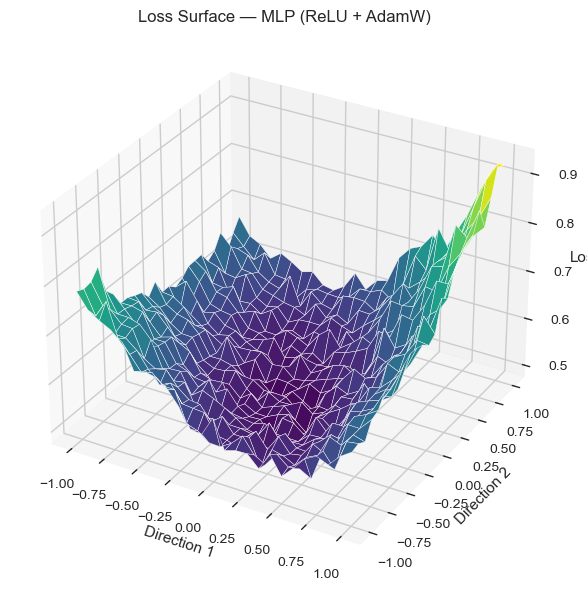

In [152]:
model_save_path = r'C:\Users\555\Desktop\BioML\NN\practice'

# Настройки
k_folds = 10
batch_size = 32
epochs = 30
activation_fn = nn.ReLU  # Фиксированная активация

# Оптимизаторы
optimizers_to_test = {
    "SGD": lambda params: optim.SGD(params, lr=1e-2),
    "SGD_Momentum": lambda params: optim.SGD(params, lr=1e-2, momentum=0.9),
    "Adam": lambda params: optim.Adam(params, lr=1e-3),
    "RMSprop": lambda params: optim.RMSprop(params, lr=1e-3),
    "AdamW": lambda params: optim.AdamW(params, lr=1e-3),
}

# Модель
class MLP(nn.Module):
    def __init__(self, input_dim, num_classes, activation_fn):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.BatchNorm1d(32),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(32, num_classes)
        )

    def forward(self, x):
        return self.net(x)

input_dim = X_tensor.shape[1]
num_classes = len(torch.unique(y_tensor))
kfold = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

for opt_name, opt_fn in optimizers_to_test.items():
    print(f"\nОптимизатор: {opt_name}")
    fold_metrics = []
    start_time = time.time()

    for fold, (train_idx, val_idx) in enumerate(kfold.split(X_tensor, y_tensor)):
        model = MLP(input_dim, num_classes, activation_fn).to(device)
        optimizer = opt_fn(model.parameters())
        criterion = nn.CrossEntropyLoss()

        train_loader = DataLoader(Subset(dataset, train_idx), batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(Subset(dataset, val_idx), batch_size=batch_size)

        for epoch in range(epochs):
            model.train()
            for xb, yb in train_loader:
                xb, yb = xb.to(device), yb.to(device)
                optimizer.zero_grad()
                preds = model(xb)
                loss = criterion(preds, yb)
                loss.backward()
                optimizer.step()

        model.eval()
        with torch.inference_mode():
            X_val = X_tensor[val_idx].to(device)
            y_val = y_tensor[val_idx].to(device)
            outputs = model(X_val)
            pred = torch.argmax(outputs, dim=1).cpu().numpy()
            proba = torch.softmax(outputs, dim=1).cpu().numpy()
            y_true = y_val.cpu().numpy()

        fold_metrics.append({
            'accuracy': accuracy_score(y_true, pred),
            'f1_macro': f1_score(y_true, pred, average='macro'),
            'precision_macro': precision_score(y_true, pred, average='macro'),
            'recall_macro': recall_score(y_true, pred, average='macro'),
            'roc_auc_ovr': roc_auc_score(y_true, proba, multi_class='ovr'),
            'pr_auc_macro': average_precision_score(y_true, proba, average='macro')
        })

    mean_metrics = pd.DataFrame(fold_metrics).mean().to_dict()
    total_time = time.time() - start_time

    evaluate_model(
        y_true=y_true,
        y_pred=pred,
        y_proba=proba,
        model_name=f"MLP_ReLU_{opt_name}",
        stage='test',
        fit_time=total_time,
        num_classes=num_classes,
        csv_path=metrics_path
    )

    # Финальное обучение на всём датасете
    final_model = MLP(input_dim, num_classes, activation_fn).to(device)
    optimizer = opt_fn(final_model.parameters())
    full_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        final_model.train()
        for xb, yb in full_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            loss = criterion(final_model(xb), yb)
            loss.backward()
            optimizer.step()

    torch.save(final_model.state_dict(), os.path.join(model_save_path, f'mlp_ReLU_{opt_name}.pth'))

    # Визуализация loss surface
    base_state_dict = copy.deepcopy(final_model.state_dict())
    dir1, dir2 = get_random_directions(final_model)
    loss_surface = []

    for alpha in np.linspace(-1, 1, 25):
        row = []
        for beta in np.linspace(-1, 1, 25):
            perturb_model(final_model, base_state_dict, dir1, dir2, alpha, beta)
            with torch.inference_mode():
                outputs = final_model(X_tensor.to(device))
                loss = criterion(outputs, y_tensor.to(device)).item()
            row.append(loss)
        loss_surface.append(row)

    A, B = np.meshgrid(np.linspace(-1, 1, 25), np.linspace(-1, 1, 25))
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(A, B, np.array(loss_surface), cmap='viridis')
    ax.set_title(f"Loss Surface — MLP (ReLU + {opt_name})")
    ax.set_xlabel('Direction 1')
    ax.set_ylabel('Direction 2')
    ax.set_zlabel('Loss')
    plt.tight_layout()
    plt.show()

# Анализ сравнения оптимизаторов

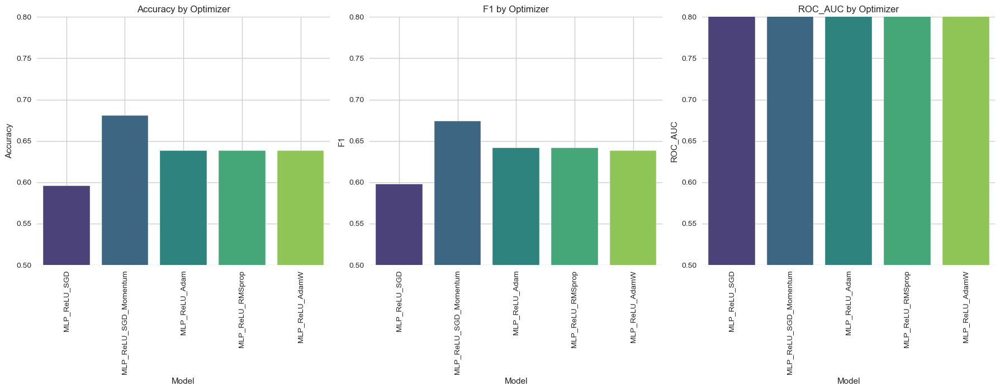

Лучшие оптимизаторы по метрикам (на тестовой выборке):

Accuracy   → MLP_ReLU_SGD_Momentum = 0.6809
F1         → MLP_ReLU_SGD_Momentum = 0.6740
ROC_AUC    →  MLP_ReLU_AdamW = 0.8414


In [180]:
# Загрузка метрик
df = pd.read_csv(metrics_path)

# Фильтрация по моделям, содержащим "MLP_ReLU_" и stage == 'test'
df_optim = df[(df['model'].str.startswith('MLP_ReLU_')) & (df['stage'] == 'test')].copy()

# Переименование столбцов
df_optim = df_optim.rename(columns={
    'model': 'Model',
    'accuracy': 'Accuracy',
    'f1_macro': 'F1',
    'roc_auc_ovr': 'ROC_AUC'
})

# Список метрик
metrics_to_plot = ['Accuracy', 'F1', 'ROC_AUC']

# Визуализация barplot'ов
plt.figure(figsize=(18, 6))

for i, metric in enumerate(metrics_to_plot, 1):
    plt.subplot(1, 3, i)
    sns.barplot(data=df_optim, x='Model', hue='Model', y=metric, palette='viridis')
    plt.title(f'{metric} by Optimizer')
    plt.xticks(rotation=90)
    plt.ylim(0.5, 0.8)
    plt.grid(True)

plt.tight_layout()
plt.subplots_adjust(bottom=0.2)
plt.show()

# Вывод лучших оптимизаторов по каждой метрике
print("Лучшие оптимизаторы по метрикам (на тестовой выборке):\n")
for metric in metrics_to_plot:
    best_row = df_optim.loc[df_optim[metric].idxmax()]
    print(f"{metric:<10} → {best_row['Model']:>15} = {best_row[metric]:.4f}")

Вывод по оптимизаторам:

Среди протестированных оптимизаторов наилучшие результаты показал SGD с momentum (SGD_Momentum), заняв первое место по метрикам Accuracy (0.6809) и F1 (0.6740). Это говорит о его способности находить устойчивое и сбалансированное решение при разумной скорости сходимости.

Несмотря на то, что AdamW показал наивысшее значение ROC AUC (0.8414), его значения точности и F1 существенно уступают (Accuracy = 0.6383, F1 = 0.6384), что указывает на переоценку редких классов или нестабильность предсказаний.

Оптимизаторы Adam, RMSprop и SGD (без momentum) продемонстрировали схожие, но менее стабильные результаты. Особенно низкие метрики наблюдаются у обычного SGD, что подтверждает важность использования momentum в задачах с более сложной функцией потерь и архитектурой.

Решение: оптимизатор SGD с momentum является наилучшим выбором для текущей модели MLP с активацией ReLU. Он обеспечивает уверенную точность и хорошую сбалансированность предсказаний по всем классам, что критично для многоклассовой классификации.

# Подбор шедулеров через StratifiedKFold


Шедулер: ConstantLR


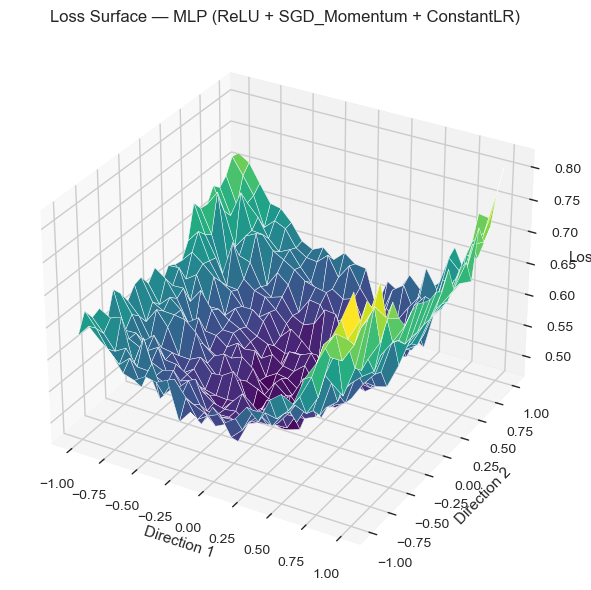


Шедулер: StepLR


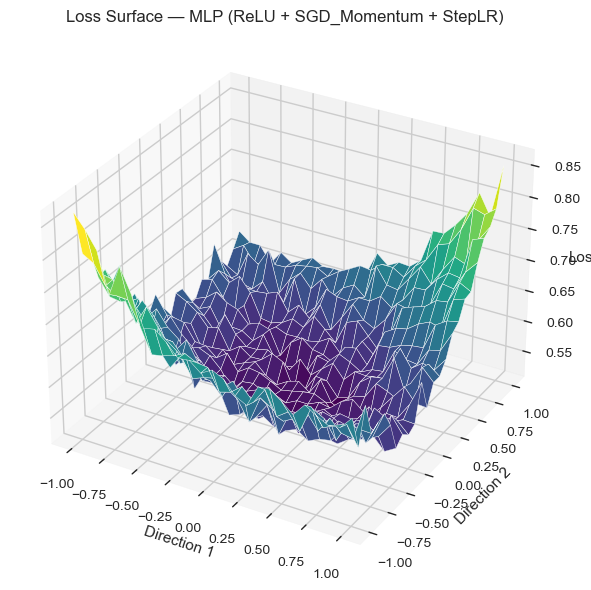


Шедулер: ExponentialLR


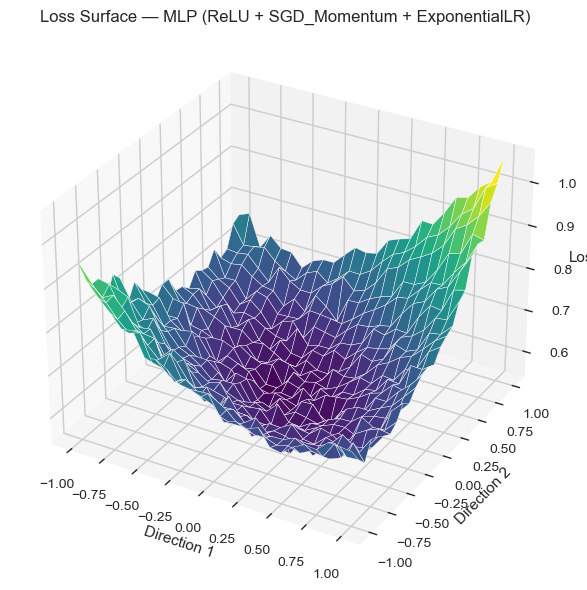


Шедулер: ReduceLROnPlateau


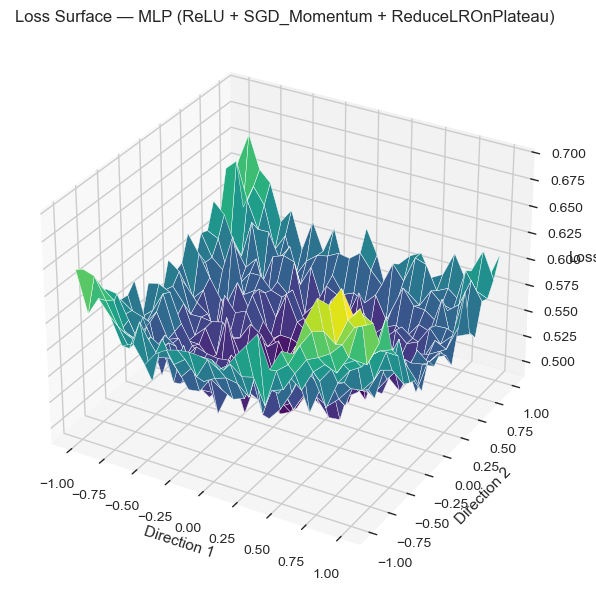


Шедулер: CosineAnnealingLR


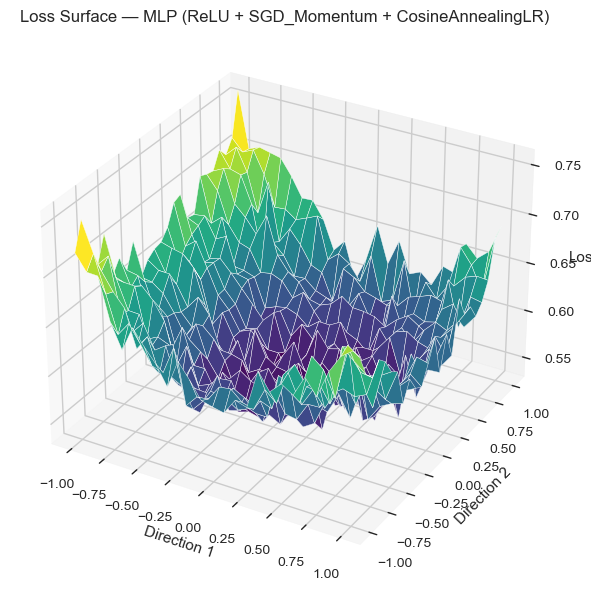

In [189]:
# Пути и настройки
model_save_path = r'C:\Users\555\Desktop\BioML\NN\practice'
k_folds = 10
batch_size = 32
epochs = 30
activation_fn = nn.ReLU
optimizer_fn = lambda params: optim.SGD(params, lr=1e-2, momentum=0.9)

# Шедулеры
schedulers_to_test = {
    "ConstantLR": lambda opt: optim.lr_scheduler.ConstantLR(opt, factor=1.0, total_iters=epochs),
    "StepLR": lambda opt: optim.lr_scheduler.StepLR(opt, step_size=10, gamma=0.5),
    "ExponentialLR": lambda opt: optim.lr_scheduler.ExponentialLR(opt, gamma=0.9),
    "ReduceLROnPlateau": lambda opt: optim.lr_scheduler.ReduceLROnPlateau(opt, mode='min', factor=0.5, patience=5),
    "CosineAnnealingLR": lambda opt: optim.lr_scheduler.CosineAnnealingLR(opt, T_max=epochs)
}

# Модель
class MLP(nn.Module):
    def __init__(self, input_dim, num_classes, activation_fn):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.BatchNorm1d(32),
            activation_fn(),
            nn.Dropout(0.2),
            nn.Linear(32, num_classes)
        )

    def forward(self, x):
        return self.net(x)

# Подготовка
input_dim = X_tensor.shape[1]
num_classes = len(torch.unique(y_tensor))
kfold = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

for sched_name, sched_fn in schedulers_to_test.items():
    print(f"\nШедулер: {sched_name}")
    fold_metrics = []
    start_time = time.time()

    for fold, (train_idx, val_idx) in enumerate(kfold.split(X_tensor, y_tensor)):
        model = MLP(input_dim, num_classes, activation_fn).to(device)
        optimizer = optimizer_fn(model.parameters())
        scheduler = sched_fn(optimizer)
        criterion = nn.CrossEntropyLoss()

        train_loader = DataLoader(Subset(dataset, train_idx), batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(Subset(dataset, val_idx), batch_size=batch_size)

        for epoch in range(epochs):
            model.train()
            for xb, yb in train_loader:
                xb, yb = xb.to(device), yb.to(device)
                optimizer.zero_grad()
                preds = model(xb)
                loss = criterion(preds, yb)
                loss.backward()
                optimizer.step()
            if isinstance(scheduler, optim.lr_scheduler.ReduceLROnPlateau):
                scheduler.step(loss)
            else:
                scheduler.step()

        model.eval()
        with torch.inference_mode():
            X_val = X_tensor[val_idx].to(device)
            y_val = y_tensor[val_idx].to(device)
            outputs = model(X_val)
            pred = torch.argmax(outputs, dim=1).cpu().numpy()
            proba = torch.softmax(outputs, dim=1).cpu().numpy()
            y_true = y_val.cpu().numpy()

        fold_metrics.append({
            'accuracy': accuracy_score(y_true, pred),
            'f1_macro': f1_score(y_true, pred, average='macro'),
            'precision_macro': precision_score(y_true, pred, average='macro'),
            'recall_macro': recall_score(y_true, pred, average='macro'),
            'roc_auc_ovr': roc_auc_score(y_true, proba, multi_class='ovr'),
            'pr_auc_macro': average_precision_score(y_true, proba, average='macro')
        })

    mean_metrics = pd.DataFrame(fold_metrics).mean().to_dict()
    total_time = time.time() - start_time

    evaluate_model(
        y_true=y_true,
        y_pred=pred,
        y_proba=proba,
        model_name=f"MLP_ReLU_SGD_Momentum_{sched_name}",
        stage='test',
        fit_time=total_time,
        num_classes=num_classes,
        csv_path=metrics_path
    )

    final_model = MLP(input_dim, num_classes, activation_fn).to(device)
    optimizer = optimizer_fn(final_model.parameters())
    scheduler = sched_fn(optimizer)
    full_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    for epoch in range(epochs):
        final_model.train()
        for xb, yb in full_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            loss = criterion(final_model(xb), yb)
            loss.backward()
            optimizer.step()
        if isinstance(scheduler, optim.lr_scheduler.ReduceLROnPlateau):
            scheduler.step(loss)
        else:
            scheduler.step()

    torch.save(final_model.state_dict(), os.path.join(model_save_path, f'mlp_ReLU_SGD_Momentum_{sched_name}.pth'))

    # Визуализация loss surface
    base_state_dict = copy.deepcopy(final_model.state_dict())
    dir1, dir2 = get_random_directions(final_model)
    loss_surface = []

    for alpha in np.linspace(-1, 1, 25):
        row = []
        for beta in np.linspace(-1, 1, 25):
            perturb_model(final_model, base_state_dict, dir1, dir2, alpha, beta)
            with torch.inference_mode():
                outputs = final_model(X_tensor.to(device))
                loss = criterion(outputs, y_tensor.to(device)).item()
            row.append(loss)
        loss_surface.append(row)

    A, B = np.meshgrid(np.linspace(-1, 1, 25), np.linspace(-1, 1, 25))
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(A, B, np.array(loss_surface), cmap='viridis')
    ax.set_title(f"Loss Surface — MLP (ReLU + SGD_Momentum + {sched_name})")
    ax.set_xlabel('Direction 1')
    ax.set_ylabel('Direction 2')
    ax.set_zlabel('Loss')
    plt.tight_layout()
    plt.show()

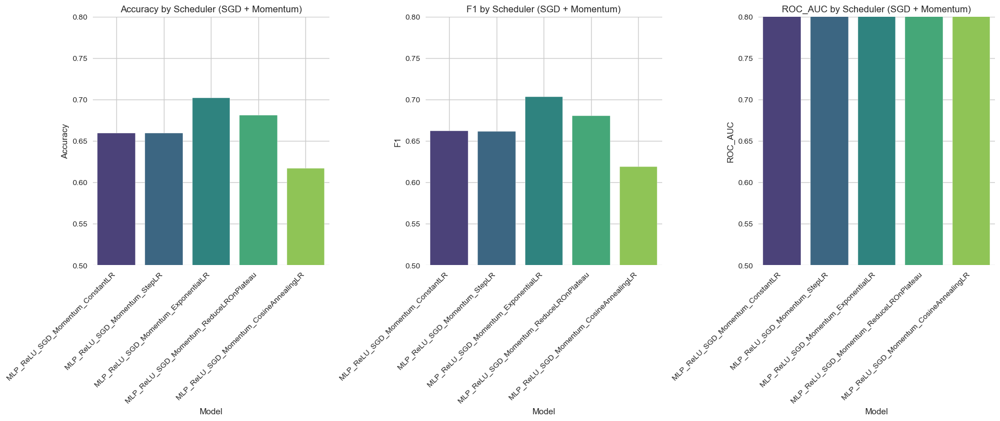

Лучшие шедулеры по метрикам (на тестовой выборке, оптимизатор: SGD + Momentum):

Accuracy   → MLP_ReLU_SGD_Momentum_ExponentialLR = 0.7021
F1         → MLP_ReLU_SGD_Momentum_ExponentialLR = 0.7036
ROC_AUC    →   MLP_ReLU_SGD_Momentum_StepLR = 0.8453


In [193]:
# Загрузка метрик
df = pd.read_csv(metrics_path)

# Фильтрация: только модели с "MLP_ReLU_SGD_Momentum_" и stage == 'test'
df_sched = df[
    df['model'].str.startswith('MLP_ReLU_SGD_Momentum_') & (df['stage'] == 'test')
].copy()

# Переименование столбцов
df_sched = df_sched.rename(columns={
    'model': 'Model',
    'accuracy': 'Accuracy',
    'f1_macro': 'F1',
    'roc_auc_ovr': 'ROC_AUC'
})

# Список метрик
metrics_to_plot = ['Accuracy', 'F1', 'ROC_AUC']

# Визуализация barplot'ов
plt.figure(figsize=(18, 6))

for i, metric in enumerate(metrics_to_plot, 1):
    plt.subplot(1, 3, i)
    sns.barplot(data=df_sched, x='Model', y=metric, hue='Model', palette='viridis')
    plt.title(f'{metric} by Scheduler (SGD + Momentum)')
    plt.xticks(rotation=45, ha='right')
    plt.ylim(0.5, 0.8)
    plt.grid(True)

plt.tight_layout()
plt.subplots_adjust(bottom=0.2)
plt.show()

# Вывод лучших шедулеров по каждой метрике
print("Лучшие шедулеры по метрикам (на тестовой выборке, оптимизатор: SGD + Momentum):\n")
for metric in metrics_to_plot:
    best_row = df_sched.loc[df_sched[metric].idxmax()]
    print(f"{metric:<10} → {best_row['Model']:>30} = {best_row[metric]:.4f}")

Сравнение шедулеров обучения (на основе оптимизатора: SGD + Momentum)
ExponentialLR
Лучшая точность (Accuracy): 0.7021

Лучшая F1-мера: 0.7036

Хороший ROC AUC: 0.8409

Поддерживает плавное экспоненциальное уменьшение скорости обучения, что способствует стабильной сходимости.

StepLR
Высший ROC AUC: 0.8453

F1 и Accuracy ниже, чем у ExponentialLR

Эффективен в ситуациях, когда требуется резкое снижение LR через интервалы, но может быть менее стабильным по F1.

ReduceLROnPlateau
Сбалансированное поведение, особенно по Precision и Recall

Уступает ExponentialLR и StepLR по F1 и ROC AUC

Может быть полезен в задачах, где важно адаптировать LR к плато по лоссу, но менее эффективен для стабильного роста метрик.

CosineAnnealingLR и ConstantLR
Показали наиболее слабые результаты по всем метрикам

Особенно CosineAnnealingLR проседает по Accuracy и F1

Вероятно, их поведение слишком колебательное или консервативное для данной задачи и конфигурации.

Вывод:
Среди протестированных шедулеров ExponentialLR обеспечивает наилучшую обобщающую способность (F1, Accuracy), тогда как StepLR может быть интересен при приоритете ROC AUC. Остальные шедулеры показали менее стабильные или слабые результаты.

# Финальный выбор модели:
Итоговый выбор компонентов модели MLP
Функция активации: ReLU
Accuracy: 0.7447

F1: 0.7444

ROC AUC: 0.8580

ReLU стабильно превосходит LeakyReLU и GELU по всем ключевым метрикам.

Особенно важно, что ReLU даёт наивысший F1, критически важный для многоклассовой классификации с дисбалансом.

Вывод: ReLU — оптимальная функция активации для данной архитектуры.

Оптимизатор: SGD с momentum
Accuracy: 0.6809

F1: 0.6740

ROC AUC: 0.8390

SGD без momentum показал худшие результаты, но включение momentum дало значительный прирост.

Adam и AdamW продемонстрировали высокие ROC AUC (до 0.841), но просели по F1 и Accuracy.

Вывод: SGD + Momentum обеспечивает наилучший баланс между точностью и полнотой по сравнению с другими методами оптимизации.

Шедулер: ExponentialLR
Accuracy: 0.7021

F1: 0.7036

ROC AUC: 0.8409

По F1 и Accuracy ExponentialLR уверенно лидирует среди всех шедулеров.

По ROC AUC его немного опережает StepLR (0.8453), но уступает по остальным метрикам.

Вывод: ExponentialLR — лучший выбор для достижения устойчивого улучшения модели, обеспечивая высокие значения F1 и Accuracy.

Финальная конфигурация модели:
MLP + ReLU + SGD (momentum) + ExponentialLR

Эта комбинация даёт оптимальный баланс между обобщающей способностью, устойчивостью к переобучению и стабильной сходимостью. 

# Финальная модель MLP (с ReLU + SGD + Momentum + ExponentialLR) с Residual-связями


Обучение: MLP + Residual + ReLU + SGD_Momentum + ExponentialLR


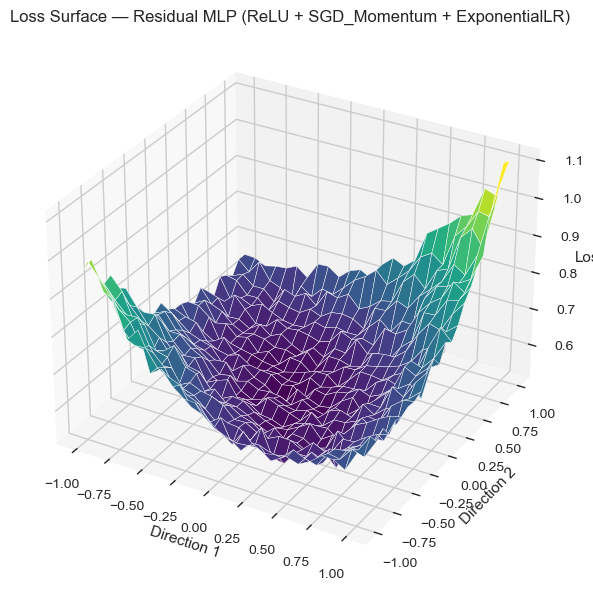

In [201]:
# === Импорты и настройки ===
model_save_path = r'C:\Users\555\Desktop\BioML\NN\practice'
k_folds = 10
batch_size = 32
epochs = 30
activation_fn = nn.ReLU
optimizer_fn = lambda params: optim.SGD(params, lr=1e-2, momentum=0.9)
scheduler_fn = lambda opt: optim.lr_scheduler.ExponentialLR(opt, gamma=0.9)

input_dim = X_tensor.shape[1]
num_classes = len(torch.unique(y_tensor))
kfold = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

# === Модель с residual-связями ===
class ResidualMLP(nn.Module):
    def __init__(self, input_dim, num_classes, activation_fn):
        super().__init__()
        self.fc1 = nn.Linear(input_dim, 128)
        self.bn1 = nn.BatchNorm1d(128)
        self.drop1 = nn.Dropout(0.2)

        self.fc2 = nn.Linear(128, 64)
        self.bn2 = nn.BatchNorm1d(64)
        self.drop2 = nn.Dropout(0.2)

        self.fc3 = nn.Linear(64, 64)  
        self.bn3 = nn.BatchNorm1d(64)
        self.drop3 = nn.Dropout(0.2)

        self.out = nn.Linear(64, num_classes)
        self.act = activation_fn()

    def forward(self, x):
        x = self.fc1(x)
        x = self.bn1(x)
        x = self.act(x)
        x = self.drop1(x)

        x = self.fc2(x)
        x = self.bn2(x)
        x = self.act(x)
        x = self.drop2(x)
        residual = x  

        x = self.fc3(x)
        x = self.bn3(x)
        x = self.act(x)
        x = self.drop3(x)

        x = x + residual  
        return self.out(x)

# === Обучение и логгинг ===
print("\nОбучение: MLP + Residual + ReLU + SGD_Momentum + ExponentialLR")
fold_metrics = []
start_time = time.time()

for fold, (train_idx, val_idx) in enumerate(kfold.split(X_tensor, y_tensor)):
    model = ResidualMLP(input_dim, num_classes, activation_fn).to(device)
    optimizer = optimizer_fn(model.parameters())
    scheduler = scheduler_fn(optimizer)
    criterion = nn.CrossEntropyLoss()

    train_loader = DataLoader(Subset(dataset, train_idx), batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(Subset(dataset, val_idx), batch_size=batch_size)

    for epoch in range(epochs):
        model.train()
        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            preds = model(xb)
            loss = criterion(preds, yb)
            loss.backward()
            optimizer.step()
        scheduler.step()

    model.eval()
    with torch.inference_mode():
        X_val = X_tensor[val_idx].to(device)
        y_val = y_tensor[val_idx].to(device)
        outputs = model(X_val)
        pred = torch.argmax(outputs, dim=1).cpu().numpy()
        proba = torch.softmax(outputs, dim=1).cpu().numpy()
        y_true = y_val.cpu().numpy()

    fold_metrics.append({
        'accuracy': accuracy_score(y_true, pred),
        'f1_macro': f1_score(y_true, pred, average='macro'),
        'precision_macro': precision_score(y_true, pred, average='macro'),
        'recall_macro': recall_score(y_true, pred, average='macro'),
        'roc_auc_ovr': roc_auc_score(y_true, proba, multi_class='ovr'),
        'pr_auc_macro': average_precision_score(y_true, proba, average='macro')
    })

mean_metrics = pd.DataFrame(fold_metrics).mean().to_dict()
total_time = time.time() - start_time

evaluate_model(
    y_true=y_true,
    y_pred=pred,
    y_proba=proba,
    model_name="MLP_Residual_ReLU_SGD_Momentum_ExponentialLR",
    stage='test',
    fit_time=total_time,
    num_classes=num_classes,
    csv_path=metrics_path
)

# === Финальное обучение ===
final_model = ResidualMLP(input_dim, num_classes, activation_fn).to(device)
optimizer = optimizer_fn(final_model.parameters())
scheduler = scheduler_fn(optimizer)
full_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

for epoch in range(epochs):
    final_model.train()
    for xb, yb in full_loader:
        xb, yb = xb.to(device), yb.to(device)
        optimizer.zero_grad()
        loss = criterion(final_model(xb), yb)
        loss.backward()
        optimizer.step()
    scheduler.step()

torch.save(final_model.state_dict(), os.path.join(model_save_path, "mlp_residual_ReLU_SGD_Momentum_ExponentialLR.pth"))

# === Loss Surface ===
base_state_dict = copy.deepcopy(final_model.state_dict())
dir1, dir2 = get_random_directions(final_model)
loss_surface = []

for alpha in np.linspace(-1, 1, 25):
    row = []
    for beta in np.linspace(-1, 1, 25):
        perturb_model(final_model, base_state_dict, dir1, dir2, alpha, beta)
        with torch.inference_mode():
            outputs = final_model(X_tensor.to(device))
            loss = criterion(outputs, y_tensor.to(device)).item()
        row.append(loss)
    loss_surface.append(row)

A, B = np.meshgrid(np.linspace(-1, 1, 25), np.linspace(-1, 1, 25))
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(A, B, np.array(loss_surface), cmap='viridis')
ax.set_title("Loss Surface — Residual MLP (ReLU + SGD_Momentum + ExponentialLR)")
ax.set_xlabel('Direction 1')
ax.set_ylabel('Direction 2')
ax.set_zlabel('Loss')
plt.tight_layout()
plt.show()

# Вывод по Residual-связям:
Добавление остаточных (residual) связей не привело к улучшению качества модели. По всем ключевым метрикам (Accuracy, F1, ROC AUC) базовая модель MLP_ReLU_SGD_Momentum_ExponentialLR показывает лучшие результаты.

Видимо, такая простая архитектура с трёхслойной структурой не нуждается в дополнительной пропускной связи, или residual-путь в текущем виде не даёт преимуществ — особенно на относительно небольшом датасете.

# TabNet и TabPFN

In [207]:
# === TabNet ===
print("\nОбучение: TabNet")
tabnet = TabNetClassifier(verbose=0)
start_time = time.time()
tabnet.fit(
    X_train=X_train_scaled, 
    y_train=y_train_enc,
    eval_set=[(X_test_scaled, y_test_enc)],
    eval_metric=['accuracy']
)
train_time = time.time() - start_time

y_test_pred = tabnet.predict(X_test_scaled)
y_test_proba = tabnet.predict_proba(X_test_scaled)

evaluate_model(
    y_true=y_test_enc,
    y_pred=y_test_pred,
    y_proba=y_test_proba,
    model_name="TabNet",
    stage="test",
    fit_time=train_time,
    num_classes=len(np.unique(y_test_enc)),
    csv_path=metrics_path
)

# === TabPFN ===
print("\nОбучение: TabPFN")
tabpfn = TabPFNClassifier(device="cuda" if torch.cuda.is_available() else "cpu")
start_time = time.time()
tabpfn.fit(X_train_scaled, y_train_enc)
train_time = time.time() - start_time

y_test_pred = tabpfn.predict(X_test_scaled)
y_test_proba = tabpfn.predict_proba(X_test_scaled)

evaluate_model(
    y_true=y_test_enc,
    y_pred=y_test_pred,
    y_proba=y_test_proba,
    model_name="TabPFN",
    stage="test",
    fit_time=train_time,
    num_classes=len(np.unique(y_test_enc)),
    csv_path=metrics_path
)


Обучение: TabNet

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_0_accuracy = 0.38136

Обучение: TabPFN


{'model': 'TabPFN',
 'stage': 'test',
 'accuracy': 0.7627118644067796,
 'f1_macro': 0.7638537271448665,
 'precision_macro': 0.7638638638638638,
 'recall_macro': 0.7674603174603175,
 'roc_auc_ovr': 0.893412817273536,
 'pr_auc_macro': 0.809598222765557,
 'fit_time_sec': 1.2846095561981201}

# Light AutoML


Обучение: LightAutoML
[16:35:23] Start automl utilizator with listed constraints:
[16:35:23] - time: 7200.00 seconds
[16:35:23] - CPU: 2 cores
[16:35:23] - memory: 16 GB

[16:35:23] If one preset completes earlier, next preset configuration will be started

[16:35:23] ==================================================
[16:35:23] Start 0 automl preset configuration:
[16:35:23] D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\lightautoml\automl\presets\tabular_configs\conf_0_sel_type_0.yml, random state: {'reader_params': {'random_state': 42}, 'nn_params': {'random_state': 42}, 'general_params': {'return_all_predictions': False}}
[16:35:23] Stdout logging level is INFO.
[16:35:23] Task: multiclass

[16:35:23] Start automl preset with listed constraints:
[16:35:23] - time: 7200.00 seconds
[16:35:23] - CPU: 2 cores
[16:35:23] - memory: 16 GB

[16:35:23] Train data shape: (472, 9)

[16:35:40] Layer 1 train process start. Time left 7183.41 secs
[16:35:40] Start fitting Lvl_0_Pipe_0

Optimization Progress: 100%|██████████| 101/101 [00:33<00:00,  3.00it/s, best_trial=21, best_value=-0.7] 

[16:36:17] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:36:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:36:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6538638409996568
[16:36:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:36:17] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:36:19] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6222428367519525
[16:36:19] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:36:19] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:48<00:00,  2.09it/s, best_trial=91, best_value=-0.658]

[16:37:07] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:37:07] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:37:11] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201283377618865
[16:37:11] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:37:11] Time left 7092.27 secs

[16:37:11] Layer 1 training completed.

[16:37:11] Layer 2 train process start. Time left 7092.27 secs
[16:37:11] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:37:13] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6354972385928435
[16:37:13] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:37:13] Time left 7090.13 secs

[16:37:13] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:37:14] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6690677467043176
[16:37:14] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:37:14] Time left 7089.18 secs

[16:37:14] Layer 2 training completed.

[16:37:14] Blending: optimization starts with equal weights. Score = -0.6403252
[16:37:14] Blending: iteration 0: score = -0.6342574, weights = [0.85644466

Optimization Progress: 100%|██████████| 101/101 [00:22<00:00,  4.46it/s, best_trial=86, best_value=-0.765]

[16:37:39] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:37:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:37:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6928860810007846
[16:37:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:37:40] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:37:41] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6262201717080558
[16:37:41] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:37:41] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:30<00:00,  3.33it/s, best_trial=43, best_value=-0.729]

[16:38:12] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:38:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:38:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6290909417604202
[16:38:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:38:13] Time left 7030.33 secs

[16:38:13] Layer 1 training completed.

[16:38:13] Layer 2 train process start. Time left 7030.32 secs
[16:38:13] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:38:15] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6426455971636804
[16:38:15] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:38:15] Time left 7028.20 secs

[16:38:15] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:38:16] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6618970828546304
[16:38:16] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:38:16] Time left 7026.98 secs

[16:38:16] Layer 2 training completed.

[16:38:16] Blending: optimization starts with equal weights. Score = -0.6395021
[16:38:16] Blending: iteration 0: score = -0.6376950, weights = [0.69443655

Optimization Progress: 100%|██████████| 101/101 [00:27<00:00,  3.70it/s, best_trial=53, best_value=-0.645]

[16:38:47] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:38:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:38:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6475920147393139
[16:38:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:38:47] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:38:48] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6112758282064329
[16:38:48] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:38:48] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:30<00:00,  3.26it/s, best_trial=92, best_value=-0.639]

[16:39:19] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:39:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:39:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6117421810370842
[16:39:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:39:21] Time left 6962.43 secs

[16:39:21] Layer 1 training completed.

[16:39:21] Layer 2 train process start. Time left 6962.43 secs
[16:39:21] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:39:24] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6136518580473702
[16:39:24] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:39:24] Time left 6959.58 secs

[16:39:24] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:39:25] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6549723351691017
[16:39:25] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:39:25] Time left 6958.13 secs

[16:39:25] Layer 2 training completed.

[16:39:25] Blending: optimization starts with equal weights. Score = -0.6170179
[16:39:25] Blending: iteration 0: score = -0.6103482, weights = [0.81279594

Optimization Progress: 100%|██████████| 101/101 [00:21<00:00,  4.62it/s, best_trial=53, best_value=-0.694]

[16:39:50] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:39:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:39:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.645101276372854
[16:39:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:39:50] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:39:52] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6151124567624252
[16:39:52] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:39:52] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:31<00:00,  3.23it/s, best_trial=3, best_value=-0.674]

[16:40:23] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:40:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:40:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6052015560846585
[16:40:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:40:25] Time left 6898.49 secs

[16:40:25] Layer 1 training completed.

[16:40:25] Layer 2 train process start. Time left 6898.48 secs
[16:40:25] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:40:27] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6271428375685872
[16:40:27] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:40:27] Time left 6896.83 secs

[16:40:27] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:40:28] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6507598637429625
[16:40:28] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:40:28] Time left 6895.62 secs

[16:40:28] Layer 2 training completed.

[16:40:28] Blending: optimization starts with equal weights. Score = -0.6304942
[16:40:28] Blending: iteration 0: score = -0.6264322, weights = [0.8571153 

Optimization Progress: 100%|██████████| 101/101 [00:29<00:00,  3.41it/s, best_trial=82, best_value=-0.61]

[16:41:00] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:41:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:41:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6458110465047423
[16:41:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:41:00] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:41:02] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6284467520913279
[16:41:02] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:41:02] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:09<00:00,  1.46it/s, best_trial=42, best_value=-0.567]

[16:42:11] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:42:11] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:42:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.617188768076999
[16:42:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:42:15] Time left 6787.96 secs

[16:42:15] Layer 1 training completed.

[16:42:15] Layer 2 train process start. Time left 6787.96 secs
[16:42:15] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:42:18] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.614738229843857
[16:42:18] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:42:18] Time left 6785.69 secs

[16:42:18] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:42:19] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6573893027478354
[16:42:19] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:42:19] Time left 6784.81 secs

[16:42:19] Layer 2 training completed.

[16:42:19] Blending: optimization starts with equal weights. Score = -0.6183881
[16:42:19] Blending: iteration 0: score = -0.6114098, weights = [0.8179956  0

Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[16:42:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396921558649575
[16:42:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:31,  1.51s/it, best_trial=0, best_value=-0.64]

[16:42:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6773479999167266
[16:42:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:58,  1.81s/it, best_trial=0, best_value=-0.64]

[16:42:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.646222932722085
[16:42:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:27,  1.50s/it, best_trial=0, best_value=-0.64]

[16:42:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6363019478363636
[16:42:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:06<02:20,  1.45s/it, best_trial=3, best_value=-0.636]

[16:42:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6462718927582302
[16:42:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:07<02:09,  1.35s/it, best_trial=3, best_value=-0.636]

[16:42:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.678787006901732
[16:42:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:48,  1.78s/it, best_trial=3, best_value=-0.636]

[16:42:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6405631812569146
[16:42:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:11<02:32,  1.62s/it, best_trial=3, best_value=-0.636]

[16:42:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6723884615389291
[16:42:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:12<02:24,  1.55s/it, best_trial=3, best_value=-0.636]

[16:42:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6606037817766808
[16:42:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:14<02:43,  1.78s/it, best_trial=3, best_value=-0.636]

[16:42:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:37] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6460867965378941
[16:42:37] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:16<02:26,  1.61s/it, best_trial=3, best_value=-0.636]

[16:42:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406282810033096
[16:42:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:17<02:15,  1.50s/it, best_trial=3, best_value=-0.636]

[16:42:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403996087015495
[16:42:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:18<02:15,  1.52s/it, best_trial=3, best_value=-0.636]

[16:42:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6418853011333754
[16:42:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:20<02:09,  1.47s/it, best_trial=3, best_value=-0.636]

[16:42:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6393657623377527
[16:42:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:21<02:07,  1.47s/it, best_trial=3, best_value=-0.636]

[16:42:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6506816468932309
[16:42:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:23<02:06,  1.47s/it, best_trial=3, best_value=-0.636]

[16:42:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406256849674222
[16:42:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:24<02:02,  1.44s/it, best_trial=3, best_value=-0.636]

[16:42:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6414217357887609
[16:42:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:25<01:59,  1.42s/it, best_trial=3, best_value=-0.636]

[16:42:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6417675102041185
[16:42:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:27<01:56,  1.41s/it, best_trial=3, best_value=-0.636]

[16:42:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6381277153804338
[16:42:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:28<01:56,  1.42s/it, best_trial=3, best_value=-0.636]

[16:42:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396187355664474
[16:42:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:30<01:52,  1.39s/it, best_trial=3, best_value=-0.636]

[16:42:52] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6393444163354199
[16:42:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:31<01:46,  1.34s/it, best_trial=3, best_value=-0.636]

[16:42:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6382522858168642
[16:42:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:32<01:43,  1.31s/it, best_trial=3, best_value=-0.636]

[16:42:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6392303469636565
[16:42:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:33<01:43,  1.32s/it, best_trial=3, best_value=-0.636]

[16:42:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6393198614829438
[16:42:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:35<01:41,  1.32s/it, best_trial=3, best_value=-0.636]

[16:42:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640672161572158
[16:42:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:36<01:36,  1.27s/it, best_trial=3, best_value=-0.636]

[16:42:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:42:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411766963493982
[16:42:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:37<01:40,  1.34s/it, best_trial=3, best_value=-0.636]

[16:42:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640134247415879
[16:43:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:39<01:40,  1.35s/it, best_trial=3, best_value=-0.636]

[16:43:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385867681983043
[16:43:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:40<01:37,  1.34s/it, best_trial=3, best_value=-0.636]

[16:43:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.641035829660573
[16:43:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:41<01:39,  1.38s/it, best_trial=3, best_value=-0.636]

[16:43:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6393478752685134
[16:43:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:43<01:40,  1.41s/it, best_trial=3, best_value=-0.636]

[16:43:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438455177007675
[16:43:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:44<01:39,  1.42s/it, best_trial=3, best_value=-0.636]

[16:43:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6381402376265936
[16:43:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:46<01:36,  1.40s/it, best_trial=3, best_value=-0.636]

[16:43:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6426458620939334
[16:43:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [00:47<01:35,  1.41s/it, best_trial=3, best_value=-0.636]

[16:43:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:11] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385727237877885
[16:43:11] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [00:49<01:33,  1.40s/it, best_trial=3, best_value=-0.636]

[16:43:11] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396012941100492
[16:43:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [00:50<01:31,  1.39s/it, best_trial=3, best_value=-0.636]

[16:43:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6477972430063349
[16:43:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [00:51<01:26,  1.33s/it, best_trial=3, best_value=-0.636]

[16:43:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6443632361562119
[16:43:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [00:53<01:29,  1.40s/it, best_trial=3, best_value=-0.636]

[16:43:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6511917604177015
[16:43:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [00:54<01:23,  1.32s/it, best_trial=3, best_value=-0.636]

[16:43:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396922621946538
[16:43:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [00:55<01:19,  1.29s/it, best_trial=3, best_value=-0.636]

[16:43:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6434068826724616
[16:43:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [00:56<01:17,  1.27s/it, best_trial=3, best_value=-0.636]

[16:43:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6350091670710813
[16:43:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [00:58<01:20,  1.33s/it, best_trial=40, best_value=-0.635]

[16:43:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.637138038972794
[16:43:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [00:59<01:20,  1.36s/it, best_trial=40, best_value=-0.635]

[16:43:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6373735125186942
[16:43:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:01<01:18,  1.36s/it, best_trial=40, best_value=-0.635]

[16:43:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6486544900304883
[16:43:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:03<01:33,  1.64s/it, best_trial=40, best_value=-0.635]

[16:43:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403739824460297
[16:43:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:04<01:28,  1.58s/it, best_trial=40, best_value=-0.635]

[16:43:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383146640008821
[16:43:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:06<01:24,  1.54s/it, best_trial=40, best_value=-0.635]

[16:43:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406997226581079
[16:43:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:07<01:21,  1.51s/it, best_trial=40, best_value=-0.635]

[16:43:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403687660368239
[16:43:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:09<01:18,  1.49s/it, best_trial=40, best_value=-0.635]

[16:43:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385181650124262
[16:43:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:10<01:18,  1.51s/it, best_trial=40, best_value=-0.635]

[16:43:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403269002968328
[16:43:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:12<01:14,  1.46s/it, best_trial=40, best_value=-0.635]

[16:43:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6395159234121335
[16:43:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:13<01:12,  1.44s/it, best_trial=40, best_value=-0.635]

[16:43:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.639075113156903
[16:43:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:14<01:09,  1.42s/it, best_trial=40, best_value=-0.635]

[16:43:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6382473736699378
[16:43:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:16<01:08,  1.44s/it, best_trial=40, best_value=-0.635]

[16:43:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6399528158728596
[16:43:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:17<01:05,  1.39s/it, best_trial=40, best_value=-0.635]

[16:43:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6413252808076358
[16:43:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:19<01:05,  1.43s/it, best_trial=40, best_value=-0.635]

[16:43:41] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.7166878694791732
[16:43:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:22<01:29,  1.98s/it, best_trial=40, best_value=-0.635]

[16:43:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6840161565296645
[16:43:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:23<01:21,  1.85s/it, best_trial=40, best_value=-0.635]

[16:43:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.636713204385786
[16:43:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:25<01:14,  1.73s/it, best_trial=40, best_value=-0.635]

[16:43:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6394735812393427
[16:43:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:26<01:09,  1.64s/it, best_trial=40, best_value=-0.635]

[16:43:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6414152094622465
[16:43:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:28<01:05,  1.61s/it, best_trial=40, best_value=-0.635]

[16:43:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403571865706202
[16:43:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:29<01:01,  1.54s/it, best_trial=40, best_value=-0.635]

[16:43:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:52] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6412365558946967
[16:43:52] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:31<00:58,  1.50s/it, best_trial=40, best_value=-0.635]

[16:43:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6410194237109128
[16:43:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:32<00:55,  1.46s/it, best_trial=40, best_value=-0.635]

[16:43:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6379094227577423
[16:43:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:33<00:53,  1.43s/it, best_trial=40, best_value=-0.635]

[16:43:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6474535140061349
[16:43:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [01:35<00:50,  1.39s/it, best_trial=40, best_value=-0.635]

[16:43:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6373693506559336
[16:43:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [01:36<00:49,  1.42s/it, best_trial=40, best_value=-0.635]

[16:43:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:43:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383972905801522
[16:43:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [01:38<00:48,  1.43s/it, best_trial=40, best_value=-0.635]

[16:44:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6387134788480582
[16:44:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [01:39<00:47,  1.43s/it, best_trial=40, best_value=-0.635]

[16:44:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6374239018837461
[16:44:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [01:40<00:45,  1.43s/it, best_trial=40, best_value=-0.635]

[16:44:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6378563644824319
[16:44:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [01:42<00:43,  1.41s/it, best_trial=40, best_value=-0.635]

[16:44:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6395159248750594
[16:44:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [01:43<00:41,  1.39s/it, best_trial=40, best_value=-0.635]

[16:44:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6375605954326727
[16:44:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [01:44<00:40,  1.38s/it, best_trial=40, best_value=-0.635]

[16:44:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.67815132603386
[16:44:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [01:46<00:39,  1.41s/it, best_trial=40, best_value=-0.635]

[16:44:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6756513569343037
[16:44:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [01:47<00:38,  1.41s/it, best_trial=40, best_value=-0.635]

[16:44:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:11] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383652681042544
[16:44:11] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [01:49<00:36,  1.40s/it, best_trial=40, best_value=-0.635]

[16:44:11] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6391527552608183
[16:44:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [01:50<00:36,  1.46s/it, best_trial=40, best_value=-0.635]

[16:44:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6369149171186848
[16:44:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [01:52<00:33,  1.42s/it, best_trial=40, best_value=-0.635]

[16:44:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396477663309352
[16:44:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [01:53<00:31,  1.38s/it, best_trial=40, best_value=-0.635]

[16:44:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383640572257081
[16:44:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [01:54<00:29,  1.36s/it, best_trial=40, best_value=-0.635]

[16:44:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6389974210867175
[16:44:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [01:56<00:28,  1.35s/it, best_trial=40, best_value=-0.635]

[16:44:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383884155986451
[16:44:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [01:57<00:27,  1.38s/it, best_trial=40, best_value=-0.635]

[16:44:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6365971867744277
[16:44:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [01:58<00:25,  1.34s/it, best_trial=40, best_value=-0.635]

[16:44:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6398250702558049
[16:44:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [02:00<00:23,  1.32s/it, best_trial=40, best_value=-0.635]

[16:44:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6361216961040989
[16:44:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:01<00:22,  1.31s/it, best_trial=40, best_value=-0.635]

[16:44:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6373912418995713
[16:44:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:02<00:21,  1.32s/it, best_trial=40, best_value=-0.635]

[16:44:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6360056454432274
[16:44:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:04<00:19,  1.32s/it, best_trial=40, best_value=-0.635]

[16:44:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6382779905248588
[16:44:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:05<00:18,  1.32s/it, best_trial=40, best_value=-0.635]

[16:44:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6386978065150631
[16:44:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:06<00:17,  1.34s/it, best_trial=40, best_value=-0.635]

[16:44:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6391960462476036
[16:44:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:08<00:16,  1.35s/it, best_trial=40, best_value=-0.635]

[16:44:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6404651736662815
[16:44:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:09<00:14,  1.36s/it, best_trial=40, best_value=-0.635]

[16:44:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6371546587429566
[16:44:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:10<00:13,  1.38s/it, best_trial=40, best_value=-0.635]

[16:44:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6399126261082334
[16:44:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:12<00:12,  1.38s/it, best_trial=40, best_value=-0.635]

[16:44:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6362134657481385
[16:44:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:13<00:10,  1.35s/it, best_trial=40, best_value=-0.635]

[16:44:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6347950899001995
[16:44:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:14<00:09,  1.34s/it, best_trial=93, best_value=-0.635]

[16:44:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6387722563096392
[16:44:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [02:16<00:07,  1.33s/it, best_trial=93, best_value=-0.635]

[16:44:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6361251719430387
[16:44:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [02:17<00:06,  1.32s/it, best_trial=93, best_value=-0.635]

[16:44:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6365583709149102
[16:44:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [02:18<00:05,  1.31s/it, best_trial=93, best_value=-0.635]

[16:44:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6387444814655053
[16:44:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [02:20<00:03,  1.31s/it, best_trial=93, best_value=-0.635]

[16:44:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6373850060280132
[16:44:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [02:21<00:02,  1.31s/it, best_trial=93, best_value=-0.635]

[16:44:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6390924878990921
[16:44:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [02:22<00:01,  1.29s/it, best_trial=93, best_value=-0.635]

[16:44:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:44:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6405332737900044
[16:44:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [02:24<00:00,  1.43s/it, best_trial=93, best_value=-0.635]

[16:44:45] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:44:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:44:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6284857623056412
[16:44:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:44:46] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:44:47] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.629805643086507
[16:44:47] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:44:47] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[16:44:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6314359467475299
[16:44:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:48,  1.68s/it, best_trial=0, best_value=-0.631]

[16:44:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6298181609066899
[16:44:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:29,  1.51s/it, best_trial=1, best_value=-0.63] 

[16:44:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6399807976343751
[16:44:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:09,  1.32s/it, best_trial=1, best_value=-0.63]

[16:44:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229852982273428
[16:44:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:06<02:31,  1.56s/it, best_trial=3, best_value=-0.623]

[16:44:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268987279627442
[16:44:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:08<03:05,  1.93s/it, best_trial=3, best_value=-0.623]

[16:44:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6366506109521708
[16:44:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:35,  1.63s/it, best_trial=3, best_value=-0.623]

[16:44:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:44:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6298177724461117
[16:44:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:11<02:27,  1.56s/it, best_trial=3, best_value=-0.623]

[16:44:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6366506875380884
[16:45:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:12<02:11,  1.41s/it, best_trial=3, best_value=-0.623]

[16:45:00] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6311690808250526
[16:45:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:11,  1.43s/it, best_trial=3, best_value=-0.623]

[16:45:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6284022405798805
[16:45:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:15<02:09,  1.43s/it, best_trial=3, best_value=-0.623]

[16:45:02] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:05] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268987262953343
[16:45:05] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:17<02:40,  1.79s/it, best_trial=3, best_value=-0.623]

[16:45:05] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:08] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268987263659025
[16:45:08] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:20<03:00,  2.02s/it, best_trial=3, best_value=-0.623]

[16:45:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229852988161814
[16:45:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:22<02:55,  1.99s/it, best_trial=3, best_value=-0.623]

[16:45:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:11] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229187440660828
[16:45:11] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:24<02:51,  1.97s/it, best_trial=13, best_value=-0.623]

[16:45:11] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.623501128476015
[16:45:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:26<02:47,  1.94s/it, best_trial=13, best_value=-0.623]

[16:45:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.62586768821171
[16:45:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:28<02:46,  1.96s/it, best_trial=13, best_value=-0.623]

[16:45:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229765735997095
[16:45:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:29<02:43,  1.95s/it, best_trial=13, best_value=-0.623]

[16:45:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6332045787409769
[16:45:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:31<02:21,  1.71s/it, best_trial=13, best_value=-0.623]

[16:45:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229686268193322
[16:45:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:33<02:25,  1.78s/it, best_trial=13, best_value=-0.623]

[16:45:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6302463575954677
[16:45:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:34<02:10,  1.61s/it, best_trial=13, best_value=-0.623]

[16:45:22] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6257092801118157
[16:45:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:36<02:31,  1.90s/it, best_trial=13, best_value=-0.623]

[16:45:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229745347511537
[16:45:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:38<02:30,  1.90s/it, best_trial=13, best_value=-0.623]

[16:45:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237623601826373
[16:45:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:40<02:26,  1.87s/it, best_trial=13, best_value=-0.623]

[16:45:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229786825308744
[16:45:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:42<02:25,  1.88s/it, best_trial=13, best_value=-0.623]

[16:45:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6260241229122349
[16:45:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:43<02:13,  1.75s/it, best_trial=13, best_value=-0.623]

[16:45:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268987262695047
[16:45:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:46<02:31,  2.02s/it, best_trial=13, best_value=-0.623]

[16:45:34] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229459125674679
[16:45:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:48<02:29,  2.02s/it, best_trial=13, best_value=-0.623]

[16:45:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6276134906533104
[16:45:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:49<02:14,  1.84s/it, best_trial=13, best_value=-0.623]

[16:45:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229353171647403
[16:45:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:51<02:14,  1.86s/it, best_trial=13, best_value=-0.623]

[16:45:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6324342319340458
[16:45:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:54<02:33,  2.16s/it, best_trial=13, best_value=-0.623]

[16:45:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6243016200664148
[16:45:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:56<02:30,  2.14s/it, best_trial=13, best_value=-0.623]

[16:45:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6239846817156971
[16:45:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:58<02:22,  2.06s/it, best_trial=13, best_value=-0.623]

[16:45:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229502103120109
[16:45:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [01:00<02:16,  2.01s/it, best_trial=13, best_value=-0.623]

[16:45:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229240927028439
[16:45:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [01:02<02:13,  1.99s/it, best_trial=13, best_value=-0.623]

[16:45:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.629816881812629
[16:45:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [01:04<02:00,  1.82s/it, best_trial=13, best_value=-0.623]

[16:45:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6245730555501791
[16:45:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [01:06<02:16,  2.10s/it, best_trial=13, best_value=-0.623]

[16:45:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229334725115352
[16:45:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [01:08<02:11,  2.05s/it, best_trial=13, best_value=-0.623]

[16:45:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:45:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229852791853366
[16:45:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [01:10<02:06,  2.01s/it, best_trial=13, best_value=-0.623]

[16:45:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6290899080342074
[16:46:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [01:13<02:16,  2.20s/it, best_trial=13, best_value=-0.623]

[16:46:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6298180525111792
[16:46:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [01:14<01:58,  1.95s/it, best_trial=13, best_value=-0.623]

[16:46:02] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229825863120894
[16:46:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [01:16<01:56,  1.94s/it, best_trial=13, best_value=-0.623]

[16:46:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:06] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229438974134209
[16:46:06] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [01:18<01:54,  1.93s/it, best_trial=13, best_value=-0.623]

[16:46:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:08] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229299747223379
[16:46:08] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:20<01:52,  1.94s/it, best_trial=13, best_value=-0.623]

[16:46:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6260414180154423
[16:46:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:21<01:40,  1.76s/it, best_trial=13, best_value=-0.623]

[16:46:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:11] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237650702030616
[16:46:11] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:23<01:40,  1.79s/it, best_trial=13, best_value=-0.623]

[16:46:11] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268987377006174
[16:46:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:26<01:51,  2.03s/it, best_trial=13, best_value=-0.623]

[16:46:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229190501683968
[16:46:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:28<01:48,  2.00s/it, best_trial=13, best_value=-0.623]

[16:46:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6289892325557681
[16:46:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:29<01:36,  1.81s/it, best_trial=13, best_value=-0.623]

[16:46:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6276952372355797
[16:46:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:31<01:35,  1.84s/it, best_trial=13, best_value=-0.623]

[16:46:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268987959677405
[16:46:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:34<01:45,  2.07s/it, best_trial=13, best_value=-0.623]

[16:46:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229678802054094
[16:46:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:36<01:42,  2.05s/it, best_trial=13, best_value=-0.623]

[16:46:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229178813568774
[16:46:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:37<01:38,  2.02s/it, best_trial=51, best_value=-0.623]

[16:46:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:27] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229094232063146
[16:46:27] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:39<01:35,  1.99s/it, best_trial=52, best_value=-0.623]

[16:46:27] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:29] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6231609688876162
[16:46:29] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:41<01:33,  1.99s/it, best_trial=52, best_value=-0.623]

[16:46:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6365732483871205
[16:46:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:42<01:18,  1.70s/it, best_trial=52, best_value=-0.623]

[16:46:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6231623186776423
[16:46:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:44<01:20,  1.78s/it, best_trial=52, best_value=-0.623]

[16:46:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229639051207216
[16:46:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:46<01:20,  1.82s/it, best_trial=52, best_value=-0.623]

[16:46:34] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6298151008243087
[16:46:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:48<01:12,  1.70s/it, best_trial=52, best_value=-0.623]

[16:46:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6302235636890968
[16:46:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:49<01:05,  1.55s/it, best_trial=52, best_value=-0.623]

[16:46:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:40] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6245735037710689
[16:46:40] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:52<01:19,  1.93s/it, best_trial=52, best_value=-0.623]

[16:46:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229836694829172
[16:46:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:54<01:17,  1.93s/it, best_trial=52, best_value=-0.623]

[16:46:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229280578201698
[16:46:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:56<01:15,  1.93s/it, best_trial=52, best_value=-0.623]

[16:46:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229568153675967
[16:46:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:58<01:13,  1.93s/it, best_trial=52, best_value=-0.623]

[16:46:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:47] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229057914799091
[16:46:47] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:59<01:11,  1.92s/it, best_trial=63, best_value=-0.623]

[16:46:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229741853041293
[16:46:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [02:01<01:09,  1.93s/it, best_trial=63, best_value=-0.623]

[16:46:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237656568993676
[16:46:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [02:03<01:06,  1.90s/it, best_trial=63, best_value=-0.623]

[16:46:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229130839392505
[16:46:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [02:05<01:05,  1.92s/it, best_trial=63, best_value=-0.623]

[16:46:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:55] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.627278245285888
[16:46:55] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [02:07<01:02,  1.90s/it, best_trial=63, best_value=-0.623]

[16:46:55] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268988242181588
[16:46:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [02:10<01:07,  2.11s/it, best_trial=63, best_value=-0.623]

[16:46:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:46:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6282774155282499
[16:46:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [02:11<00:58,  1.87s/it, best_trial=63, best_value=-0.623]

[16:46:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229615684845885
[16:47:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [02:13<00:56,  1.89s/it, best_trial=63, best_value=-0.623]

[16:47:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622907555712411
[16:47:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [02:15<00:55,  1.90s/it, best_trial=63, best_value=-0.623]

[16:47:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6235010666506421
[16:47:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [02:17<00:52,  1.89s/it, best_trial=63, best_value=-0.623]

[16:47:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:06] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229721926239671
[16:47:06] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [02:19<00:51,  1.90s/it, best_trial=63, best_value=-0.623]

[16:47:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:08] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622911001628268
[16:47:08] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [02:20<00:49,  1.90s/it, best_trial=63, best_value=-0.623]

[16:47:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6263522640445051
[16:47:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [02:22<00:48,  1.92s/it, best_trial=63, best_value=-0.623]

[16:47:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.62398435094781
[16:47:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [02:24<00:46,  1.93s/it, best_trial=63, best_value=-0.623]

[16:47:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6260911440397136
[16:47:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [02:27<00:49,  2.15s/it, best_trial=63, best_value=-0.623]

[16:47:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229588130633535
[16:47:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [02:29<00:45,  2.08s/it, best_trial=63, best_value=-0.623]

[16:47:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6284299097281448
[16:47:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [02:30<00:39,  1.88s/it, best_trial=63, best_value=-0.623]

[16:47:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6234971567333994
[16:47:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [02:32<00:37,  1.89s/it, best_trial=63, best_value=-0.623]

[16:47:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229235511044133
[16:47:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [02:34<00:36,  1.91s/it, best_trial=63, best_value=-0.623]

[16:47:22] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.62291766006558
[16:47:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [02:36<00:34,  1.92s/it, best_trial=63, best_value=-0.623]

[16:47:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229108562392924
[16:47:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:38<00:32,  1.93s/it, best_trial=63, best_value=-0.623]

[16:47:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229429056126017
[16:47:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:40<00:31,  1.95s/it, best_trial=63, best_value=-0.623]

[16:47:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237601497703362
[16:47:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:42<00:28,  1.92s/it, best_trial=63, best_value=-0.623]

[16:47:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229579932857225
[16:47:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:44<00:27,  1.93s/it, best_trial=63, best_value=-0.623]

[16:47:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6272524099207879
[16:47:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:46<00:24,  1.91s/it, best_trial=63, best_value=-0.623]

[16:47:34] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6299991366864913
[16:47:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:47<00:21,  1.77s/it, best_trial=63, best_value=-0.623]

[16:47:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622971825283066
[16:47:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:49<00:20,  1.86s/it, best_trial=63, best_value=-0.623]

[16:47:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6320116850839572
[16:47:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:53<00:23,  2.33s/it, best_trial=63, best_value=-0.623]

[16:47:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229159359041052
[16:47:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:55<00:19,  2.22s/it, best_trial=63, best_value=-0.623]

[16:47:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6234956021416372
[16:47:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:57<00:16,  2.12s/it, best_trial=63, best_value=-0.623]

[16:47:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229481523219855
[16:47:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:59<00:14,  2.06s/it, best_trial=63, best_value=-0.623]

[16:47:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229149282988279
[16:47:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [03:00<00:12,  2.03s/it, best_trial=63, best_value=-0.623]

[16:47:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6262611172339714
[16:47:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [03:02<00:09,  1.98s/it, best_trial=63, best_value=-0.623]

[16:47:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:52] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229681623511996
[16:47:52] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [03:04<00:07,  1.96s/it, best_trial=63, best_value=-0.623]

[16:47:52] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229152379056734
[16:47:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [03:06<00:05,  1.95s/it, best_trial=63, best_value=-0.623]

[16:47:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229793022833665
[16:47:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [03:08<00:03,  1.95s/it, best_trial=63, best_value=-0.623]

[16:47:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:47:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229421022097298
[16:47:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [03:10<00:01,  1.96s/it, best_trial=63, best_value=-0.623]

[16:47:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:48:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6234945683262998
[16:48:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [03:12<00:00,  1.91s/it, best_trial=63, best_value=-0.623]

[16:48:00] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:48:00] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:48:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229057914799091
[16:48:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:48:02] Time left 6441.52 secs

[16:48:02] Layer 1 training completed.

[16:48:02] Layer 2 train process start. Time left 6441.51 secs
[16:48:02] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:48:04] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6193657760609491
[16:48:04] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:48:04] Time left 6439.14 secs

[16:48:04] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:48:06] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6444589353728495
[16:48:06] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:48:06] Time left 6437.78 secs

[16:48:06] Layer 2 training completed.

[16:48:06] Blending: optimization starts with equal weights. Score = -0.6162161
[16:48:06] Blending: iteration 0: score = -0.6133509, weights = [0.72369045

Optimization Progress: 100%|██████████| 101/101 [00:24<00:00,  4.12it/s, best_trial=17, best_value=-0.737]

[16:48:36] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:48:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:48:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6580033500183787
[16:48:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:48:36] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:48:38] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6271292280950373
[16:48:38] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:48:38] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:39<00:00,  2.57it/s, best_trial=94, best_value=-0.709]

[16:49:17] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:49:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:49:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6358187492622727
[16:49:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:49:20] Time left 6362.93 secs

[16:49:20] Layer 1 training completed.

[16:49:20] Layer 2 train process start. Time left 6362.92 secs
[16:49:20] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:49:23] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6216590434954369
[16:49:23] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:49:23] Time left 6360.20 secs

[16:49:23] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:49:24] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6608643356313997
[16:49:24] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:49:24] Time left 6358.93 secs

[16:49:24] Layer 2 training completed.

[16:49:24] Blending: optimization starts with equal weights. Score = -0.6216657
[16:49:24] Blending: iteration 0: score = -0.6154587, weights = [0.7790908 

Optimization Progress: 100%|██████████| 101/101 [00:47<00:00,  2.14it/s, best_trial=50, best_value=-0.538]

[16:50:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:50:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:50:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6329571185887506
[16:50:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:50:15] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:50:16] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6024133811692435
[16:50:16] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:50:16] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:51<00:00,  1.96it/s, best_trial=88, best_value=-0.523]

[16:51:08] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:51:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:51:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.606829119659039
[16:51:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:51:10] Time left 6253.40 secs

[16:51:10] Layer 1 training completed.

[16:51:10] Layer 2 train process start. Time left 6253.39 secs
[16:51:10] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:51:12] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.609394071816375
[16:51:12] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:51:12] Time left 6251.28 secs

[16:51:12] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:51:13] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6554283283735677
[16:51:13] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:51:13] Time left 6250.45 secs

[16:51:13] Layer 2 training completed.

[16:51:13] Blending: optimization starts with equal weights. Score = -0.6216736
[16:51:13] Blending: iteration 0: score = -0.6092631, weights = [0.9442719  0

Optimization Progress: 100%|██████████| 101/101 [00:29<00:00,  3.38it/s, best_trial=51, best_value=-0.699]

[16:51:45] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:51:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:51:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6372828418815799
[16:51:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:51:46] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:51:47] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.626000852094388
[16:51:47] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:51:47] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:41<00:00,  2.41it/s, best_trial=88, best_value=-0.674]

[16:52:29] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:52:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:52:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.61945104394313
[16:52:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:52:32] Time left 6171.25 secs

[16:52:32] Layer 1 training completed.

[16:52:32] Layer 2 train process start. Time left 6171.24 secs
[16:52:32] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:52:34] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6142584485092921
[16:52:34] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:52:34] Time left 6168.99 secs

[16:52:34] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:52:36] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.650053318507057
[16:52:36] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:52:36] Time left 6167.73 secs

[16:52:36] Layer 2 training completed.

[16:52:36] Blending: optimization starts with equal weights. Score = -0.6184828
[16:52:36] Blending: iteration 0: score = -0.6121112, weights = [0.83266604 0.

Optimization Progress: 100%|██████████| 101/101 [00:20<00:00,  5.03it/s, best_trial=14, best_value=-0.672]

[16:52:58] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:52:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:52:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6507390982181422
[16:52:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:52:59] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:53:00] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6172969883166854
[16:53:00] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:53:00] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:12<00:00,  1.39it/s, best_trial=52, best_value=-0.624]

[16:54:12] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:54:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:54:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6099012875435933
[16:54:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:54:23] Time left 6060.56 secs

[16:54:23] Layer 1 training completed.

[16:54:23] Layer 2 train process start. Time left 6060.55 secs
[16:54:23] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:54:25] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6218245908934279
[16:54:25] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:54:25] Time left 6058.15 secs

[16:54:25] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:54:26] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.642986469849826
[16:54:26] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:54:26] Time left 6057.00 secs

[16:54:26] Layer 2 training completed.

[16:54:26] Blending: optimization starts with equal weights. Score = -0.6207144
[16:54:26] Blending: iteration 0: score = -0.6182050, weights = [0.7352684  

Optimization Progress: 100%|██████████| 101/101 [00:27<00:00,  3.63it/s, best_trial=85, best_value=-0.653]

[16:54:57] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:54:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:54:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6348950001447872
[16:54:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:54:57] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:54:59] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6112344429665234
[16:54:59] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:54:59] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:30<00:00,  3.36it/s, best_trial=54, best_value=-0.648]

[16:55:29] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:55:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:55:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6146193910451159
[16:55:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:55:30] Time left 5993.38 secs

[16:55:30] Layer 1 training completed.

[16:55:30] Layer 2 train process start. Time left 5993.38 secs
[16:55:30] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:55:32] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6249244322947904
[16:55:32] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:55:32] Time left 5991.32 secs

[16:55:32] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:55:33] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6390537900416517
[16:55:33] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:55:33] Time left 5989.91 secs

[16:55:33] Layer 2 training completed.

[16:55:33] Blending: optimization starts with equal weights. Score = -0.6213305
[16:55:33] Blending: iteration 0: score = -0.6200155, weights = [0.67981184

Optimization Progress: 100%|██████████| 101/101 [00:31<00:00,  3.16it/s, best_trial=66, best_value=-0.657]

[16:56:08] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:56:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:56:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6756847102399451
[16:56:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:56:08] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:56:09] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6293102260602206
[16:56:09] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:56:09] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:42<00:00,  2.39it/s, best_trial=79, best_value=-0.605]

[16:56:52] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[16:56:52] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[16:56:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6307335857386254
[16:56:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[16:56:53] Time left 5910.37 secs

[16:56:53] Layer 1 training completed.

[16:56:53] Layer 2 train process start. Time left 5910.36 secs
[16:56:53] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[16:56:55] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6376147786471303
[16:56:55] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[16:56:55] Time left 5908.38 secs

[16:56:55] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[16:56:56] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6950522541275682
[16:56:56] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[16:56:56] Time left 5907.51 secs

[16:56:56] Layer 2 training completed.

[16:56:56] Blending: optimization starts with equal weights. Score = -0.6555928
[16:56:56] Blending: iteration 0: score = -0.6376148, weights = [1. 0.]
[16

Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[16:56:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6443565107626664
[16:57:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:21,  1.41s/it, best_trial=0, best_value=-0.644]

[16:57:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6729750202381675
[16:57:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:51,  1.73s/it, best_trial=0, best_value=-0.644]

[16:57:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6493655373576799
[16:57:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:24,  1.48s/it, best_trial=0, best_value=-0.644]

[16:57:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6412159634249828
[16:57:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:05<02:12,  1.36s/it, best_trial=3, best_value=-0.641]

[16:57:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6453087616902908
[16:57:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:06<02:07,  1.33s/it, best_trial=3, best_value=-0.641]

[16:57:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6850623132286545
[16:57:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:36,  1.65s/it, best_trial=3, best_value=-0.641]

[16:57:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438700140066567
[16:57:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:10<02:19,  1.48s/it, best_trial=3, best_value=-0.641]

[16:57:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.676204025512289
[16:57:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:11<02:14,  1.44s/it, best_trial=3, best_value=-0.641]

[16:57:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6556465787258163
[16:57:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:18,  1.51s/it, best_trial=3, best_value=-0.641]

[16:57:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.651326290313664
[16:57:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:14<02:11,  1.44s/it, best_trial=3, best_value=-0.641]

[16:57:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6402456474233604
[16:57:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:15<02:02,  1.36s/it, best_trial=10, best_value=-0.64]

[16:57:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403410444666108
[16:57:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:17<01:57,  1.32s/it, best_trial=10, best_value=-0.64]

[16:57:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.64535196588763
[16:57:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:18<01:51,  1.27s/it, best_trial=10, best_value=-0.64]

[16:57:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6419600320520349
[16:57:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:19<01:48,  1.25s/it, best_trial=10, best_value=-0.64]

[16:57:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6428273748082981
[16:57:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:20<01:46,  1.24s/it, best_trial=10, best_value=-0.64]

[16:57:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6375566196583082
[16:57:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:22<01:47,  1.27s/it, best_trial=15, best_value=-0.638]

[16:57:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6390452313280581
[16:57:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:23<01:52,  1.33s/it, best_trial=15, best_value=-0.638]

[16:57:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6432420044543655
[16:57:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:25<02:04,  1.50s/it, best_trial=15, best_value=-0.638]

[16:57:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640435005335651
[16:57:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:26<02:01,  1.49s/it, best_trial=15, best_value=-0.638]

[16:57:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6365733089436353
[16:57:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:28<01:57,  1.45s/it, best_trial=19, best_value=-0.637]

[16:57:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6400246615676987
[16:57:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:29<01:52,  1.40s/it, best_trial=19, best_value=-0.637]

[16:57:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6400378248996689
[16:57:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:31<01:52,  1.43s/it, best_trial=19, best_value=-0.637]

[16:57:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6391101850624538
[16:57:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:32<01:49,  1.41s/it, best_trial=19, best_value=-0.637]

[16:57:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6367593660039058
[16:57:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:33<01:51,  1.45s/it, best_trial=19, best_value=-0.637]

[16:57:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6441435628404014
[16:57:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:36<02:05,  1.65s/it, best_trial=19, best_value=-0.637]

[16:57:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.638618813738241
[16:57:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:37<01:56,  1.55s/it, best_trial=19, best_value=-0.637]

[16:57:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:37] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6402318443680499
[16:57:37] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:38<01:52,  1.52s/it, best_trial=19, best_value=-0.637]

[16:57:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396260106362962
[16:57:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:40<01:48,  1.48s/it, best_trial=19, best_value=-0.637]

[16:57:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6451861945609197
[16:57:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:41<01:48,  1.50s/it, best_trial=19, best_value=-0.637]

[16:57:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6416919015868653
[16:57:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:43<01:49,  1.54s/it, best_trial=19, best_value=-0.637]

[16:57:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6410394157885337
[16:57:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:45<01:50,  1.57s/it, best_trial=19, best_value=-0.637]

[16:57:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.639382754148517
[16:57:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:46<01:44,  1.51s/it, best_trial=19, best_value=-0.637]

[16:57:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385596943741947
[16:57:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [00:47<01:38,  1.45s/it, best_trial=19, best_value=-0.637]

[16:57:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6399591447202683
[16:57:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [00:49<01:42,  1.53s/it, best_trial=19, best_value=-0.637]

[16:57:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6418667288082237
[16:57:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [00:50<01:37,  1.48s/it, best_trial=19, best_value=-0.637]

[16:57:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6494383169012207
[16:57:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [00:51<01:31,  1.40s/it, best_trial=19, best_value=-0.637]

[16:57:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:52] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6386882414088623
[16:57:52] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [00:53<01:29,  1.41s/it, best_trial=19, best_value=-0.637]

[16:57:52] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.650158012811008
[16:57:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [00:55<01:44,  1.65s/it, best_trial=19, best_value=-0.637]

[16:57:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:56] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6422257110643945
[16:57:56] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [00:56<01:34,  1.52s/it, best_trial=19, best_value=-0.637]

[16:57:56] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.639707206638098
[16:57:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [00:58<01:28,  1.44s/it, best_trial=19, best_value=-0.637]

[16:57:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:57:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6429378555943543
[16:57:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [00:59<01:28,  1.48s/it, best_trial=19, best_value=-0.637]

[16:57:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6402278685942476
[16:58:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [01:00<01:23,  1.41s/it, best_trial=19, best_value=-0.637]

[16:58:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640863829578892
[16:58:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:02<01:19,  1.37s/it, best_trial=19, best_value=-0.637]

[16:58:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.639794961775018
[16:58:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:03<01:17,  1.35s/it, best_trial=19, best_value=-0.637]

[16:58:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6386456382294194
[16:58:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:04<01:12,  1.30s/it, best_trial=19, best_value=-0.637]

[16:58:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6386837648347437
[16:58:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:06<01:13,  1.33s/it, best_trial=19, best_value=-0.637]

[16:58:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6457282724285232
[16:58:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:07<01:09,  1.28s/it, best_trial=19, best_value=-0.637]

[16:58:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6386187666767629
[16:58:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:08<01:11,  1.35s/it, best_trial=19, best_value=-0.637]

[16:58:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6510039986922788
[16:58:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:09<01:08,  1.31s/it, best_trial=19, best_value=-0.637]

[16:58:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6755586369059638
[16:58:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:11<01:10,  1.39s/it, best_trial=19, best_value=-0.637]

[16:58:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6434399680569516
[16:58:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:12<01:08,  1.38s/it, best_trial=19, best_value=-0.637]

[16:58:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6894766420267757
[16:58:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:15<01:23,  1.71s/it, best_trial=19, best_value=-0.637]

[16:58:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6562351054509347
[16:58:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:16<01:12,  1.52s/it, best_trial=19, best_value=-0.637]

[16:58:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6362457427029197
[16:58:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:17<01:10,  1.49s/it, best_trial=53, best_value=-0.636]

[16:58:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6381336637305741
[16:58:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:19<01:08,  1.48s/it, best_trial=53, best_value=-0.636]

[16:58:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6394097762265007
[16:58:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:21<01:09,  1.55s/it, best_trial=53, best_value=-0.636]

[16:58:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.638753057915154
[16:58:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:22<01:08,  1.55s/it, best_trial=53, best_value=-0.636]

[16:58:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6382798062285328
[16:58:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:24<01:07,  1.57s/it, best_trial=53, best_value=-0.636]

[16:58:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6350978317194248
[16:58:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:25<01:06,  1.58s/it, best_trial=58, best_value=-0.635]

[16:58:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385370026202547
[16:58:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:27<01:02,  1.53s/it, best_trial=58, best_value=-0.635]

[16:58:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6341773851321225
[16:58:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:28<01:02,  1.56s/it, best_trial=60, best_value=-0.634]

[16:58:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6430086216967129
[16:58:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:31<01:10,  1.81s/it, best_trial=60, best_value=-0.634]

[16:58:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6350131206629793
[16:58:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:32<01:06,  1.74s/it, best_trial=60, best_value=-0.634]

[16:58:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6340347588137033
[16:58:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:34<01:02,  1.70s/it, best_trial=63, best_value=-0.634]

[16:58:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6365584755364608
[16:58:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [01:35<00:58,  1.62s/it, best_trial=63, best_value=-0.634]

[16:58:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6343493718613827
[16:58:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [01:37<00:55,  1.60s/it, best_trial=63, best_value=-0.634]

[16:58:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6361072447348403
[16:58:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [01:38<00:52,  1.56s/it, best_trial=63, best_value=-0.634]

[16:58:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6409617848739998
[16:58:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [01:40<00:53,  1.61s/it, best_trial=63, best_value=-0.634]

[16:58:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:41] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6349928072699836
[16:58:41] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [01:42<00:50,  1.58s/it, best_trial=63, best_value=-0.634]

[16:58:41] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6333360620437543
[16:58:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [01:43<00:48,  1.57s/it, best_trial=69, best_value=-0.633]

[16:58:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6372455588988194
[16:58:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [01:45<00:47,  1.59s/it, best_trial=69, best_value=-0.633]

[16:58:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6354908354393454
[16:58:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [01:46<00:45,  1.57s/it, best_trial=69, best_value=-0.633]

[16:58:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6484614720703175
[16:58:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [01:49<00:49,  1.76s/it, best_trial=69, best_value=-0.633]

[16:58:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385880353177837
[16:58:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [01:50<00:45,  1.69s/it, best_trial=69, best_value=-0.633]

[16:58:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436448479455665
[16:58:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [01:52<00:43,  1.67s/it, best_trial=69, best_value=-0.633]

[16:58:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:52] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6394722241743669
[16:58:52] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [01:53<00:40,  1.62s/it, best_trial=69, best_value=-0.633]

[16:58:52] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.636147298327143
[16:58:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [01:55<00:38,  1.58s/it, best_trial=69, best_value=-0.633]

[16:58:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6358275378606392
[16:58:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [01:56<00:36,  1.58s/it, best_trial=69, best_value=-0.633]

[16:58:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6459966167191905
[16:58:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [01:58<00:36,  1.64s/it, best_trial=69, best_value=-0.633]

[16:58:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:58:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.637770318005985
[16:58:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [01:59<00:33,  1.58s/it, best_trial=69, best_value=-0.633]

[16:58:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6387102328483256
[16:59:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [02:01<00:31,  1.55s/it, best_trial=69, best_value=-0.633]

[16:59:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6571357484285826
[16:59:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [02:02<00:28,  1.49s/it, best_trial=69, best_value=-0.633]

[16:59:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6369748059411671
[16:59:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [02:04<00:26,  1.50s/it, best_trial=69, best_value=-0.633]

[16:59:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.635330183718891
[16:59:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:05<00:25,  1.51s/it, best_trial=69, best_value=-0.633]

[16:59:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6345082198711911
[16:59:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:07<00:24,  1.55s/it, best_trial=69, best_value=-0.633]

[16:59:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6428635385206946
[16:59:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:09<00:23,  1.56s/it, best_trial=69, best_value=-0.633]

[16:59:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6357028008506896
[16:59:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:10<00:21,  1.55s/it, best_trial=69, best_value=-0.633]

[16:59:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:11] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383793988048094
[16:59:11] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:12<00:19,  1.51s/it, best_trial=69, best_value=-0.633]

[16:59:11] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6466199208406856
[16:59:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:13<00:19,  1.59s/it, best_trial=69, best_value=-0.633]

[16:59:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425304203387908
[16:59:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:15<00:16,  1.54s/it, best_trial=69, best_value=-0.633]

[16:59:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6376496972762111
[16:59:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:16<00:15,  1.54s/it, best_trial=69, best_value=-0.633]

[16:59:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6354415736461732
[16:59:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:18<00:13,  1.54s/it, best_trial=69, best_value=-0.633]

[16:59:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6375369306067925
[16:59:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:20<00:12,  1.59s/it, best_trial=69, best_value=-0.633]

[16:59:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6595008021349366
[16:59:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:22<00:12,  1.78s/it, best_trial=69, best_value=-0.633]

[16:59:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.633965596006516
[16:59:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [02:23<00:10,  1.74s/it, best_trial=69, best_value=-0.633]

[16:59:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6423250867386263
[16:59:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [02:25<00:08,  1.66s/it, best_trial=69, best_value=-0.633]

[16:59:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6364556408693035
[16:59:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [02:26<00:06,  1.63s/it, best_trial=69, best_value=-0.633]

[16:59:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6360083025747914
[16:59:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [02:28<00:04,  1.62s/it, best_trial=69, best_value=-0.633]

[16:59:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6371669293377397
[16:59:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [02:29<00:03,  1.58s/it, best_trial=69, best_value=-0.633]

[16:59:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6473288658373497
[16:59:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [02:31<00:01,  1.52s/it, best_trial=69, best_value=-0.633]

[16:59:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[16:59:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6354898839364845
[16:59:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [02:32<00:00,  1.51s/it, best_trial=69, best_value=-0.633]

[16:59:32] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[16:59:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[16:59:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6339497703127768
[16:59:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[16:59:32] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[16:59:33] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6209935233713682
[16:59:33] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[16:59:33] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[16:59:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6330633724793917
[16:59:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:27,  1.48s/it, best_trial=0, best_value=-0.633]

[16:59:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229214777294312
[16:59:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:02<02:20,  1.42s/it, best_trial=1, best_value=-0.623]

[16:59:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.636755076027742
[16:59:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:03<02:02,  1.25s/it, best_trial=1, best_value=-0.623]

[16:59:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6226265899868052
[16:59:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:05<02:23,  1.48s/it, best_trial=3, best_value=-0.623]

[16:59:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6395890084642967
[16:59:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:08<02:50,  1.78s/it, best_trial=3, best_value=-0.623]

[16:59:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.63630900974099
[16:59:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:26,  1.54s/it, best_trial=3, best_value=-0.623]

[16:59:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622921396907937
[16:59:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:10<02:22,  1.52s/it, best_trial=3, best_value=-0.623]

[16:59:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6363090073010682
[16:59:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:11<02:09,  1.40s/it, best_trial=3, best_value=-0.623]

[16:59:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:47] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6221690793482725
[16:59:47] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:10,  1.41s/it, best_trial=8, best_value=-0.622]

[16:59:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237728672246485
[16:59:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:14<02:06,  1.39s/it, best_trial=8, best_value=-0.622]

[16:59:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6348615581958492
[16:59:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:17<02:41,  1.79s/it, best_trial=8, best_value=-0.622]

[16:59:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6226265898135348
[16:59:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:19<02:42,  1.82s/it, best_trial=8, best_value=-0.622]

[16:59:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6241774761117574
[16:59:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:20<02:40,  1.83s/it, best_trial=8, best_value=-0.622]

[16:59:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6240185698232775
[16:59:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:22<02:41,  1.85s/it, best_trial=8, best_value=-0.622]

[16:59:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6344637348364167
[16:59:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:24<02:20,  1.64s/it, best_trial=8, best_value=-0.622]

[16:59:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[16:59:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6221538740918138
[16:59:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:25<02:26,  1.73s/it, best_trial=15, best_value=-0.622]

[16:59:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6297229731534638
[17:00:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:27<02:10,  1.56s/it, best_trial=15, best_value=-0.622]

[17:00:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6247771286524512
[17:00:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:29<02:41,  1.95s/it, best_trial=15, best_value=-0.622]

[17:00:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6207175244860602
[17:00:07] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:33<03:30,  2.57s/it, best_trial=18, best_value=-0.621]

[17:00:07] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6231579242555751
[17:00:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:38<04:20,  3.21s/it, best_trial=18, best_value=-0.621]

[17:00:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.639588002590171
[17:00:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:41<03:55,  2.95s/it, best_trial=18, best_value=-0.621]

[17:00:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6282671054982373
[17:00:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:42<03:25,  2.60s/it, best_trial=18, best_value=-0.621]

[17:00:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6231724452077525
[17:00:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:44<02:54,  2.24s/it, best_trial=18, best_value=-0.621]

[17:00:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6302522285444268
[17:00:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:46<02:59,  2.34s/it, best_trial=18, best_value=-0.621]

[17:00:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6241071055612736
[17:00:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:48<02:35,  2.05s/it, best_trial=18, best_value=-0.621]

[17:00:22] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6265807464078278
[17:00:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:50<02:30,  2.01s/it, best_trial=18, best_value=-0.621]

[17:00:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6293938124738429
[17:00:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:51<02:10,  1.76s/it, best_trial=18, best_value=-0.621]

[17:00:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6224640455995032
[17:00:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:56<03:19,  2.73s/it, best_trial=18, best_value=-0.621]

[17:00:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6243354817415905
[17:00:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:57<02:51,  2.38s/it, best_trial=18, best_value=-0.621]

[17:00:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6265511002136336
[17:00:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [01:01<03:17,  2.78s/it, best_trial=18, best_value=-0.621]

[17:00:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6298868020487101
[17:00:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [01:03<02:51,  2.44s/it, best_trial=18, best_value=-0.621]

[17:00:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6248197398289561
[17:00:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [01:06<02:57,  2.57s/it, best_trial=18, best_value=-0.621]

[17:00:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6233488032309981
[17:00:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [01:08<02:43,  2.41s/it, best_trial=18, best_value=-0.621]

[17:00:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6234991389166678
[17:00:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [01:12<03:32,  3.17s/it, best_trial=18, best_value=-0.621]

[17:00:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6264490510821983
[17:00:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [01:14<02:55,  2.65s/it, best_trial=18, best_value=-0.621]

[17:00:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6256332747304196
[17:00:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [01:16<02:39,  2.45s/it, best_trial=18, best_value=-0.621]

[17:00:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:52] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6248047661949376
[17:00:52] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [01:18<02:28,  2.32s/it, best_trial=18, best_value=-0.621]

[17:00:52] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6214934841723888
[17:00:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [01:22<03:00,  2.86s/it, best_trial=18, best_value=-0.621]

[17:00:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:00:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6348815336389689
[17:00:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [01:25<02:53,  2.79s/it, best_trial=18, best_value=-0.621]

[17:00:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622369811711476
[17:01:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [01:29<03:16,  3.21s/it, best_trial=18, best_value=-0.621]

[17:01:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:05] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.639589024575752
[17:01:05] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [01:31<02:56,  2.95s/it, best_trial=18, best_value=-0.621]

[17:01:05] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6254241924403741
[17:01:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [01:35<03:15,  3.32s/it, best_trial=18, best_value=-0.621]

[17:01:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6243863100014503
[17:01:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:39<03:11,  3.30s/it, best_trial=18, best_value=-0.621]

[17:01:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6283342116807658
[17:01:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:41<02:58,  3.12s/it, best_trial=18, best_value=-0.621]

[17:01:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6282958883474196
[17:01:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:47<03:32,  3.80s/it, best_trial=18, best_value=-0.621]

[17:01:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6258003191823549
[17:01:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:50<03:15,  3.56s/it, best_trial=18, best_value=-0.621]

[17:01:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6232814828718699
[17:01:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:51<02:36,  2.91s/it, best_trial=18, best_value=-0.621]

[17:01:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:27] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6224074476629782
[17:01:27] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:53<02:17,  2.59s/it, best_trial=18, best_value=-0.621]

[17:01:27] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6279387563101967
[17:01:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:56<02:17,  2.65s/it, best_trial=18, best_value=-0.621]

[17:01:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6360455601305307
[17:01:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:57<01:51,  2.19s/it, best_trial=18, best_value=-0.621]

[17:01:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:33] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6395881301011085
[17:01:33] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:59<01:51,  2.23s/it, best_trial=18, best_value=-0.621]

[17:01:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622406495821656
[17:01:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [02:01<01:44,  2.14s/it, best_trial=18, best_value=-0.621]

[17:01:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268482849949674
[17:01:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [02:03<01:38,  2.06s/it, best_trial=18, best_value=-0.621]

[17:01:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6207976764002118
[17:01:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [02:04<01:28,  1.87s/it, best_trial=18, best_value=-0.621]

[17:01:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:40] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6234407101633461
[17:01:40] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [02:06<01:19,  1.72s/it, best_trial=18, best_value=-0.621]

[17:01:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6282552335049408
[17:01:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [02:07<01:12,  1.60s/it, best_trial=18, best_value=-0.621]

[17:01:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6292337402178373
[17:01:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [02:08<01:05,  1.49s/it, best_trial=18, best_value=-0.621]

[17:01:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.62782548342493
[17:01:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [02:11<01:16,  1.78s/it, best_trial=18, best_value=-0.621]

[17:01:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622919271701053
[17:01:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [02:12<01:10,  1.69s/it, best_trial=18, best_value=-0.621]

[17:01:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6257962242967665
[17:01:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [02:14<01:06,  1.63s/it, best_trial=18, best_value=-0.621]

[17:01:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6277607177644943
[17:01:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [02:15<01:01,  1.55s/it, best_trial=18, best_value=-0.621]

[17:01:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6216743425468509
[17:01:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [02:17<01:05,  1.67s/it, best_trial=18, best_value=-0.621]

[17:01:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6242849822008719
[17:01:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [02:19<01:05,  1.72s/it, best_trial=18, best_value=-0.621]

[17:01:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:55] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6387321387373719
[17:01:55] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [02:21<01:10,  1.90s/it, best_trial=18, best_value=-0.621]

[17:01:55] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6241720705993208
[17:01:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [02:23<01:07,  1.88s/it, best_trial=18, best_value=-0.621]

[17:01:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:01:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6216550627125467
[17:01:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [02:25<01:00,  1.74s/it, best_trial=18, best_value=-0.621]

[17:01:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237429483579043
[17:02:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [02:26<00:55,  1.65s/it, best_trial=18, best_value=-0.621]

[17:02:00] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6211953389494294
[17:02:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [02:27<00:52,  1.59s/it, best_trial=18, best_value=-0.621]

[17:02:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6243058173048622
[17:02:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [02:29<00:48,  1.52s/it, best_trial=18, best_value=-0.621]

[17:02:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6208618941717987
[17:02:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [02:30<00:46,  1.49s/it, best_trial=18, best_value=-0.621]

[17:02:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:06] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201415317136767
[17:02:06] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [02:32<00:44,  1.48s/it, best_trial=70, best_value=-0.62] 

[17:02:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209932319986567
[17:02:07] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [02:33<00:43,  1.48s/it, best_trial=70, best_value=-0.62]

[17:02:07] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.623165304191071
[17:02:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [02:35<00:41,  1.48s/it, best_trial=70, best_value=-0.62]

[17:02:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6208611485143449
[17:02:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [02:36<00:39,  1.47s/it, best_trial=70, best_value=-0.62]

[17:02:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:11] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6208606594947855
[17:02:11] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [02:37<00:38,  1.46s/it, best_trial=70, best_value=-0.62]

[17:02:11] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229212894119042
[17:02:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [02:39<00:36,  1.45s/it, best_trial=70, best_value=-0.62]

[17:02:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209929322874848
[17:02:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [02:40<00:34,  1.44s/it, best_trial=70, best_value=-0.62]

[17:02:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6299354854421113
[17:02:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [02:42<00:31,  1.36s/it, best_trial=70, best_value=-0.62]

[17:02:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237466625026961
[17:02:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [02:43<00:30,  1.40s/it, best_trial=70, best_value=-0.62]

[17:02:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229214736290967
[17:02:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [02:44<00:29,  1.41s/it, best_trial=70, best_value=-0.62]

[17:02:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622840495549934
[17:02:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [02:46<00:28,  1.41s/it, best_trial=70, best_value=-0.62]

[17:02:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6207976605904619
[17:02:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [02:47<00:26,  1.42s/it, best_trial=70, best_value=-0.62]

[17:02:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6249456960568063
[17:02:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [02:49<00:25,  1.43s/it, best_trial=70, best_value=-0.62]

[17:02:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6232128255667656
[17:02:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:50<00:24,  1.43s/it, best_trial=70, best_value=-0.62]

[17:02:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6236884490983905
[17:02:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:52<00:22,  1.41s/it, best_trial=70, best_value=-0.62]

[17:02:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:27] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6256266229677586
[17:02:27] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:53<00:21,  1.41s/it, best_trial=70, best_value=-0.62]

[17:02:27] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6313170879834601
[17:02:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:54<00:18,  1.34s/it, best_trial=70, best_value=-0.62]

[17:02:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6228352776190221
[17:02:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:56<00:17,  1.37s/it, best_trial=70, best_value=-0.62]

[17:02:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6228448367005538
[17:02:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:57<00:16,  1.38s/it, best_trial=70, best_value=-0.62]

[17:02:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6240074841749417
[17:02:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:58<00:15,  1.38s/it, best_trial=70, best_value=-0.62]

[17:02:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6252515941564465
[17:02:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [03:00<00:14,  1.40s/it, best_trial=70, best_value=-0.62]

[17:02:34] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6208625020833184
[17:02:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [03:01<00:12,  1.40s/it, best_trial=70, best_value=-0.62]

[17:02:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.623337058104746
[17:02:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [03:03<00:11,  1.40s/it, best_trial=70, best_value=-0.62]

[17:02:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209935446512593
[17:02:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [03:04<00:09,  1.41s/it, best_trial=70, best_value=-0.62]

[17:02:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6221091621275733
[17:02:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [03:06<00:08,  1.44s/it, best_trial=70, best_value=-0.62]

[17:02:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.623865795737128
[17:02:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [03:07<00:07,  1.44s/it, best_trial=70, best_value=-0.62]

[17:02:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6249444755242797
[17:02:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [03:08<00:05,  1.43s/it, best_trial=70, best_value=-0.62]

[17:02:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6299606625675555
[17:02:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [03:10<00:04,  1.40s/it, best_trial=70, best_value=-0.62]

[17:02:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6300927638772305
[17:02:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [03:11<00:02,  1.32s/it, best_trial=70, best_value=-0.62]

[17:02:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6212901875620275
[17:02:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [03:12<00:01,  1.34s/it, best_trial=70, best_value=-0.62]

[17:02:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:02:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6218514034726779
[17:02:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [03:14<00:00,  1.92s/it, best_trial=70, best_value=-0.62]

[17:02:48] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:02:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:02:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201415317136767
[17:02:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:02:49] Time left 5554.20 secs

[17:02:49] Layer 1 training completed.

[17:02:49] Layer 2 train process start. Time left 5554.19 secs
[17:02:49] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:02:51] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6287487225739986
[17:02:51] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:02:51] Time left 5552.23 secs

[17:02:51] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:02:52] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6449227612182793
[17:02:52] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:02:52] Time left 5550.90 secs

[17:02:52] Layer 2 training completed.

[17:02:52] Blending: optimization starts with equal weights. Score = -0.6279346
[17:02:52] Blending: iteration 0: score = -0.6259862, weights = [0.7354826 

Optimization Progress: 100%|██████████| 101/101 [00:34<00:00,  2.93it/s, best_trial=74, best_value=-0.606]

[17:03:33] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:03:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:03:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6533471977186504
[17:03:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:03:33] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:03:35] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6208556237611564
[17:03:35] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:03:35] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:09<00:00,  1.45it/s, best_trial=96, best_value=-0.552]

[17:04:44] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:04:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:04:47] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6230242654234368
[17:04:47] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:04:47] Time left 5436.01 secs

[17:04:47] Layer 1 training completed.

[17:04:47] Layer 2 train process start. Time left 5436.01 secs
[17:04:47] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:04:49] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.639621604565079
[17:04:49] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:04:49] Time left 5433.83 secs

[17:04:49] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:04:51] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6592867263831945
[17:04:51] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:04:51] Time left 5432.58 secs

[17:04:51] Layer 2 training completed.

[17:04:51] Blending: optimization starts with equal weights. Score = -0.6372375
[17:04:51] Blending: iteration 0: score = -0.6350380, weights = [0.72380894 

Optimization Progress: 100%|██████████| 101/101 [00:32<00:00,  3.08it/s, best_trial=32, best_value=-0.565]

[17:05:26] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:05:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:05:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.656439322091627
[17:05:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:05:27] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:05:28] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6265817805022786
[17:05:28] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:05:28] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:29<00:00,  3.46it/s, best_trial=93, best_value=-0.562]

[17:05:57] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:05:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:05:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.617141645236135
[17:05:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:05:58] Time left 5364.86 secs

[17:05:58] Layer 1 training completed.

[17:05:58] Layer 2 train process start. Time left 5364.86 secs
[17:05:58] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:06:01] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6394292257092477
[17:06:01] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:06:01] Time left 5362.45 secs

[17:06:01] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:06:02] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6817381007921207
[17:06:02] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:06:02] Time left 5361.59 secs

[17:06:02] Layer 2 training completed.

[17:06:02] Blending: optimization starts with equal weights. Score = -0.6466367
[17:06:02] Blending: iteration 0: score = -0.6378951, weights = [0.8820257  

Optimization Progress: 100%|██████████| 101/101 [00:34<00:00,  2.94it/s, best_trial=65, best_value=-0.602]

[17:06:39] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:06:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:06:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.622348993130371
[17:06:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:06:39] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:06:41] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.617084100414903
[17:06:41] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:06:41] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:33<00:00,  3.00it/s, best_trial=72, best_value=-0.611]

[17:07:15] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:07:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:07:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6073254632030336
[17:07:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:07:16] Time left 5286.99 secs

[17:07:16] Layer 1 training completed.

[17:07:16] Layer 2 train process start. Time left 5286.98 secs
[17:07:16] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:07:19] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6100448398119672
[17:07:19] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:07:19] Time left 5284.63 secs

[17:07:19] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:07:20] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6338317158754538
[17:07:20] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:07:20] Time left 5283.31 secs

[17:07:20] Layer 2 training completed.

[17:07:20] Blending: optimization starts with equal weights. Score = -0.6026917
[17:07:20] Blending: iteration 0: score = -0.6002033, weights = [0.69118017

Optimization Progress: 100%|██████████| 101/101 [00:32<00:00,  3.12it/s, best_trial=65, best_value=-0.597]

[17:07:55] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:07:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:07:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6560095339640983
[17:07:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:07:55] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:07:57] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6250077682343036
[17:07:57] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:07:57] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:01<00:00,  1.65it/s, best_trial=84, best_value=-0.575]

[17:08:58] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:08:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:09:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6097794010485019
[17:09:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:09:02] Time left 5181.78 secs

[17:09:02] Layer 1 training completed.

[17:09:02] Layer 2 train process start. Time left 5181.78 secs
[17:09:02] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:09:04] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.627294790044134
[17:09:04] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:09:04] Time left 5179.68 secs

[17:09:04] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:09:05] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6519386252504142
[17:09:05] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:09:05] Time left 5178.53 secs

[17:09:05] Layer 2 training completed.

[17:09:05] Blending: optimization starts with equal weights. Score = -0.6254378
[17:09:05] Blending: iteration 0: score = -0.6222146, weights = [0.7399316  

Optimization Progress: 100%|██████████| 101/101 [00:35<00:00,  2.85it/s, best_trial=58, best_value=-0.579]

[17:09:43] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:09:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:09:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6612293786820022
[17:09:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:09:43] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:09:45] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6195539408114717
[17:09:45] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:09:45] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:29<00:00,  1.13it/s, best_trial=74, best_value=-0.537]

[17:11:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:11:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:11:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.619099046988453
[17:11:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:11:18] Time left 5045.59 secs

[17:11:18] Layer 1 training completed.

[17:11:18] Layer 2 train process start. Time left 5045.58 secs
[17:11:18] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:11:19] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6421898362870299
[17:11:19] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:11:19] Time left 5043.81 secs

[17:11:20] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:11:21] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.657036737276258
[17:11:21] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:11:21] Time left 5042.54 secs

[17:11:21] Layer 2 training completed.

[17:11:21] Blending: optimization starts with equal weights. Score = -0.6361745
[17:11:21] Blending: iteration 0: score = -0.6343468, weights = [0.6954463  0

Optimization Progress: 100%|██████████| 101/101 [00:28<00:00,  3.56it/s, best_trial=57, best_value=-0.645]

[17:11:52] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:11:52] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:11:52] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6477153792126203
[17:11:52] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:11:52] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:11:53] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6184075305979617
[17:11:53] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:11:53] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:39<00:00,  2.53it/s, best_trial=26, best_value=-0.621]

[17:12:33] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:12:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:12:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6258475376138652
[17:12:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:12:35] Time left 4967.96 secs

[17:12:35] Layer 1 training completed.

[17:12:35] Layer 2 train process start. Time left 4967.95 secs
[17:12:35] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:12:38] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6293856083216117
[17:12:38] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:12:38] Time left 4965.29 secs

[17:12:38] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:12:39] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6726985399058898
[17:12:39] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:12:39] Time left 4964.39 secs

[17:12:39] Layer 2 training completed.

[17:12:39] Blending: optimization starts with equal weights. Score = -0.6364295
[17:12:39] Blending: iteration 0: score = -0.6281088, weights = [0.87229073

Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[17:12:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6443054437699938
[17:12:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:28,  1.48s/it, best_trial=0, best_value=-0.644]

[17:12:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6755717640933514
[17:12:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:53,  1.75s/it, best_trial=0, best_value=-0.644]

[17:12:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6496421627324902
[17:12:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:29,  1.53s/it, best_trial=0, best_value=-0.644]

[17:12:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6427017853134641
[17:12:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:06<02:20,  1.45s/it, best_trial=3, best_value=-0.643]

[17:12:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6446496099542642
[17:12:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:07<02:09,  1.35s/it, best_trial=3, best_value=-0.643]

[17:12:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6795913721416232
[17:12:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:46,  1.75s/it, best_trial=3, best_value=-0.643]

[17:12:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6457409498847705
[17:12:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:10<02:29,  1.59s/it, best_trial=3, best_value=-0.643]

[17:12:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6721849114015234
[17:12:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:12<02:19,  1.50s/it, best_trial=3, best_value=-0.643]

[17:12:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:56] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6635758832484968
[17:12:56] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:23,  1.56s/it, best_trial=3, best_value=-0.643]

[17:12:56] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6454126918909603
[17:12:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:15<02:11,  1.44s/it, best_trial=3, best_value=-0.643]

[17:12:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6427149479649742
[17:12:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:16<02:00,  1.34s/it, best_trial=3, best_value=-0.643]

[17:12:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:12:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6454273053878535
[17:12:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:17<01:53,  1.28s/it, best_trial=3, best_value=-0.643]

[17:12:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6417323487804791
[17:13:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:18<01:52,  1.27s/it, best_trial=12, best_value=-0.642]

[17:13:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6388706698778868
[17:13:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:20<01:53,  1.31s/it, best_trial=13, best_value=-0.639]

[17:13:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6414975305327191
[17:13:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:21<01:56,  1.36s/it, best_trial=13, best_value=-0.639]

[17:13:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6444082940716456
[17:13:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:22<01:55,  1.35s/it, best_trial=13, best_value=-0.639]

[17:13:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6401473558421918
[17:13:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:24<01:55,  1.37s/it, best_trial=13, best_value=-0.639]

[17:13:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6369421764717251
[17:13:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:25<01:51,  1.34s/it, best_trial=17, best_value=-0.637]

[17:13:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6465360876884699
[17:13:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:26<01:49,  1.34s/it, best_trial=17, best_value=-0.637]

[17:13:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6423416331838072
[17:13:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:28<01:48,  1.34s/it, best_trial=17, best_value=-0.637]

[17:13:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:11] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6428586904784765
[17:13:11] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:29<01:43,  1.30s/it, best_trial=17, best_value=-0.637]

[17:13:11] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6390150665113083
[17:13:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:30<01:43,  1.31s/it, best_trial=17, best_value=-0.637]

[17:13:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6405324597639515
[17:13:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:32<01:43,  1.33s/it, best_trial=17, best_value=-0.637]

[17:13:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.643846457176787
[17:13:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:33<01:42,  1.33s/it, best_trial=17, best_value=-0.637]

[17:13:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640982813550252
[17:13:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:34<01:41,  1.34s/it, best_trial=17, best_value=-0.637]

[17:13:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6515058073700717
[17:13:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:36<01:40,  1.34s/it, best_trial=17, best_value=-0.637]

[17:13:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6392296135352004
[17:13:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:37<01:39,  1.34s/it, best_trial=17, best_value=-0.637]

[17:13:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.643139961787906
[17:13:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:38<01:37,  1.33s/it, best_trial=17, best_value=-0.637]

[17:13:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6462609400439356
[17:13:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:40<01:33,  1.30s/it, best_trial=17, best_value=-0.637]

[17:13:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6445317560263754
[17:13:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:41<01:34,  1.33s/it, best_trial=17, best_value=-0.637]

[17:13:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6412680944819548
[17:13:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:42<01:34,  1.35s/it, best_trial=17, best_value=-0.637]

[17:13:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6403258826700976
[17:13:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:44<01:31,  1.33s/it, best_trial=17, best_value=-0.637]

[17:13:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425990824980803
[17:13:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [00:45<01:32,  1.37s/it, best_trial=17, best_value=-0.637]

[17:13:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6414556676313092
[17:13:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [00:46<01:29,  1.33s/it, best_trial=17, best_value=-0.637]

[17:13:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6428395752402649
[17:13:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [00:48<01:26,  1.32s/it, best_trial=17, best_value=-0.637]

[17:13:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6458043054850467
[17:13:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [00:49<01:28,  1.36s/it, best_trial=17, best_value=-0.637]

[17:13:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6397527679493823
[17:13:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [00:50<01:27,  1.37s/it, best_trial=17, best_value=-0.637]

[17:13:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6404070499791266
[17:13:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [00:52<01:27,  1.40s/it, best_trial=17, best_value=-0.637]

[17:13:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640927653394293
[17:13:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [00:53<01:24,  1.36s/it, best_trial=17, best_value=-0.637]

[17:13:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:37] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6401446210547617
[17:13:37] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [00:55<01:23,  1.37s/it, best_trial=17, best_value=-0.637]

[17:13:37] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411477943436791
[17:13:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [00:56<01:22,  1.38s/it, best_trial=17, best_value=-0.637]

[17:13:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396196889096383
[17:13:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [00:57<01:21,  1.38s/it, best_trial=17, best_value=-0.637]

[17:13:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:41] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6399711842715925
[17:13:41] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [00:59<01:20,  1.38s/it, best_trial=17, best_value=-0.637]

[17:13:41] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6387963472327725
[17:13:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:00<01:18,  1.38s/it, best_trial=17, best_value=-0.637]

[17:13:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6413574916140397
[17:13:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:01<01:15,  1.35s/it, best_trial=17, best_value=-0.637]

[17:13:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.642472076736646
[17:13:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:03<01:14,  1.36s/it, best_trial=17, best_value=-0.637]

[17:13:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6472521490861789
[17:13:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:05<01:26,  1.60s/it, best_trial=17, best_value=-0.637]

[17:13:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.639971985668665
[17:13:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:06<01:19,  1.50s/it, best_trial=17, best_value=-0.637]

[17:13:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438614355250555
[17:13:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:08<01:19,  1.53s/it, best_trial=17, best_value=-0.637]

[17:13:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6465326389759074
[17:13:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:09<01:15,  1.47s/it, best_trial=17, best_value=-0.637]

[17:13:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6394746548956953
[17:13:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:10<01:10,  1.42s/it, best_trial=17, best_value=-0.637]

[17:13:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6471893352278862
[17:13:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:12<01:10,  1.45s/it, best_trial=17, best_value=-0.637]

[17:13:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:56] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6451545985976597
[17:13:56] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:14<01:11,  1.49s/it, best_trial=17, best_value=-0.637]

[17:13:56] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644391415694239
[17:13:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:15<01:08,  1.47s/it, best_trial=17, best_value=-0.637]

[17:13:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:13:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6404129273827845
[17:13:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:16<01:07,  1.46s/it, best_trial=17, best_value=-0.637]

[17:13:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6490054378398187
[17:14:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:18<01:05,  1.46s/it, best_trial=17, best_value=-0.637]

[17:14:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6427482497594468
[17:14:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:19<01:02,  1.42s/it, best_trial=17, best_value=-0.637]

[17:14:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6397990076789041
[17:14:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:21<01:00,  1.41s/it, best_trial=17, best_value=-0.637]

[17:14:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438513424532241
[17:14:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:22<00:57,  1.37s/it, best_trial=17, best_value=-0.637]

[17:14:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6799447984038344
[17:14:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:24<01:03,  1.54s/it, best_trial=17, best_value=-0.637]

[17:14:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6510128290790435
[17:14:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:25<00:59,  1.50s/it, best_trial=17, best_value=-0.637]

[17:14:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6371472560649505
[17:14:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:27<00:58,  1.50s/it, best_trial=17, best_value=-0.637]

[17:14:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385944140433869
[17:14:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:28<00:56,  1.49s/it, best_trial=17, best_value=-0.637]

[17:14:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383957279117565
[17:14:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:30<00:54,  1.47s/it, best_trial=17, best_value=-0.637]

[17:14:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6383889258995006
[17:14:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [01:31<00:52,  1.46s/it, best_trial=17, best_value=-0.637]

[17:14:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6420402006558015
[17:14:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [01:32<00:49,  1.42s/it, best_trial=17, best_value=-0.637]

[17:14:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425650013421687
[17:14:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [01:34<00:47,  1.39s/it, best_trial=17, best_value=-0.637]

[17:14:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644236587566057
[17:14:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [01:35<00:46,  1.41s/it, best_trial=17, best_value=-0.637]

[17:14:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6405750842134169
[17:14:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [01:37<00:45,  1.41s/it, best_trial=17, best_value=-0.637]

[17:14:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.642301829690266
[17:14:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [01:38<00:43,  1.41s/it, best_trial=17, best_value=-0.637]

[17:14:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411862996305348
[17:14:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [01:39<00:41,  1.38s/it, best_trial=17, best_value=-0.637]

[17:14:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411770761470598
[17:14:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [01:41<00:41,  1.42s/it, best_trial=17, best_value=-0.637]

[17:14:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6399059784729557
[17:14:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [01:42<00:40,  1.43s/it, best_trial=17, best_value=-0.637]

[17:14:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6415410325257289
[17:14:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [01:44<00:38,  1.44s/it, best_trial=17, best_value=-0.637]

[17:14:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6458994124977127
[17:14:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [01:45<00:36,  1.42s/it, best_trial=17, best_value=-0.637]

[17:14:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6502416380620427
[17:14:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [01:47<00:37,  1.51s/it, best_trial=17, best_value=-0.637]

[17:14:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6400072662005084
[17:14:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [01:48<00:36,  1.50s/it, best_trial=17, best_value=-0.637]

[17:14:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6408056060932658
[17:14:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [01:50<00:33,  1.46s/it, best_trial=17, best_value=-0.637]

[17:14:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6424869608707868
[17:14:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [01:51<00:31,  1.44s/it, best_trial=17, best_value=-0.637]

[17:14:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.642094235603496
[17:14:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [01:52<00:30,  1.44s/it, best_trial=17, best_value=-0.637]

[17:14:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6398415296478104
[17:14:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [01:54<00:28,  1.42s/it, best_trial=17, best_value=-0.637]

[17:14:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:37] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406927812853869
[17:14:37] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [01:55<00:26,  1.39s/it, best_trial=17, best_value=-0.637]

[17:14:37] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6402623219058762
[17:14:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [01:57<00:24,  1.38s/it, best_trial=17, best_value=-0.637]

[17:14:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6382415874626083
[17:14:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [01:58<00:23,  1.38s/it, best_trial=17, best_value=-0.637]

[17:14:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:41] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406324223174767
[17:14:41] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [01:59<00:21,  1.37s/it, best_trial=17, best_value=-0.637]

[17:14:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6426378606625331
[17:14:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:01<00:20,  1.37s/it, best_trial=17, best_value=-0.637]

[17:14:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6401128825263428
[17:14:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:02<00:18,  1.35s/it, best_trial=17, best_value=-0.637]

[17:14:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411069155443055
[17:14:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:03<00:17,  1.37s/it, best_trial=17, best_value=-0.637]

[17:14:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6452553086858407
[17:14:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:05<00:16,  1.39s/it, best_trial=17, best_value=-0.637]

[17:14:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6405106672112955
[17:14:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:06<00:15,  1.41s/it, best_trial=17, best_value=-0.637]

[17:14:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6408200292493876
[17:14:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:08<00:14,  1.43s/it, best_trial=17, best_value=-0.637]

[17:14:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6419956196506251
[17:14:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:09<00:12,  1.40s/it, best_trial=17, best_value=-0.637]

[17:14:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6416284624233608
[17:14:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:10<00:10,  1.37s/it, best_trial=17, best_value=-0.637]

[17:14:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6449273030639797
[17:14:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:12<00:09,  1.32s/it, best_trial=17, best_value=-0.637]

[17:14:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385417082012604
[17:14:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [02:13<00:08,  1.37s/it, best_trial=17, best_value=-0.637]

[17:14:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438314019572416
[17:14:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [02:14<00:06,  1.39s/it, best_trial=17, best_value=-0.637]

[17:14:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:14:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6387802883964453
[17:14:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [02:16<00:05,  1.41s/it, best_trial=17, best_value=-0.637]

[17:14:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:15:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6385104950106173
[17:15:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [02:17<00:04,  1.43s/it, best_trial=17, best_value=-0.637]

[17:15:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:15:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6402197519593712
[17:15:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [02:19<00:02,  1.44s/it, best_trial=17, best_value=-0.637]

[17:15:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:15:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406405972555499
[17:15:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [02:20<00:01,  1.43s/it, best_trial=17, best_value=-0.637]

[17:15:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:15:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6410487618830208
[17:15:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [02:22<00:00,  1.41s/it, best_trial=17, best_value=-0.637]

[17:15:04] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:15:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:15:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6372303896522358
[17:15:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:15:04] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:15:06] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.620514913234583
[17:15:06] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:15:06] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[17:15:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6255996035466727
[17:15:08] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:53,  1.73s/it, best_trial=0, best_value=-0.626]

[17:15:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209690534144381
[17:15:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:30,  1.52s/it, best_trial=1, best_value=-0.621]

[17:15:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6303492103639851
[17:15:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:09,  1.32s/it, best_trial=1, best_value=-0.621]

[17:15:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.623833217182892
[17:15:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:05<02:24,  1.49s/it, best_trial=1, best_value=-0.621]

[17:15:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6289240963625585
[17:15:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:08<03:00,  1.88s/it, best_trial=1, best_value=-0.621]

[17:15:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6272206978818887
[17:15:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:32,  1.60s/it, best_trial=1, best_value=-0.621]

[17:15:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209689438333926
[17:15:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:10<02:24,  1.53s/it, best_trial=6, best_value=-0.621]

[17:15:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6272206987970501
[17:15:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:12<02:07,  1.38s/it, best_trial=6, best_value=-0.621]

[17:15:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.620730173760445
[17:15:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:13,  1.45s/it, best_trial=8, best_value=-0.621]

[17:15:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.619337354081544
[17:15:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:15<02:11,  1.44s/it, best_trial=9, best_value=-0.619]

[17:15:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6293277534347606
[17:15:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:17<02:41,  1.80s/it, best_trial=9, best_value=-0.619]

[17:15:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6227394856213054
[17:15:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:19<02:39,  1.79s/it, best_trial=9, best_value=-0.619]

[17:15:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6243734999994968
[17:15:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:20<02:21,  1.61s/it, best_trial=9, best_value=-0.619]

[17:15:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.624866688049981
[17:15:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:22<02:22,  1.64s/it, best_trial=9, best_value=-0.619]

[17:15:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:29] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6246844294092364
[17:15:29] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:23<02:07,  1.48s/it, best_trial=9, best_value=-0.619]

[17:15:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6220994836514586
[17:15:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:24<02:05,  1.47s/it, best_trial=9, best_value=-0.619]

[17:15:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.624448093346787
[17:15:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:26<02:10,  1.55s/it, best_trial=9, best_value=-0.619]

[17:15:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6279523515683079
[17:15:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:28<02:24,  1.74s/it, best_trial=9, best_value=-0.619]

[17:15:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6217153612385803
[17:15:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:30<02:15,  1.65s/it, best_trial=9, best_value=-0.619]

[17:15:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209671136676226
[17:15:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:31<02:07,  1.57s/it, best_trial=9, best_value=-0.619]

[17:15:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6213464174418477
[17:15:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:33<02:15,  1.69s/it, best_trial=9, best_value=-0.619]

[17:15:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.620967888721278
[17:15:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:35<02:07,  1.61s/it, best_trial=9, best_value=-0.619]

[17:15:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.620176495963689
[17:15:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:36<02:02,  1.57s/it, best_trial=9, best_value=-0.619]

[17:15:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6247859779976945
[17:15:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:37<01:50,  1.44s/it, best_trial=9, best_value=-0.619]

[17:15:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6221108231678705
[17:15:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:38<01:47,  1.41s/it, best_trial=9, best_value=-0.619]

[17:15:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6188702402561662
[17:15:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:40<01:46,  1.42s/it, best_trial=25, best_value=-0.619]

[17:15:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6231330003265358
[17:15:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:42<01:51,  1.50s/it, best_trial=25, best_value=-0.619]

[17:15:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6246911717369108
[17:15:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:43<01:40,  1.38s/it, best_trial=25, best_value=-0.619]

[17:15:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201737250256666
[17:15:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:44<01:40,  1.39s/it, best_trial=25, best_value=-0.619]

[17:15:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:52] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6252580531969032
[17:15:52] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:45<01:36,  1.36s/it, best_trial=25, best_value=-0.619]

[17:15:52] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6253969171833289
[17:15:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:47<01:41,  1.45s/it, best_trial=25, best_value=-0.619]

[17:15:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:55] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6190321630742782
[17:15:55] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:49<01:39,  1.44s/it, best_trial=25, best_value=-0.619]

[17:15:55] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6193392989093691
[17:15:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [00:50<01:37,  1.43s/it, best_trial=25, best_value=-0.619]

[17:15:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6220579592882256
[17:15:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [00:51<01:34,  1.42s/it, best_trial=25, best_value=-0.619]

[17:15:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:15:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209685582101524
[17:15:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [00:53<01:36,  1.46s/it, best_trial=25, best_value=-0.619]

[17:15:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6193391595227137
[17:16:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [00:54<01:34,  1.46s/it, best_trial=25, best_value=-0.619]

[17:16:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6257559470365803
[17:16:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [00:56<01:39,  1.55s/it, best_trial=25, best_value=-0.619]

[17:16:02] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6263834545488312
[17:16:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [00:58<01:35,  1.52s/it, best_trial=25, best_value=-0.619]

[17:16:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:06] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6289241271869896
[17:16:06] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [01:00<01:53,  1.83s/it, best_trial=25, best_value=-0.619]

[17:16:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:08] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209686281830605
[17:16:08] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [01:01<01:44,  1.71s/it, best_trial=25, best_value=-0.619]

[17:16:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.627066254089578
[17:16:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [01:03<01:31,  1.52s/it, best_trial=25, best_value=-0.619]

[17:16:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6190870317960104
[17:16:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [01:04<01:29,  1.51s/it, best_trial=25, best_value=-0.619]

[17:16:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.622003421945774
[17:16:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:06<01:26,  1.50s/it, best_trial=25, best_value=-0.619]

[17:16:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6210687757883051
[17:16:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:07<01:24,  1.49s/it, best_trial=25, best_value=-0.619]

[17:16:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6210968282885708
[17:16:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:08<01:23,  1.49s/it, best_trial=25, best_value=-0.619]

[17:16:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6190380593368733
[17:16:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:10<01:20,  1.47s/it, best_trial=25, best_value=-0.619]

[17:16:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6238331722852893
[17:16:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:12<01:23,  1.55s/it, best_trial=25, best_value=-0.619]

[17:16:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6271084781546035
[17:16:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:13<01:13,  1.40s/it, best_trial=25, best_value=-0.619]

[17:16:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229203340960368
[17:16:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:14<01:19,  1.52s/it, best_trial=25, best_value=-0.619]

[17:16:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6213253540779418
[17:16:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:16<01:15,  1.49s/it, best_trial=25, best_value=-0.619]

[17:16:22] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6236783034317743
[17:16:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:17<01:11,  1.43s/it, best_trial=25, best_value=-0.619]

[17:16:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.619031891146361
[17:16:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:19<01:10,  1.43s/it, best_trial=25, best_value=-0.619]

[17:16:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6221390161697453
[17:16:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:20<01:08,  1.42s/it, best_trial=25, best_value=-0.619]

[17:16:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6193373800241064
[17:16:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:21<01:06,  1.42s/it, best_trial=25, best_value=-0.619]

[17:16:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:29] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201057745954746
[17:16:29] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:23<01:05,  1.43s/it, best_trial=25, best_value=-0.619]

[17:16:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6191591863065534
[17:16:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:24<01:05,  1.45s/it, best_trial=25, best_value=-0.619]

[17:16:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6191454234241875
[17:16:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:26<01:04,  1.46s/it, best_trial=25, best_value=-0.619]

[17:16:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6220015389545213
[17:16:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:27<01:02,  1.45s/it, best_trial=25, best_value=-0.619]

[17:16:34] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6246297905131245
[17:16:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:29<01:04,  1.53s/it, best_trial=25, best_value=-0.619]

[17:16:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6214364456953969
[17:16:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:30<01:01,  1.50s/it, best_trial=25, best_value=-0.619]

[17:16:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6247203072414821
[17:16:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:32<00:56,  1.40s/it, best_trial=25, best_value=-0.619]

[17:16:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6189689543173432
[17:16:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:33<00:55,  1.41s/it, best_trial=25, best_value=-0.619]

[17:16:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6202490340456754
[17:16:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:34<00:53,  1.41s/it, best_trial=25, best_value=-0.619]

[17:16:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201739750961263
[17:16:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:36<00:52,  1.41s/it, best_trial=25, best_value=-0.619]

[17:16:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6217156551311797
[17:16:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [01:37<00:50,  1.42s/it, best_trial=25, best_value=-0.619]

[17:16:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6213294247230371
[17:16:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [01:39<00:49,  1.42s/it, best_trial=25, best_value=-0.619]

[17:16:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6266843471749179
[17:16:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [01:40<00:45,  1.35s/it, best_trial=25, best_value=-0.619]

[17:16:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201798146629912
[17:16:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [01:41<00:45,  1.38s/it, best_trial=25, best_value=-0.619]

[17:16:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.625288289165272
[17:16:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [01:43<00:47,  1.50s/it, best_trial=25, best_value=-0.619]

[17:16:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6199997566662403
[17:16:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [01:45<00:45,  1.48s/it, best_trial=25, best_value=-0.619]

[17:16:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6225607344143045
[17:16:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [01:46<00:46,  1.56s/it, best_trial=25, best_value=-0.619]

[17:16:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6202716427386133
[17:16:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [01:48<00:44,  1.52s/it, best_trial=25, best_value=-0.619]

[17:16:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:55] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6194404239235516
[17:16:55] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [01:49<00:42,  1.50s/it, best_trial=25, best_value=-0.619]

[17:16:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6193376413987122
[17:16:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [01:51<00:39,  1.47s/it, best_trial=25, best_value=-0.619]

[17:16:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:16:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6199997547294261
[17:16:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [01:52<00:37,  1.46s/it, best_trial=25, best_value=-0.619]

[17:16:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6210727359450744
[17:17:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [01:53<00:36,  1.45s/it, best_trial=25, best_value=-0.619]

[17:17:00] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6201801293150313
[17:17:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [01:55<00:34,  1.43s/it, best_trial=25, best_value=-0.619]

[17:17:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209669588636786
[17:17:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [01:56<00:33,  1.44s/it, best_trial=25, best_value=-0.619]

[17:17:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6147717447214496
[17:17:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [01:58<00:33,  1.50s/it, best_trial=78, best_value=-0.615]

[17:17:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:06] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6218418926197082
[17:17:06] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [01:59<00:31,  1.49s/it, best_trial=78, best_value=-0.615]

[17:17:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6233102810603551
[17:17:07] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [02:01<00:27,  1.39s/it, best_trial=78, best_value=-0.615]

[17:17:07] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6171996370401152
[17:17:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [02:02<00:28,  1.52s/it, best_trial=78, best_value=-0.615]

[17:17:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.624003657084643
[17:17:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [02:05<00:34,  1.92s/it, best_trial=78, best_value=-0.615]

[17:17:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6154536743017668
[17:17:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:07<00:33,  1.98s/it, best_trial=78, best_value=-0.615]

[17:17:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6210966526834617
[17:17:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:10<00:34,  2.13s/it, best_trial=78, best_value=-0.615]

[17:17:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6216373797409005
[17:17:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:12<00:30,  2.03s/it, best_trial=78, best_value=-0.615]

[17:17:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6180347626739777
[17:17:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:14<00:28,  2.05s/it, best_trial=78, best_value=-0.615]

[17:17:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6158995791115589
[17:17:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:16<00:26,  2.04s/it, best_trial=78, best_value=-0.615]

[17:17:22] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6188110624678809
[17:17:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:18<00:24,  2.06s/it, best_trial=78, best_value=-0.615]

[17:17:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6155921160200168
[17:17:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:20<00:22,  2.06s/it, best_trial=78, best_value=-0.615]

[17:17:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6187406818761625
[17:17:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:22<00:20,  2.04s/it, best_trial=78, best_value=-0.615]

[17:17:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.619052412700273
[17:17:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:24<00:18,  2.03s/it, best_trial=78, best_value=-0.615]

[17:17:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6155566117876416
[17:17:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:26<00:16,  2.07s/it, best_trial=78, best_value=-0.615]

[17:17:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6151406834507126
[17:17:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:28<00:14,  2.08s/it, best_trial=78, best_value=-0.615]

[17:17:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6149341460179385
[17:17:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [02:30<00:12,  2.07s/it, best_trial=78, best_value=-0.615]

[17:17:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6155963659915797
[17:17:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [02:32<00:10,  2.04s/it, best_trial=78, best_value=-0.615]

[17:17:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6141719758048709
[17:17:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [02:34<00:08,  2.03s/it, best_trial=96, best_value=-0.614]

[17:17:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6235014419743629
[17:17:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [02:37<00:06,  2.26s/it, best_trial=96, best_value=-0.614]

[17:17:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6232684734055521
[17:17:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [02:39<00:04,  2.10s/it, best_trial=96, best_value=-0.614]

[17:17:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:47] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6145155110460606
[17:17:47] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [02:41<00:02,  2.07s/it, best_trial=96, best_value=-0.614]

[17:17:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:17:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6237017438386897
[17:17:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [02:42<00:00,  1.61s/it, best_trial=96, best_value=-0.614]

[17:17:49] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:17:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:17:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6141719758048709
[17:17:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:17:51] Time left 4652.72 secs

[17:17:51] Layer 1 training completed.

[17:17:51] Layer 2 train process start. Time left 4652.71 secs
[17:17:51] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:17:53] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.5985852764340251
[17:17:53] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:17:53] Time left 4650.04 secs

[17:17:53] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:17:55] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6468190363975498
[17:17:55] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:17:55] Time left 4648.79 secs

[17:17:55] Layer 2 training completed.

[17:17:55] Blending: optimization starts with equal weights. Score = -0.6013814
[17:17:55] Blending: iteration 0: score = -0.5924433, weights = [0.81396186

Optimization Progress: 100%|██████████| 101/101 [00:26<00:00,  3.74it/s, best_trial=46, best_value=-0.684]

[17:18:28] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:18:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:18:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6401633608841548
[17:18:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:18:28] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:18:29] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6123360809117798
[17:18:29] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:18:29] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:46<00:00,  2.15it/s, best_trial=79, best_value=-0.633]

[17:19:16] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:19:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:19:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6128647770081478
[17:19:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:19:19] Time left 4564.32 secs

[17:19:19] Layer 1 training completed.

[17:19:19] Layer 2 train process start. Time left 4564.32 secs
[17:19:19] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:19:21] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6268710607652941
[17:19:21] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:19:21] Time left 4562.70 secs

[17:19:21] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:19:22] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6387497718111331
[17:19:22] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:19:22] Time left 4561.57 secs

[17:19:22] Layer 2 training completed.

[17:19:22] Blending: optimization starts with equal weights. Score = -0.6267880
[17:19:22] Blending: iteration 0: score = -0.6250212, weights = [0.766944  

Optimization Progress: 100%|██████████| 101/101 [00:28<00:00,  3.58it/s, best_trial=82, best_value=-0.677]

[17:19:53] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:19:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:19:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6329172960462651
[17:19:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:19:53] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:19:54] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6015137984388133
[17:19:54] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:19:54] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:38<00:00,  2.63it/s, best_trial=59, best_value=-0.638]

[17:20:33] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:20:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:20:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6017173648081248
[17:20:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:20:35] Time left 4488.49 secs

[17:20:35] Layer 1 training completed.

[17:20:35] Layer 2 train process start. Time left 4488.48 secs
[17:20:35] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:20:37] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6095226789410392
[17:20:37] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:20:37] Time left 4486.45 secs

[17:20:37] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:20:38] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6739350580770211
[17:20:38] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:20:38] Time left 4485.58 secs

[17:20:38] Layer 2 training completed.

[17:20:38] Blending: optimization starts with equal weights. Score = -0.6313364
[17:20:38] Blending: iteration 0: score = -0.6095227, weights = [1. 0.]
[17

Optimization Progress: 100%|██████████| 101/101 [00:33<00:00,  3.03it/s, best_trial=100, best_value=-0.585]

[17:21:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:21:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:21:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6565984577718973
[17:21:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:21:14] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:21:15] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6273972269203254
[17:21:15] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:21:15] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:58<00:00,  1.71it/s, best_trial=52, best_value=-0.563]

[17:22:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:22:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:22:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6300380134758755
[17:22:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:22:17] Time left 4386.19 secs

[17:22:17] Layer 1 training completed.

[17:22:17] Layer 2 train process start. Time left 4386.18 secs
[17:22:17] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:22:19] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.64006281692894
[17:22:19] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:22:19] Time left 4384.56 secs

[17:22:19] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:22:20] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6604998141876803
[17:22:20] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:22:20] Time left 4383.35 secs

[17:22:20] Layer 2 training completed.

[17:22:20] Blending: optimization starts with equal weights. Score = -0.6426334
[17:22:20] Blending: iteration 0: score = -0.6391821, weights = [0.8393656  0

Optimization Progress: 100%|██████████| 101/101 [00:28<00:00,  3.54it/s, best_trial=15, best_value=-0.62]

[17:22:51] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:22:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:22:52] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6248045356597441
[17:22:52] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:22:52] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:22:53] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6062907856044645
[17:22:53] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:22:53] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:25<00:00,  1.19it/s, best_trial=71, best_value=-0.548]

[17:24:18] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:24:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:24:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6113418784109209
[17:24:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:24:24] Time left 4259.01 secs

[17:24:24] Layer 1 training completed.

[17:24:24] Layer 2 train process start. Time left 4259.01 secs
[17:24:24] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:24:26] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6215221976699661
[17:24:26] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:24:26] Time left 4257.23 secs

[17:24:26] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:24:27] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6387361488913493
[17:24:27] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:24:27] Time left 4255.92 secs

[17:24:27] Layer 2 training completed.

[17:24:27] Blending: optimization starts with equal weights. Score = -0.6223772
[17:24:27] Blending: iteration 0: score = -0.6199651, weights = [0.7830202 

Optimization Progress: 100%|██████████| 101/101 [00:32<00:00,  3.10it/s, best_trial=96, best_value=-0.639]

[17:25:03] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:25:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:25:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6486176842550406
[17:25:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:25:03] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:25:04] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.621441786149249
[17:25:04] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:25:04] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:30<00:00,  3.30it/s, best_trial=97, best_value=-0.583]

[17:25:35] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:25:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:25:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6185585238897422
[17:25:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:25:36] Time left 4186.81 secs

[17:25:36] Layer 1 training completed.

[17:25:36] Layer 2 train process start. Time left 4186.80 secs
[17:25:37] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:25:39] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6142461884574784
[17:25:39] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:25:39] Time left 4184.54 secs

[17:25:39] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:25:40] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6439233052442179
[17:25:40] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:25:40] Time left 4183.32 secs

[17:25:40] Layer 2 training completed.

[17:25:40] Blending: optimization starts with equal weights. Score = -0.6185434
[17:25:40] Blending: iteration 0: score = -0.6130110, weights = [0.85972553

Optimization Progress: 100%|██████████| 101/101 [00:34<00:00,  2.96it/s, best_trial=97, best_value=-0.602]

[17:26:16] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:26:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:26:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6540359270270263
[17:26:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:26:17] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:26:18] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6287694547223399
[17:26:18] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:26:18] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:46<00:00,  2.17it/s, best_trial=76, best_value=-0.599]

[17:27:05] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:27:05] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:27:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6309695062454415
[17:27:07] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:27:07] Time left 4096.58 secs

[17:27:07] Layer 1 training completed.

[17:27:07] Layer 2 train process start. Time left 4096.57 secs
[17:27:07] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:27:09] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6439252187329555
[17:27:09] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:27:09] Time left 4094.34 secs

[17:27:09] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:27:10] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.7030246129471402
[17:27:10] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:27:10] Time left 4093.49 secs

[17:27:10] Layer 2 training completed.

[17:27:10] Blending: optimization starts with equal weights. Score = -0.6614904
[17:27:10] Blending: iteration 0: score = -0.6439252, weights = [1. 0.]
[17

Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[17:27:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6456742523638643
[17:27:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:20,  1.40s/it, best_trial=0, best_value=-0.646]

[17:27:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6804178371158159
[17:27:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:43,  1.65s/it, best_trial=0, best_value=-0.646]

[17:27:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6458352103876023
[17:27:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:21,  1.44s/it, best_trial=0, best_value=-0.646]

[17:27:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6444427197606902
[17:27:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:05<02:11,  1.36s/it, best_trial=3, best_value=-0.644]

[17:27:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.648341183213181
[17:27:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:06<02:06,  1.32s/it, best_trial=3, best_value=-0.644]

[17:27:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6842957233656332
[17:27:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:09<02:41,  1.70s/it, best_trial=3, best_value=-0.644]

[17:27:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6458172208385549
[17:27:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:10<02:26,  1.55s/it, best_trial=3, best_value=-0.644]

[17:27:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6838575646990147
[17:27:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:11<02:14,  1.44s/it, best_trial=3, best_value=-0.644]

[17:27:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6611085249655018
[17:27:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:20,  1.52s/it, best_trial=3, best_value=-0.644]

[17:27:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6500853695561811
[17:27:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:14<02:14,  1.48s/it, best_trial=3, best_value=-0.644]

[17:27:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425040709573724
[17:27:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:16<02:06,  1.40s/it, best_trial=10, best_value=-0.643]

[17:27:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.643528529179853
[17:27:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:17<01:59,  1.35s/it, best_trial=10, best_value=-0.643]

[17:27:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644002142671827
[17:27:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:18<01:55,  1.31s/it, best_trial=10, best_value=-0.643]

[17:27:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6433818539977385
[17:27:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:19<01:51,  1.29s/it, best_trial=10, best_value=-0.643]

[17:27:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6435203502215168
[17:27:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:21<01:49,  1.28s/it, best_trial=10, best_value=-0.643]

[17:27:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6437887660920852
[17:27:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:22<01:50,  1.30s/it, best_trial=10, best_value=-0.643]

[17:27:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6445116875722062
[17:27:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:23<01:46,  1.27s/it, best_trial=10, best_value=-0.643]

[17:27:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436341060574825
[17:27:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:24<01:46,  1.28s/it, best_trial=10, best_value=-0.643]

[17:27:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438906690897048
[17:27:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:26<01:42,  1.25s/it, best_trial=10, best_value=-0.643]

[17:27:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6431283359890405
[17:27:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:27<01:38,  1.22s/it, best_trial=10, best_value=-0.643]

[17:27:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:41] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644664529515145
[17:27:41] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:28<01:35,  1.20s/it, best_trial=10, best_value=-0.643]

[17:27:41] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6441380677834255
[17:27:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:29<01:36,  1.23s/it, best_trial=10, best_value=-0.643]

[17:27:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6426783513816443
[17:27:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:30<01:34,  1.21s/it, best_trial=10, best_value=-0.643]

[17:27:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6439978023513135
[17:27:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:32<01:33,  1.21s/it, best_trial=10, best_value=-0.643]

[17:27:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6467861301542963
[17:27:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:33<01:32,  1.21s/it, best_trial=10, best_value=-0.643]

[17:27:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.646534246037453
[17:27:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:34<01:31,  1.22s/it, best_trial=10, best_value=-0.643]

[17:27:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436779117011223
[17:27:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:35<01:29,  1.21s/it, best_trial=10, best_value=-0.643]

[17:27:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6483588766491859
[17:27:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:37<01:40,  1.37s/it, best_trial=10, best_value=-0.643]

[17:27:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6451471829440323
[17:27:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:38<01:35,  1.32s/it, best_trial=10, best_value=-0.643]

[17:27:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6451008352217561
[17:27:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:40<01:36,  1.35s/it, best_trial=10, best_value=-0.643]

[17:27:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411569707398758
[17:27:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:41<01:30,  1.29s/it, best_trial=30, best_value=-0.641]

[17:27:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436594290643383
[17:27:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:42<01:26,  1.26s/it, best_trial=30, best_value=-0.641]

[17:27:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:56] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6417375283963102
[17:27:56] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [00:43<01:22,  1.22s/it, best_trial=30, best_value=-0.641]

[17:27:56] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6445570122252019
[17:27:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [00:44<01:20,  1.21s/it, best_trial=30, best_value=-0.641]

[17:27:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:27:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6415754910710019
[17:27:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [00:45<01:20,  1.22s/it, best_trial=30, best_value=-0.641]

[17:27:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:00] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6449771565848812
[17:28:00] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [00:47<01:22,  1.27s/it, best_trial=30, best_value=-0.641]

[17:28:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.645477047063877
[17:28:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [00:48<01:20,  1.26s/it, best_trial=30, best_value=-0.641]

[17:28:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.647975012038189
[17:28:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [00:49<01:21,  1.29s/it, best_trial=30, best_value=-0.641]

[17:28:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6442596402009404
[17:28:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [00:51<01:19,  1.29s/it, best_trial=30, best_value=-0.641]

[17:28:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6437431089364954
[17:28:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [00:52<01:17,  1.27s/it, best_trial=30, best_value=-0.641]

[17:28:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6484777462268971
[17:28:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [00:54<01:21,  1.37s/it, best_trial=30, best_value=-0.641]

[17:28:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644131083549989
[17:28:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [00:55<01:17,  1.31s/it, best_trial=30, best_value=-0.641]

[17:28:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6444654368547365
[17:28:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [00:56<01:14,  1.29s/it, best_trial=30, best_value=-0.641]

[17:28:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6402554308883988
[17:28:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [00:57<01:11,  1.25s/it, best_trial=43, best_value=-0.64] 

[17:28:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6430982502840119
[17:28:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [00:59<01:15,  1.36s/it, best_trial=43, best_value=-0.64]

[17:28:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6401028682886535
[17:28:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:00<01:13,  1.33s/it, best_trial=45, best_value=-0.64]

[17:28:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6434904951029212
[17:28:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:01<01:10,  1.30s/it, best_trial=45, best_value=-0.64]

[17:28:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6442339219672222
[17:28:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:02<01:07,  1.28s/it, best_trial=45, best_value=-0.64]

[17:28:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644687138980899
[17:28:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:04<01:04,  1.24s/it, best_trial=45, best_value=-0.64]

[17:28:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6420947716121458
[17:28:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:05<01:02,  1.23s/it, best_trial=45, best_value=-0.64]

[17:28:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6422908732731616
[17:28:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:06<01:01,  1.24s/it, best_trial=45, best_value=-0.64]

[17:28:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6415774551583145
[17:28:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:07<01:01,  1.25s/it, best_trial=45, best_value=-0.64]

[17:28:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.699704441094755
[17:28:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:10<01:19,  1.66s/it, best_trial=45, best_value=-0.64]

[17:28:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6512565065496712
[17:28:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:11<01:13,  1.57s/it, best_trial=45, best_value=-0.64]

[17:28:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6427274988142624
[17:28:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:13<01:07,  1.47s/it, best_trial=45, best_value=-0.64]

[17:28:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6426543064644604
[17:28:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:14<01:02,  1.38s/it, best_trial=45, best_value=-0.64]

[17:28:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6410235047328954
[17:28:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:15<00:59,  1.35s/it, best_trial=45, best_value=-0.64]

[17:28:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6433670414446552
[17:28:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:16<00:57,  1.33s/it, best_trial=45, best_value=-0.64]

[17:28:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.640308533672128
[17:28:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:18<00:55,  1.31s/it, best_trial=45, best_value=-0.64]

[17:28:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6422001822631136
[17:28:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:19<00:52,  1.27s/it, best_trial=45, best_value=-0.64]

[17:28:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6458982821788364
[17:28:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:20<00:52,  1.32s/it, best_trial=45, best_value=-0.64]

[17:28:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436354252956352
[17:28:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:21<00:50,  1.30s/it, best_trial=45, best_value=-0.64]

[17:28:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6478454974520766
[17:28:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:22<00:46,  1.22s/it, best_trial=45, best_value=-0.64]

[17:28:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:37] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6433541497539492
[17:28:37] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:24<00:44,  1.21s/it, best_trial=45, best_value=-0.64]

[17:28:37] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644433033747437
[17:28:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [01:25<00:42,  1.18s/it, best_trial=45, best_value=-0.64]

[17:28:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6434382843697907
[17:28:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [01:26<00:42,  1.21s/it, best_trial=45, best_value=-0.64]

[17:28:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:41] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6420712679548051
[17:28:41] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [01:27<00:40,  1.20s/it, best_trial=45, best_value=-0.64]

[17:28:41] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.646408314607942
[17:28:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [01:28<00:39,  1.19s/it, best_trial=45, best_value=-0.64]

[17:28:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6441249536135184
[17:28:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [01:30<00:38,  1.21s/it, best_trial=45, best_value=-0.64]

[17:28:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6437968647782119
[17:28:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [01:31<00:38,  1.25s/it, best_trial=45, best_value=-0.64]

[17:28:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6427106864957831
[17:28:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [01:32<00:37,  1.27s/it, best_trial=45, best_value=-0.64]

[17:28:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425902090905111
[17:28:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [01:34<00:36,  1.25s/it, best_trial=45, best_value=-0.64]

[17:28:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6393510732614412
[17:28:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [01:35<00:34,  1.25s/it, best_trial=72, best_value=-0.639]

[17:28:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6414930269058007
[17:28:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [01:36<00:33,  1.26s/it, best_trial=72, best_value=-0.639]

[17:28:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.641892243445297
[17:28:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [01:37<00:33,  1.28s/it, best_trial=72, best_value=-0.639]

[17:28:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:52] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6421101794961502
[17:28:52] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [01:39<00:31,  1.27s/it, best_trial=72, best_value=-0.639]

[17:28:52] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6433281508179752
[17:28:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [01:40<00:30,  1.28s/it, best_trial=72, best_value=-0.639]

[17:28:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.645588993644497
[17:28:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [01:41<00:29,  1.27s/it, best_trial=72, best_value=-0.639]

[17:28:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:56] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6448457278496849
[17:28:56] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [01:43<00:28,  1.29s/it, best_trial=72, best_value=-0.639]

[17:28:56] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6453170927974187
[17:28:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [01:44<00:26,  1.29s/it, best_trial=72, best_value=-0.639]

[17:28:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6433567504425158
[17:28:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [01:45<00:25,  1.29s/it, best_trial=72, best_value=-0.639]

[17:28:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:28:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6411243066031345
[17:28:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [01:46<00:23,  1.24s/it, best_trial=72, best_value=-0.639]

[17:29:00] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6412136562835472
[17:29:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [01:48<00:22,  1.26s/it, best_trial=72, best_value=-0.639]

[17:29:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6409595427036856
[17:29:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [01:49<00:21,  1.28s/it, best_trial=72, best_value=-0.639]

[17:29:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:03] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6404907058216555
[17:29:03] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [01:50<00:20,  1.29s/it, best_trial=72, best_value=-0.639]

[17:29:03] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6413966106221982
[17:29:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [01:52<00:19,  1.31s/it, best_trial=72, best_value=-0.639]

[17:29:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:06] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.641072039061963
[17:29:06] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [01:53<00:17,  1.27s/it, best_trial=72, best_value=-0.639]

[17:29:06] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425526481776757
[17:29:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [01:54<00:16,  1.28s/it, best_trial=72, best_value=-0.639]

[17:29:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6431455434229673
[17:29:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [01:55<00:15,  1.28s/it, best_trial=72, best_value=-0.639]

[17:29:09] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6416468187316724
[17:29:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [01:57<00:14,  1.28s/it, best_trial=72, best_value=-0.639]

[17:29:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6843206466218005
[17:29:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [01:58<00:13,  1.40s/it, best_trial=72, best_value=-0.639]

[17:29:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6395859281128163
[17:29:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [01:59<00:12,  1.34s/it, best_trial=72, best_value=-0.639]

[17:29:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6439972043692761
[17:29:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:01<00:10,  1.33s/it, best_trial=72, best_value=-0.639]

[17:29:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6406014350363474
[17:29:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:02<00:09,  1.30s/it, best_trial=72, best_value=-0.639]

[17:29:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6421004758474499
[17:29:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [02:03<00:07,  1.29s/it, best_trial=72, best_value=-0.639]

[17:29:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6424687580720286
[17:29:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [02:05<00:06,  1.30s/it, best_trial=72, best_value=-0.639]

[17:29:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6466915466639466
[17:29:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [02:06<00:05,  1.35s/it, best_trial=72, best_value=-0.639]

[17:29:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.642504266594665
[17:29:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [02:07<00:03,  1.33s/it, best_trial=72, best_value=-0.639]

[17:29:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6398593986405802
[17:29:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [02:08<00:02,  1.28s/it, best_trial=72, best_value=-0.639]

[17:29:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6545210039290883
[17:29:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [02:10<00:01,  1.43s/it, best_trial=72, best_value=-0.639]

[17:29:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:29:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6447581372045631
[17:29:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [02:11<00:00,  1.31s/it, best_trial=72, best_value=-0.639]

[17:29:25] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:29:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:29:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6488239133292254
[17:29:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:29:25] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:29:27] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6178470631083233
[17:29:27] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:29:27] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[17:29:27] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:29] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6210598904569753
[17:29:29] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<03:15,  1.96s/it, best_trial=0, best_value=-0.621]

[17:29:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.615617150271345
[17:29:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:42,  1.65s/it, best_trial=1, best_value=-0.616]

[17:29:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6330701964494829
[17:29:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:25,  1.49s/it, best_trial=1, best_value=-0.616]

[17:29:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:33] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6116811777685408
[17:29:33] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:06<02:43,  1.68s/it, best_trial=3, best_value=-0.612]

[17:29:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093257871298164
[17:29:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:09<03:16,  2.05s/it, best_trial=4, best_value=-0.609]

[17:29:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6325689865803361
[17:29:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:10<02:45,  1.74s/it, best_trial=4, best_value=-0.609]

[17:29:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.615616149616723
[17:29:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:11<02:35,  1.65s/it, best_trial=4, best_value=-0.609]

[17:29:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:40] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6325690524802033
[17:29:40] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:13<02:19,  1.50s/it, best_trial=4, best_value=-0.609]

[17:29:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6129124503104252
[17:29:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:14<02:18,  1.50s/it, best_trial=4, best_value=-0.609]

[17:29:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6174863038204773
[17:29:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:16<02:13,  1.47s/it, best_trial=4, best_value=-0.609]

[17:29:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6083532635774245
[17:29:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:18<02:47,  1.86s/it, best_trial=10, best_value=-0.608]

[17:29:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089264641972649
[17:29:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:21<03:07,  2.10s/it, best_trial=10, best_value=-0.608]

[17:29:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6088375890942415
[17:29:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:24<03:23,  2.31s/it, best_trial=10, best_value=-0.608]

[17:29:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6028957139427349
[17:29:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:27<03:40,  2.54s/it, best_trial=13, best_value=-0.603]

[17:29:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6087087040037923
[17:29:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:29<03:27,  2.41s/it, best_trial=13, best_value=-0.603]

[17:29:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:29:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6126487942139436
[17:29:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:31<03:11,  2.26s/it, best_trial=13, best_value=-0.603]

[17:29:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6081108739198166
[17:30:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:33<03:20,  2.38s/it, best_trial=13, best_value=-0.603]

[17:30:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6102128634147137
[17:30:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:35<03:07,  2.27s/it, best_trial=13, best_value=-0.603]

[17:30:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6070442994306865
[17:30:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:45<05:57,  4.36s/it, best_trial=13, best_value=-0.603]

[17:30:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6291145217543408
[17:30:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:47<05:07,  3.80s/it, best_trial=13, best_value=-0.603]

[17:30:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.609860124943796
[17:30:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:50<04:38,  3.48s/it, best_trial=13, best_value=-0.603]

[17:30:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6053306792493288
[17:30:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:53<04:18,  3.27s/it, best_trial=13, best_value=-0.603]

[17:30:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6092510543029288
[17:30:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:56<04:03,  3.12s/it, best_trial=13, best_value=-0.603]

[17:30:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6088433975876583
[17:30:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:59<04:05,  3.19s/it, best_trial=13, best_value=-0.603]

[17:30:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608330396647409
[17:30:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [01:01<03:32,  2.80s/it, best_trial=13, best_value=-0.603]

[17:30:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:33] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6099108319054133
[17:30:33] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [01:06<04:16,  3.42s/it, best_trial=13, best_value=-0.603]

[17:30:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6119980033971035
[17:30:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [01:08<03:46,  3.06s/it, best_trial=13, best_value=-0.603]

[17:30:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6092579272811305
[17:30:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [01:11<03:37,  2.98s/it, best_trial=13, best_value=-0.603]

[17:30:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6028968604834744
[17:30:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [01:14<03:36,  3.01s/it, best_trial=13, best_value=-0.603]

[17:30:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268046232878557
[17:30:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [01:15<02:54,  2.45s/it, best_trial=13, best_value=-0.603]

[17:30:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6126363965714999
[17:30:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [01:17<02:38,  2.27s/it, best_trial=13, best_value=-0.603]

[17:30:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608376233816727
[17:30:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [01:26<04:57,  4.32s/it, best_trial=13, best_value=-0.603]

[17:30:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6125109706353471
[17:30:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [01:29<04:21,  3.84s/it, best_trial=13, best_value=-0.603]

[17:30:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:30:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6043657158155016
[17:30:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [01:32<04:12,  3.77s/it, best_trial=13, best_value=-0.603]

[17:30:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6058425891568169
[17:31:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [01:36<04:03,  3.69s/it, best_trial=13, best_value=-0.603]

[17:31:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:05] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6124722464585374
[17:31:05] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [01:38<03:26,  3.18s/it, best_trial=13, best_value=-0.603]

[17:31:05] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:08] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.607166023678452
[17:31:08] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [01:41<03:28,  3.26s/it, best_trial=13, best_value=-0.603]

[17:31:08] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6163601256947662
[17:31:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [01:43<02:51,  2.73s/it, best_trial=13, best_value=-0.603]

[17:31:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6117670899565708
[17:31:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [01:44<02:34,  2.49s/it, best_trial=13, best_value=-0.603]

[17:31:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6126749793915456
[17:31:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [01:50<03:22,  3.32s/it, best_trial=13, best_value=-0.603]

[17:31:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6116811700630163
[17:31:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [01:52<02:54,  2.90s/it, best_trial=13, best_value=-0.603]

[17:31:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093759364365283
[17:31:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [01:55<03:05,  3.15s/it, best_trial=13, best_value=-0.603]

[17:31:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6125095201303091
[17:31:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:58<02:54,  3.01s/it, best_trial=13, best_value=-0.603]

[17:31:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6064432485058098
[17:31:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [02:01<02:54,  3.06s/it, best_trial=13, best_value=-0.603]

[17:31:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6045608085529198
[17:31:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [02:05<03:03,  3.28s/it, best_trial=13, best_value=-0.603]

[17:31:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.606177709283563
[17:31:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [02:09<03:15,  3.55s/it, best_trial=13, best_value=-0.603]

[17:31:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6116840467627208
[17:31:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [02:12<02:57,  3.28s/it, best_trial=13, best_value=-0.603]

[17:31:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093220309605835
[17:31:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [02:15<02:45,  3.12s/it, best_trial=13, best_value=-0.603]

[17:31:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6164308763700322
[17:31:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [02:16<02:18,  2.66s/it, best_trial=13, best_value=-0.603]

[17:31:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6341722598926723
[17:31:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [02:17<01:53,  2.23s/it, best_trial=13, best_value=-0.603]

[17:31:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110687663515043
[17:31:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [02:19<01:47,  2.15s/it, best_trial=13, best_value=-0.603]

[17:31:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.606438843311994
[17:31:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [02:23<02:06,  2.59s/it, best_trial=13, best_value=-0.603]

[17:31:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:31:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6059383311745763
[17:31:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [02:29<02:55,  3.66s/it, best_trial=13, best_value=-0.603]

[17:31:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110513748780328
[17:32:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [02:32<02:46,  3.55s/it, best_trial=13, best_value=-0.603]

[17:32:00] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6097523550391908
[17:32:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [02:36<02:38,  3.46s/it, best_trial=13, best_value=-0.603]

[17:32:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:06] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6122377381548239
[17:32:06] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [02:39<02:26,  3.26s/it, best_trial=13, best_value=-0.603]

[17:32:06] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6082899281324682
[17:32:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [02:42<02:32,  3.46s/it, best_trial=13, best_value=-0.603]

[17:32:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6083589837589977
[17:32:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [02:46<02:24,  3.35s/it, best_trial=13, best_value=-0.603]

[17:32:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608827234782328
[17:32:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [02:48<02:14,  3.20s/it, best_trial=13, best_value=-0.603]

[17:32:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6268990753068503
[17:32:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [02:50<01:47,  2.63s/it, best_trial=13, best_value=-0.603]

[17:32:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6082066045037928
[17:32:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [02:52<01:47,  2.68s/it, best_trial=13, best_value=-0.603]

[17:32:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6057663328833868
[17:32:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [02:59<02:29,  3.84s/it, best_trial=13, best_value=-0.603]

[17:32:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:33] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6105134059089031
[17:32:33] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [03:06<02:58,  4.69s/it, best_trial=13, best_value=-0.603]

[17:32:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6052475705434849
[17:32:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [03:09<02:39,  4.32s/it, best_trial=13, best_value=-0.603]

[17:32:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6108519549485627
[17:32:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [03:11<02:12,  3.68s/it, best_trial=13, best_value=-0.603]

[17:32:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6092237584795466
[17:32:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [03:17<02:32,  4.36s/it, best_trial=13, best_value=-0.603]

[17:32:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6053541759714894
[17:32:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [03:22<02:35,  4.58s/it, best_trial=13, best_value=-0.603]

[17:32:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608291083968073
[17:32:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [03:26<02:26,  4.43s/it, best_trial=13, best_value=-0.603]

[17:32:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:32:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6051257738070344
[17:32:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [03:32<02:29,  4.67s/it, best_trial=13, best_value=-0.603]

[17:32:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6098814365950512
[17:33:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [03:34<02:03,  3.99s/it, best_trial=13, best_value=-0.603]

[17:33:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6095300416276541
[17:33:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [03:37<01:48,  3.62s/it, best_trial=13, best_value=-0.603]

[17:33:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:10] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6051292095585725
[17:33:10] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [03:43<02:02,  4.23s/it, best_trial=13, best_value=-0.603]

[17:33:10] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6080095831187786
[17:33:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [03:46<01:48,  3.87s/it, best_trial=13, best_value=-0.603]

[17:33:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608274287358374
[17:33:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [03:49<01:37,  3.63s/it, best_trial=13, best_value=-0.603]

[17:33:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6064264770417991
[17:33:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [03:54<01:48,  4.17s/it, best_trial=13, best_value=-0.603]

[17:33:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6041635957858104
[17:33:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [03:58<01:41,  4.04s/it, best_trial=13, best_value=-0.603]

[17:33:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:29] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6070290908061756
[17:33:29] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [04:01<01:34,  3.93s/it, best_trial=13, best_value=-0.603]

[17:33:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.5997665261147803
[17:33:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [04:05<01:28,  3.85s/it, best_trial=77, best_value=-0.6]  

[17:33:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6074966249740557
[17:33:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [04:08<01:20,  3.66s/it, best_trial=77, best_value=-0.6]

[17:33:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6181435041834253
[17:33:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [04:13<01:26,  4.10s/it, best_trial=77, best_value=-0.6]

[17:33:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6027856368025265
[17:33:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [04:18<01:24,  4.24s/it, best_trial=77, best_value=-0.6]

[17:33:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6035751886343587
[17:33:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [04:22<01:21,  4.29s/it, best_trial=77, best_value=-0.6]

[17:33:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:55] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110607507392376
[17:33:55] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [04:28<01:24,  4.72s/it, best_trial=77, best_value=-0.6]

[17:33:55] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:33:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093257769434465
[17:33:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [04:31<01:09,  4.11s/it, best_trial=77, best_value=-0.6]

[17:33:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6096342159853014
[17:34:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [04:35<01:05,  4.09s/it, best_trial=77, best_value=-0.6]

[17:34:02] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:05] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608669909500627
[17:34:05] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [04:38<00:58,  3.89s/it, best_trial=77, best_value=-0.6]

[17:34:05] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6087840760278402
[17:34:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [04:47<01:14,  5.34s/it, best_trial=77, best_value=-0.6]

[17:34:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6027801599181712
[17:34:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [04:51<01:02,  4.83s/it, best_trial=77, best_value=-0.6]

[17:34:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6082004889942498
[17:34:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [04:54<00:53,  4.46s/it, best_trial=77, best_value=-0.6]

[17:34:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6068164971663804
[17:34:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [04:58<00:45,  4.16s/it, best_trial=77, best_value=-0.6]

[17:34:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:34:27] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6167227025192946
[17:34:27] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [05:00<00:33,  3.30s/it, best_trial=77, best_value=-0.6]

[17:34:27] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:34:27] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:34:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.5997665261147803
[17:34:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:34:31] Time left 3652.55 secs

[17:34:31] Layer 1 training completed.

[17:34:31] Layer 2 train process start. Time left 3652.55 secs
[17:34:31] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:34:33] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.618738970348872
[17:34:33] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:34:33] Time left 3650.71 secs

[17:34:33] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:34:34] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6492699365675668
[17:34:34] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:34:34] Time left 3649.34 secs

[17:34:34] Layer 2 training completed.

[17:34:34] Blending: optimization starts with equal weights. Score = -0.6235209
[17:34:34] Blending: iteration 0: score = -0.6180852, weights = [0.8767179  

Optimization Progress: 100%|██████████| 101/101 [00:27<00:00,  3.62it/s, best_trial=81, best_value=-0.681]

[17:35:08] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:35:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:35:09] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6335712554744377
[17:35:09] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:35:09] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:35:10] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6064120956023538
[17:35:10] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:35:10] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:36<00:00,  2.76it/s, best_trial=71, best_value=-0.636]

[17:35:47] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:35:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:35:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6050804628157235
[17:35:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:35:49] Time left 3574.72 secs

[17:35:49] Layer 1 training completed.

[17:35:49] Layer 2 train process start. Time left 3574.72 secs
[17:35:49] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:35:51] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6230164211730824
[17:35:51] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:35:51] Time left 3572.78 secs

[17:35:51] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:35:52] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6382856953370047
[17:35:52] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:35:52] Time left 3571.44 secs

[17:35:52] Layer 2 training completed.

[17:35:52] Blending: optimization starts with equal weights. Score = -0.6224983
[17:35:52] Blending: iteration 0: score = -0.6207291, weights = [0.7384786 

Optimization Progress: 100%|██████████| 101/101 [00:29<00:00,  3.38it/s, best_trial=79, best_value=-0.666]

[17:36:24] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:36:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:36:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.638223841020783
[17:36:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:36:25] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:36:26] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6284089802987224
[17:36:26] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:36:26] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:48<00:00,  2.10it/s, best_trial=85, best_value=-0.635]

[17:37:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:37:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:37:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6216304287019656
[17:37:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:37:17] Time left 3486.23 secs

[17:37:17] Layer 1 training completed.

[17:37:17] Layer 2 train process start. Time left 3486.22 secs
[17:37:17] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:37:19] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6513812652615306
[17:37:19] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:37:19] Time left 3484.77 secs

[17:37:19] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:37:19] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6788942921206089
[17:37:19] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:37:19] Time left 3483.83 secs

[17:37:19] Layer 2 training completed.

[17:37:19] Blending: optimization starts with equal weights. Score = -0.6590635
[17:37:19] Blending: iteration 0: score = -0.6513813, weights = [1. 0.]
[17

Optimization Progress: 100%|██████████| 101/101 [00:22<00:00,  4.41it/s, best_trial=56, best_value=-0.733]

[17:37:45] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:37:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:37:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6658136472087829
[17:37:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:37:45] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:37:47] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6379147156770067
[17:37:47] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:37:47] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:27<00:00,  3.65it/s, best_trial=95, best_value=-0.69]

[17:38:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:38:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:38:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6388765837690991
[17:38:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:38:16] Time left 3427.68 secs

[17:38:16] Layer 1 training completed.

[17:38:16] Layer 2 train process start. Time left 3427.67 secs
[17:38:16] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:38:18] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6283535310119452
[17:38:18] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:38:18] Time left 3425.19 secs

[17:38:18] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:38:19] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6716821525162388
[17:38:19] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:38:19] Time left 3424.06 secs

[17:38:19] Layer 2 training completed.

[17:38:19] Blending: optimization starts with equal weights. Score = -0.6329762
[17:38:19] Blending: iteration 0: score = -0.6244102, weights = [0.8461442 

Optimization Progress: 100%|██████████| 101/101 [00:30<00:00,  3.30it/s, best_trial=53, best_value=-0.659]

[17:38:53] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:38:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:38:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6393039614145631
[17:38:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:38:53] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:38:54] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.608834321719183
[17:38:54] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:38:54] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:48<00:00,  2.08it/s, best_trial=87, best_value=-0.617]

[17:39:43] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:39:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:39:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6185593472965367
[17:39:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:39:46] Time left 3337.01 secs

[17:39:46] Layer 1 training completed.

[17:39:46] Layer 2 train process start. Time left 3337.00 secs
[17:39:46] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:39:48] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.627996151654187
[17:39:48] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:39:48] Time left 3335.12 secs

[17:39:48] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:39:49] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6460369248367586
[17:39:49] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:39:49] Time left 3333.95 secs

[17:39:49] Layer 2 training completed.

[17:39:49] Blending: optimization starts with equal weights. Score = -0.6266597
[17:39:49] Blending: iteration 0: score = -0.6243166, weights = [0.74409306 

Optimization Progress: 100%|██████████| 101/101 [00:22<00:00,  4.57it/s, best_trial=100, best_value=-0.728]

[17:40:14] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:40:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:40:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6314591833166364
[17:40:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:40:15] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:40:16] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.612457875855741
[17:40:16] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:40:16] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:39<00:00,  2.59it/s, best_trial=36, best_value=-0.701]

[17:40:55] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:40:55] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:40:58] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6072204155750358
[17:40:58] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:40:58] Time left 3265.26 secs

[17:40:58] Layer 1 training completed.

[17:40:58] Layer 2 train process start. Time left 3265.26 secs
[17:40:58] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:41:00] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6110480361226256
[17:41:00] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:41:00] Time left 3263.20 secs

[17:41:00] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:41:01] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6429488988163788
[17:41:01] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:41:01] Time left 3261.81 secs

[17:41:01] Layer 2 training completed.

[17:41:02] Blending: optimization starts with equal weights. Score = -0.6138295
[17:41:02] Blending: iteration 0: score = -0.6085926, weights = [0.81127334

Optimization Progress: 100%|██████████| 101/101 [00:24<00:00,  4.14it/s, best_trial=62, best_value=-0.672]

[17:41:29] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:41:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:41:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6396979571083486
[17:41:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:41:29] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:41:30] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6072139542887304
[17:41:30] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:41:30] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [00:28<00:00,  3.60it/s, best_trial=42, best_value=-0.655]

[17:41:58] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:41:58] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:42:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6052943784420036
[17:42:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:42:00] Time left 3203.33 secs

[17:42:00] Layer 1 training completed.

[17:42:00] Layer 2 train process start. Time left 3203.33 secs
[17:42:00] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:42:03] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6140799009801808
[17:42:03] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:42:03] Time left 3200.25 secs

[17:42:03] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:42:04] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6638046383062544
[17:42:04] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:42:04] Time left 3199.33 secs

[17:42:04] Layer 2 training completed.

[17:42:04] Blending: optimization starts with equal weights. Score = -0.6177525
[17:42:04] Blending: iteration 0: score = -0.6069487, weights = [0.8403113 

Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[17:42:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6502602837795844
[17:42:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<02:28,  1.49s/it, best_trial=0, best_value=-0.65]

[17:42:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6878407211918267
[17:42:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:36,  1.59s/it, best_trial=0, best_value=-0.65]

[17:42:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:11] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6488188874790363
[17:42:11] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:12,  1.35s/it, best_trial=2, best_value=-0.649]

[17:42:11] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6479217705244872
[17:42:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:05<02:04,  1.28s/it, best_trial=3, best_value=-0.648]

[17:42:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6505618726287801
[17:42:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:06<01:57,  1.22s/it, best_trial=3, best_value=-0.648]

[17:42:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6835317108380098
[17:42:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:08<02:36,  1.65s/it, best_trial=3, best_value=-0.648]

[17:42:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.648431182716929
[17:42:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:10<02:20,  1.50s/it, best_trial=3, best_value=-0.648]

[17:42:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6855959538504377
[17:42:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:11<02:14,  1.45s/it, best_trial=3, best_value=-0.648]

[17:42:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6661574330818735
[17:42:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:13<02:18,  1.50s/it, best_trial=3, best_value=-0.648]

[17:42:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6503497005077205
[17:42:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:14<02:08,  1.41s/it, best_trial=3, best_value=-0.648]

[17:42:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6454485313406925
[17:42:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:15<02:02,  1.36s/it, best_trial=10, best_value=-0.645]

[17:42:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.646398502643286
[17:42:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:16<01:54,  1.29s/it, best_trial=10, best_value=-0.645]

[17:42:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.645560323662011
[17:42:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:17<01:49,  1.24s/it, best_trial=10, best_value=-0.645]

[17:42:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6468367560651263
[17:42:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:19<01:47,  1.23s/it, best_trial=10, best_value=-0.645]

[17:42:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6467151480102031
[17:42:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:20<01:43,  1.21s/it, best_trial=10, best_value=-0.645]

[17:42:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6465815599108949
[17:42:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:21<01:42,  1.20s/it, best_trial=10, best_value=-0.645]

[17:42:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6444284819826055
[17:42:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:22<01:49,  1.31s/it, best_trial=16, best_value=-0.644]

[17:42:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436093852495671
[17:42:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:24<01:50,  1.33s/it, best_trial=17, best_value=-0.644]

[17:42:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6482956015489753
[17:42:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:25<01:52,  1.37s/it, best_trial=17, best_value=-0.644]

[17:42:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6421603377125273
[17:42:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:27<01:53,  1.40s/it, best_trial=19, best_value=-0.642]

[17:42:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6422102435190896
[17:42:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:28<01:52,  1.40s/it, best_trial=19, best_value=-0.642]

[17:42:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:37] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6445159523227852
[17:42:37] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:30<01:52,  1.43s/it, best_trial=19, best_value=-0.642]

[17:42:37] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6437847775255193
[17:42:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:31<01:57,  1.50s/it, best_trial=19, best_value=-0.642]

[17:42:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:40] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6439707726599037
[17:42:40] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:33<01:54,  1.48s/it, best_trial=19, best_value=-0.642]

[17:42:40] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6502409984043988
[17:42:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:34<01:52,  1.48s/it, best_trial=19, best_value=-0.642]

[17:42:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:43] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6447675077752203
[17:42:43] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:36<01:46,  1.42s/it, best_trial=19, best_value=-0.642]

[17:42:43] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6452404082478599
[17:42:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:37<01:43,  1.40s/it, best_trial=19, best_value=-0.642]

[17:42:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6466937890990945
[17:42:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:38<01:40,  1.38s/it, best_trial=19, best_value=-0.642]

[17:42:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:47] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6515695354667853
[17:42:47] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:40<01:39,  1.38s/it, best_trial=19, best_value=-0.642]

[17:42:47] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6541019507776008
[17:42:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:41<01:40,  1.42s/it, best_trial=19, best_value=-0.642]

[17:42:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:50] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6444755937742525
[17:42:50] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [00:42<01:37,  1.39s/it, best_trial=19, best_value=-0.642]

[17:42:50] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6436993255636555
[17:42:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [00:44<01:36,  1.40s/it, best_trial=19, best_value=-0.642]

[17:42:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6464762241057419
[17:42:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [00:45<01:33,  1.37s/it, best_trial=19, best_value=-0.642]

[17:42:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.647218313519737
[17:42:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [00:47<01:33,  1.39s/it, best_trial=19, best_value=-0.642]

[17:42:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:55] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.647535827119636
[17:42:55] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [00:48<01:29,  1.36s/it, best_trial=19, best_value=-0.642]

[17:42:55] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6418925954866143
[17:42:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [00:49<01:29,  1.38s/it, best_trial=35, best_value=-0.642]

[17:42:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:58] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6451814573803895
[17:42:58] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [00:51<01:27,  1.36s/it, best_trial=35, best_value=-0.642]

[17:42:58] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:42:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6481459228040878
[17:42:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [00:52<01:22,  1.31s/it, best_trial=35, best_value=-0.642]

[17:42:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6452234239543584
[17:43:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [00:53<01:25,  1.38s/it, best_trial=35, best_value=-0.642]

[17:43:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6450850804188798
[17:43:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [00:55<01:22,  1.36s/it, best_trial=35, best_value=-0.642]

[17:43:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6481020107963784
[17:43:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [00:56<01:21,  1.36s/it, best_trial=35, best_value=-0.642]

[17:43:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6446594941821642
[17:43:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [00:58<01:23,  1.42s/it, best_trial=35, best_value=-0.642]

[17:43:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.645434485115677
[17:43:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [00:59<01:25,  1.47s/it, best_trial=35, best_value=-0.642]

[17:43:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644951709847824
[17:43:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:01<01:25,  1.49s/it, best_trial=35, best_value=-0.642]

[17:43:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6457178233182961
[17:43:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:02<01:22,  1.47s/it, best_trial=35, best_value=-0.642]

[17:43:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:12] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.7195817145745511
[17:43:12] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:04<01:35,  1.73s/it, best_trial=35, best_value=-0.642]

[17:43:12] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6596230644294495
[17:43:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:06<01:34,  1.75s/it, best_trial=35, best_value=-0.642]

[17:43:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:15] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.645085817030099
[17:43:15] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:08<01:28,  1.67s/it, best_trial=35, best_value=-0.642]

[17:43:15] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6460437493093715
[17:43:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:09<01:23,  1.61s/it, best_trial=35, best_value=-0.642]

[17:43:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:18] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6460768506716816
[17:43:18] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:11<01:18,  1.54s/it, best_trial=35, best_value=-0.642]

[17:43:18] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.647599659946431
[17:43:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:12<01:14,  1.49s/it, best_trial=35, best_value=-0.642]

[17:43:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:21] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6429881292601253
[17:43:21] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:13<01:13,  1.50s/it, best_trial=35, best_value=-0.642]

[17:43:21] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6443695466976536
[17:43:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:15<01:11,  1.50s/it, best_trial=35, best_value=-0.642]

[17:43:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.700448459573744
[17:43:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:16<01:09,  1.48s/it, best_trial=35, best_value=-0.642]

[17:43:24] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:25] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6482181485641613
[17:43:25] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:18<01:03,  1.37s/it, best_trial=35, best_value=-0.642]

[17:43:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6447363073948229
[17:43:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:19<01:04,  1.43s/it, best_trial=35, best_value=-0.642]

[17:43:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:28] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6425886841278671
[17:43:28] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:21<01:03,  1.45s/it, best_trial=35, best_value=-0.642]

[17:43:28] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6469849473407838
[17:43:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:22<01:01,  1.43s/it, best_trial=35, best_value=-0.642]

[17:43:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:31] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6456242027578252
[17:43:31] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:23<00:59,  1.42s/it, best_trial=35, best_value=-0.642]

[17:43:31] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6446304581115723
[17:43:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:25<00:58,  1.42s/it, best_trial=35, best_value=-0.642]

[17:43:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6656141506946487
[17:43:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:26<00:52,  1.31s/it, best_trial=35, best_value=-0.642]

[17:43:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:35] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.643259271283469
[17:43:35] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:27<00:52,  1.35s/it, best_trial=35, best_value=-0.642]

[17:43:35] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:36] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6456919375722916
[17:43:36] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:29<00:51,  1.36s/it, best_trial=35, best_value=-0.642]

[17:43:36] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:38] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6454426072231567
[17:43:38] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:30<00:51,  1.40s/it, best_trial=35, best_value=-0.642]

[17:43:38] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:39] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6452759698079211
[17:43:39] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [01:32<00:51,  1.43s/it, best_trial=35, best_value=-0.642]

[17:43:39] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:41] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6459824461968287
[17:43:41] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [01:33<00:50,  1.43s/it, best_trial=35, best_value=-0.642]

[17:43:41] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:42] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6440119939404574
[17:43:42] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [01:35<00:49,  1.46s/it, best_trial=35, best_value=-0.642]

[17:43:42] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:44] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6506994737820301
[17:43:44] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [01:36<00:49,  1.51s/it, best_trial=35, best_value=-0.642]

[17:43:44] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:45] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6500957986047017
[17:43:45] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [01:38<00:45,  1.43s/it, best_trial=35, best_value=-0.642]

[17:43:45] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:46] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6453637506051221
[17:43:46] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [01:39<00:44,  1.43s/it, best_trial=35, best_value=-0.642]

[17:43:46] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:48] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6441231601569216
[17:43:48] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [01:40<00:43,  1.44s/it, best_trial=35, best_value=-0.642]

[17:43:48] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:49] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6434381730239606
[17:43:49] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [01:42<00:42,  1.47s/it, best_trial=35, best_value=-0.642]

[17:43:49] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:51] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6448160060979748
[17:43:51] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [01:44<00:42,  1.51s/it, best_trial=35, best_value=-0.642]

[17:43:51] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:53] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6432376942312767
[17:43:53] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [01:45<00:41,  1.54s/it, best_trial=35, best_value=-0.642]

[17:43:53] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:54] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.643300326154471
[17:43:54] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [01:47<00:39,  1.53s/it, best_trial=35, best_value=-0.642]

[17:43:54] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:56] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6507784916206707
[17:43:56] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [01:48<00:39,  1.57s/it, best_trial=35, best_value=-0.642]

[17:43:56] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:57] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438856281471194
[17:43:57] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [01:50<00:37,  1.56s/it, best_trial=35, best_value=-0.642]

[17:43:57] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:43:59] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6435666291095336
[17:43:59] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [01:52<00:36,  1.60s/it, best_trial=35, best_value=-0.642]

[17:43:59] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:01] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6463992208529566
[17:44:01] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [01:53<00:35,  1.63s/it, best_trial=35, best_value=-0.642]

[17:44:01] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:02] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6469141194375326
[17:44:02] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [01:55<00:33,  1.57s/it, best_trial=35, best_value=-0.642]

[17:44:02] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:04] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6454393005841805
[17:44:04] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [01:56<00:31,  1.58s/it, best_trial=35, best_value=-0.642]

[17:44:04] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:05] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6421897274786356
[17:44:05] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [01:58<00:30,  1.58s/it, best_trial=35, best_value=-0.642]

[17:44:05] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:07] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6428999639423494
[17:44:07] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [01:59<00:27,  1.54s/it, best_trial=35, best_value=-0.642]

[17:44:07] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:08] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6413227128491346
[17:44:08] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:01<00:25,  1.52s/it, best_trial=83, best_value=-0.641]

[17:44:08] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:10] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6434473552067898
[17:44:10] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:02<00:24,  1.51s/it, best_trial=83, best_value=-0.641]

[17:44:10] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:11] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6440700714057761
[17:44:11] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:04<00:22,  1.47s/it, best_trial=83, best_value=-0.641]

[17:44:11] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:13] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6469648990405586
[17:44:13] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:05<00:20,  1.49s/it, best_trial=83, best_value=-0.641]

[17:44:13] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:14] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.644671182433216
[17:44:14] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:07<00:19,  1.51s/it, best_trial=83, best_value=-0.641]

[17:44:14] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:16] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6442034859652913
[17:44:16] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:08<00:17,  1.49s/it, best_trial=83, best_value=-0.641]

[17:44:16] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:17] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6485146113945389
[17:44:17] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:10<00:16,  1.48s/it, best_trial=83, best_value=-0.641]

[17:44:17] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:19] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6446593253951536
[17:44:19] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:11<00:14,  1.48s/it, best_trial=83, best_value=-0.641]

[17:44:19] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:20] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6451596595863047
[17:44:20] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:13<00:13,  1.48s/it, best_trial=83, best_value=-0.641]

[17:44:20] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:22] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6438518452797319
[17:44:22] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:14<00:11,  1.48s/it, best_trial=83, best_value=-0.641]

[17:44:22] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:23] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6430667850879266
[17:44:23] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [02:16<00:10,  1.47s/it, best_trial=83, best_value=-0.641]

[17:44:23] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:24] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6453675160196324
[17:44:24] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [02:17<00:08,  1.47s/it, best_trial=83, best_value=-0.641]

[17:44:25] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:26] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6455340936497178
[17:44:26] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [02:18<00:07,  1.45s/it, best_trial=83, best_value=-0.641]

[17:44:26] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:27] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6462119144752964
[17:44:27] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [02:20<00:05,  1.43s/it, best_trial=83, best_value=-0.641]

[17:44:27] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:29] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6536498235288319
[17:44:29] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [02:21<00:04,  1.39s/it, best_trial=83, best_value=-0.641]

[17:44:29] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:30] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6429910521537335
[17:44:30] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [02:23<00:02,  1.43s/it, best_trial=83, best_value=-0.641]

[17:44:30] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:32] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6519968717851489
[17:44:32] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [02:24<00:01,  1.46s/it, best_trial=83, best_value=-0.641]

[17:44:32] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...
[17:44:33] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6441163336149754
[17:44:33] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [02:26<00:00,  1.45s/it, best_trial=83, best_value=-0.641]

[17:44:33] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:44:33] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:44:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.6476368269834353
[17:44:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:44:34] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:44:35] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6083693950969209
[17:44:35] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:44:35] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress:   0%|          | 0/101 [00:00<?, ?it/s]

[17:44:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6246369326375751
[17:44:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   1%|          | 1/101 [00:01<03:08,  1.88s/it, best_trial=0, best_value=-0.625]

[17:44:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093793264118587
[17:44:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   2%|▏         | 2/101 [00:03<02:43,  1.65s/it, best_trial=1, best_value=-0.609]

[17:44:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:40] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6310194268335824
[17:44:40] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   3%|▎         | 3/101 [00:04<02:25,  1.48s/it, best_trial=1, best_value=-0.609]

[17:44:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6096574446889487
[17:44:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   4%|▍         | 4/101 [00:06<02:38,  1.64s/it, best_trial=1, best_value=-0.609]

[17:44:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6183202968709678
[17:44:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   5%|▍         | 5/101 [00:09<03:10,  1.99s/it, best_trial=1, best_value=-0.609]

[17:44:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6283216114805439
[17:44:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   6%|▌         | 6/101 [00:10<02:43,  1.72s/it, best_trial=1, best_value=-0.609]

[17:44:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:47] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093796672797429
[17:44:47] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   7%|▋         | 7/101 [00:11<02:38,  1.68s/it, best_trial=1, best_value=-0.609]

[17:44:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6283216018152169
[17:44:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   8%|▊         | 8/101 [00:13<02:23,  1.54s/it, best_trial=1, best_value=-0.609]

[17:44:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6070045299654482
[17:44:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:   9%|▉         | 9/101 [00:14<02:24,  1.57s/it, best_trial=8, best_value=-0.607]

[17:44:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6086874781231136
[17:44:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  10%|▉         | 10/101 [00:16<02:21,  1.55s/it, best_trial=8, best_value=-0.607]

[17:44:51] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6210851599880812
[17:44:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  11%|█         | 11/101 [00:19<02:51,  1.91s/it, best_trial=8, best_value=-0.607]

[17:44:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6091093128530904
[17:44:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  12%|█▏        | 12/101 [00:20<02:48,  1.89s/it, best_trial=8, best_value=-0.607]

[17:44:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6212323302680806
[17:44:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  13%|█▎        | 13/101 [00:22<02:31,  1.72s/it, best_trial=8, best_value=-0.607]

[17:44:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:44:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.607835148983565
[17:44:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  14%|█▍        | 14/101 [00:24<02:34,  1.77s/it, best_trial=8, best_value=-0.607]

[17:44:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110133688284957
[17:45:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  15%|█▍        | 15/101 [00:25<02:32,  1.77s/it, best_trial=8, best_value=-0.607]

[17:45:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.611602305430735
[17:45:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  16%|█▌        | 16/101 [00:28<02:44,  1.93s/it, best_trial=8, best_value=-0.607]

[17:45:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6199670047013449
[17:45:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  17%|█▋        | 17/101 [00:29<02:23,  1.71s/it, best_trial=8, best_value=-0.607]

[17:45:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6204224416852798
[17:45:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  18%|█▊        | 18/101 [00:36<04:38,  3.36s/it, best_trial=8, best_value=-0.607]

[17:45:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104998425627332
[17:45:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  19%|█▉        | 19/101 [00:38<03:57,  2.89s/it, best_trial=8, best_value=-0.607]

[17:45:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6081933811359613
[17:45:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  20%|█▉        | 20/101 [00:39<03:21,  2.49s/it, best_trial=8, best_value=-0.607]

[17:45:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6072189352650486
[17:45:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  21%|██        | 21/101 [00:41<02:57,  2.22s/it, best_trial=8, best_value=-0.607]

[17:45:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:18] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6126058402460965
[17:45:18] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  22%|██▏       | 22/101 [00:43<02:42,  2.06s/it, best_trial=8, best_value=-0.607]

[17:45:18] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:20] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6229022609113587
[17:45:20] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  23%|██▎       | 23/101 [00:44<02:25,  1.86s/it, best_trial=8, best_value=-0.607]

[17:45:20] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6101947511841211
[17:45:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  24%|██▍       | 24/101 [00:46<02:15,  1.77s/it, best_trial=8, best_value=-0.607]

[17:45:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6167349770802676
[17:45:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  25%|██▍       | 25/101 [00:48<02:37,  2.07s/it, best_trial=8, best_value=-0.607]

[17:45:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6188056328019879
[17:45:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  26%|██▌       | 26/101 [00:50<02:16,  1.82s/it, best_trial=8, best_value=-0.607]

[17:45:25] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:27] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6113398603429497
[17:45:27] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  27%|██▋       | 27/101 [00:52<02:20,  1.89s/it, best_trial=8, best_value=-0.607]

[17:45:27] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6232935362367154
[17:45:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  28%|██▊       | 28/101 [00:55<02:50,  2.33s/it, best_trial=8, best_value=-0.607]

[17:45:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093835757065903
[17:45:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  29%|██▊       | 29/101 [00:57<02:30,  2.09s/it, best_trial=8, best_value=-0.607]

[17:45:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6178504261237919
[17:45:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  30%|██▉       | 30/101 [00:59<02:41,  2.27s/it, best_trial=8, best_value=-0.607]

[17:45:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6215555459671055
[17:45:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  31%|███       | 31/101 [01:01<02:28,  2.12s/it, best_trial=8, best_value=-0.607]

[17:45:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.611037934026926
[17:45:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  32%|███▏      | 32/101 [01:03<02:13,  1.94s/it, best_trial=8, best_value=-0.607]

[17:45:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:40] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089809123281098
[17:45:40] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  33%|███▎      | 33/101 [01:04<02:02,  1.80s/it, best_trial=8, best_value=-0.607]

[17:45:40] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.60903704157545
[17:45:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  34%|███▎      | 34/101 [01:06<01:53,  1.70s/it, best_trial=8, best_value=-0.607]

[17:45:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089268138694027
[17:45:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  35%|███▍      | 35/101 [01:07<01:47,  1.63s/it, best_trial=8, best_value=-0.607]

[17:45:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.619112536591966
[17:45:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  36%|███▌      | 36/101 [01:09<01:58,  1.82s/it, best_trial=8, best_value=-0.607]

[17:45:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:47] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6176721180029019
[17:45:47] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  37%|███▋      | 37/101 [01:12<02:08,  2.01s/it, best_trial=8, best_value=-0.607]

[17:45:47] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6198205307672974
[17:45:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  38%|███▊      | 38/101 [01:13<01:51,  1.77s/it, best_trial=8, best_value=-0.607]

[17:45:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093793068480392
[17:45:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  39%|███▊      | 39/101 [01:14<01:44,  1.69s/it, best_trial=8, best_value=-0.607]

[17:45:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:52] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6085735523261406
[17:45:52] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  40%|███▉      | 40/101 [01:16<01:40,  1.65s/it, best_trial=8, best_value=-0.607]

[17:45:52] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:53] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6283217341553847
[17:45:53] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  41%|████      | 41/101 [01:17<01:29,  1.49s/it, best_trial=8, best_value=-0.607]

[17:45:53] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6086533175427575
[17:45:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  42%|████▏     | 42/101 [01:19<01:28,  1.49s/it, best_trial=8, best_value=-0.607]

[17:45:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6092071162912728
[17:45:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  43%|████▎     | 43/101 [01:20<01:24,  1.46s/it, best_trial=8, best_value=-0.607]

[17:45:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:57] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089649754596068
[17:45:57] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  44%|████▎     | 44/101 [01:21<01:23,  1.46s/it, best_trial=8, best_value=-0.607]

[17:45:57] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:45:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104636490812451
[17:45:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  45%|████▍     | 45/101 [01:23<01:22,  1.47s/it, best_trial=8, best_value=-0.607]

[17:45:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:00] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6083572006087811
[17:46:00] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  46%|████▌     | 46/101 [01:25<01:28,  1.60s/it, best_trial=8, best_value=-0.607]

[17:46:00] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:02] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.609092831171968
[17:46:02] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  47%|████▋     | 47/101 [01:27<01:33,  1.72s/it, best_trial=8, best_value=-0.607]

[17:46:02] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:04] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6094801743284078
[17:46:04] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  48%|████▊     | 48/101 [01:29<01:33,  1.77s/it, best_trial=8, best_value=-0.607]

[17:46:04] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.616342967337827
[17:46:07] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  49%|████▊     | 49/101 [01:31<01:47,  2.06s/it, best_trial=8, best_value=-0.607]

[17:46:07] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110135246402391
[17:46:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|████▉     | 50/101 [01:33<01:40,  1.97s/it, best_trial=8, best_value=-0.607]

[17:46:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:11] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104997848903175
[17:46:11] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  50%|█████     | 51/101 [01:35<01:36,  1.94s/it, best_trial=8, best_value=-0.607]

[17:46:11] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:12] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6081101650749161
[17:46:12] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  51%|█████▏    | 52/101 [01:37<01:29,  1.83s/it, best_trial=8, best_value=-0.607]

[17:46:12] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:14] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6092724618926771
[17:46:14] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  52%|█████▏    | 53/101 [01:38<01:22,  1.72s/it, best_trial=8, best_value=-0.607]

[17:46:14] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:16] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6078355258416988
[17:46:16] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  53%|█████▎    | 54/101 [01:40<01:25,  1.81s/it, best_trial=8, best_value=-0.607]

[17:46:16] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6092416103379471
[17:46:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  54%|█████▍    | 55/101 [01:42<01:21,  1.76s/it, best_trial=8, best_value=-0.607]

[17:46:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6199718253937962
[17:46:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  55%|█████▌    | 56/101 [01:43<01:12,  1.62s/it, best_trial=8, best_value=-0.607]

[17:46:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110205954837563
[17:46:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  56%|█████▋    | 57/101 [01:45<01:14,  1.68s/it, best_trial=8, best_value=-0.607]

[17:46:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:22] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6088993090039216
[17:46:22] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  57%|█████▋    | 58/101 [01:47<01:11,  1.66s/it, best_trial=8, best_value=-0.607]

[17:46:22] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:24] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.621856280818181
[17:46:24] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  58%|█████▊    | 59/101 [01:48<01:08,  1.63s/it, best_trial=8, best_value=-0.607]

[17:46:24] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:26] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6183203145056703
[17:46:26] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  59%|█████▉    | 60/101 [01:51<01:20,  1.97s/it, best_trial=8, best_value=-0.607]

[17:46:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6095246212945643
[17:46:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  60%|██████    | 61/101 [01:53<01:16,  1.91s/it, best_trial=8, best_value=-0.607]

[17:46:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:30] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075535797676103
[17:46:30] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  61%|██████▏   | 62/101 [01:55<01:14,  1.92s/it, best_trial=8, best_value=-0.607]

[17:46:30] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:32] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075536458369059
[17:46:32] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  62%|██████▏   | 63/101 [01:57<01:13,  1.93s/it, best_trial=8, best_value=-0.607]

[17:46:32] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:34] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.60898935925404
[17:46:34] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  63%|██████▎   | 64/101 [01:58<01:11,  1.93s/it, best_trial=8, best_value=-0.607]

[17:46:34] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:36] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6078349072064052
[17:46:36] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  64%|██████▍   | 65/101 [02:00<01:10,  1.95s/it, best_trial=8, best_value=-0.607]

[17:46:36] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:38] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110189251020831
[17:46:38] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  65%|██████▌   | 66/101 [02:02<01:08,  1.95s/it, best_trial=8, best_value=-0.607]

[17:46:38] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6149774148246504
[17:46:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  66%|██████▋   | 67/101 [02:05<01:17,  2.28s/it, best_trial=8, best_value=-0.607]

[17:46:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:43] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104998059256752
[17:46:43] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  67%|██████▋   | 68/101 [02:07<01:11,  2.18s/it, best_trial=8, best_value=-0.607]

[17:46:43] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:45] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104998507878168
[17:46:45] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  68%|██████▊   | 69/101 [02:09<01:07,  2.10s/it, best_trial=8, best_value=-0.607]

[17:46:45] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6165232091962355
[17:46:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  69%|██████▉   | 70/101 [02:12<01:11,  2.32s/it, best_trial=8, best_value=-0.607]

[17:46:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:50] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089092445304479
[17:46:50] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  70%|███████   | 71/101 [02:14<01:06,  2.22s/it, best_trial=8, best_value=-0.607]

[17:46:50] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:52] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.607835086339407
[17:46:52] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  71%|███████▏  | 72/101 [02:16<01:02,  2.15s/it, best_trial=8, best_value=-0.607]

[17:46:52] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:54] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6097472414071473
[17:46:54] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  72%|███████▏  | 73/101 [02:18<00:58,  2.09s/it, best_trial=8, best_value=-0.607]

[17:46:54] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:56] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075535454051894
[17:46:56] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  73%|███████▎  | 74/101 [02:20<00:55,  2.07s/it, best_trial=8, best_value=-0.607]

[17:46:56] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:46:59] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6209118286918704
[17:46:59] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  74%|███████▍  | 75/101 [02:24<01:04,  2.49s/it, best_trial=8, best_value=-0.607]

[17:46:59] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:01] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110159893214027
[17:47:01] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  75%|███████▌  | 76/101 [02:25<00:56,  2.28s/it, best_trial=8, best_value=-0.607]

[17:47:01] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:03] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6097590147446604
[17:47:03] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  76%|███████▌  | 77/101 [02:27<00:51,  2.14s/it, best_trial=8, best_value=-0.607]

[17:47:03] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:05] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104998511436132
[17:47:05] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  77%|███████▋  | 78/101 [02:29<00:47,  2.05s/it, best_trial=8, best_value=-0.607]

[17:47:05] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:07] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6176378460516606
[17:47:07] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  78%|███████▊  | 79/101 [02:32<00:49,  2.24s/it, best_trial=8, best_value=-0.607]

[17:47:07] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:09] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.607553760125462
[17:47:09] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  79%|███████▉  | 80/101 [02:34<00:44,  2.14s/it, best_trial=8, best_value=-0.607]

[17:47:09] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:11] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104998189793261
[17:47:11] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  80%|████████  | 81/101 [02:35<00:41,  2.07s/it, best_trial=8, best_value=-0.607]

[17:47:11] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:13] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075528967260723
[17:47:13] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  81%|████████  | 82/101 [02:37<00:38,  2.02s/it, best_trial=8, best_value=-0.607]

[17:47:13] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:15] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.607553738319311
[17:47:15] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  82%|████████▏ | 83/101 [02:39<00:35,  1.99s/it, best_trial=8, best_value=-0.607]

[17:47:15] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:17] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6104997778933341
[17:47:17] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  83%|████████▎ | 84/101 [02:41<00:33,  1.95s/it, best_trial=8, best_value=-0.607]

[17:47:17] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:19] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.60755249733646
[17:47:19] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  84%|████████▍ | 85/101 [02:43<00:31,  1.95s/it, best_trial=8, best_value=-0.607]

[17:47:19] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:21] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089881082921565
[17:47:21] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  85%|████████▌ | 86/101 [02:45<00:29,  1.94s/it, best_trial=8, best_value=-0.607]

[17:47:21] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:23] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075527023678
[17:47:23] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  86%|████████▌ | 87/101 [02:47<00:27,  1.94s/it, best_trial=8, best_value=-0.607]

[17:47:23] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:25] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6142081432508326
[17:47:25] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  87%|████████▋ | 88/101 [02:50<00:29,  2.24s/it, best_trial=8, best_value=-0.607]

[17:47:26] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:28] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6082045703004568
[17:47:28] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  88%|████████▊ | 89/101 [02:52<00:26,  2.19s/it, best_trial=8, best_value=-0.607]

[17:47:28] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:29] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6089609353308452
[17:47:29] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  89%|████████▉ | 90/101 [02:54<00:21,  1.98s/it, best_trial=8, best_value=-0.607]

[17:47:29] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:31] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110232937437124
[17:47:31] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  90%|█████████ | 91/101 [02:55<00:19,  1.92s/it, best_trial=8, best_value=-0.607]

[17:47:31] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:33] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075538072410108
[17:47:33] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  91%|█████████ | 92/101 [02:57<00:17,  1.91s/it, best_trial=8, best_value=-0.607]

[17:47:33] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:35] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110117931877045
[17:47:35] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  92%|█████████▏| 93/101 [02:59<00:15,  1.88s/it, best_trial=8, best_value=-0.607]

[17:47:35] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:37] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.608583719052314
[17:47:37] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  93%|█████████▎| 94/101 [03:01<00:13,  1.92s/it, best_trial=8, best_value=-0.607]

[17:47:37] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:39] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6075524854323076
[17:47:39] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  94%|█████████▍| 95/101 [03:03<00:11,  1.93s/it, best_trial=8, best_value=-0.607]

[17:47:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:41] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6095411869462084
[17:47:41] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  95%|█████████▌| 96/101 [03:05<00:09,  1.95s/it, best_trial=8, best_value=-0.607]

[17:47:41] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6097517679638429
[17:47:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  96%|█████████▌| 97/101 [03:07<00:07,  1.92s/it, best_trial=8, best_value=-0.607]

[17:47:42] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:44] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.60937953186918
[17:47:44] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  97%|█████████▋| 98/101 [03:08<00:05,  1.80s/it, best_trial=8, best_value=-0.607]

[17:47:44] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:46] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6110158924206807
[17:47:46] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  98%|█████████▊| 99/101 [03:10<00:03,  1.80s/it, best_trial=8, best_value=-0.607]

[17:47:46] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:48] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6171966873855294
[17:47:48] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress:  99%|█████████▉| 100/101 [03:12<00:01,  1.89s/it, best_trial=8, best_value=-0.607]

[17:47:48] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...
[17:47:49] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6093793249377861
[17:47:49] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed


Optimization Progress: 100%|██████████| 101/101 [03:14<00:00,  1.92s/it, best_trial=8, best_value=-0.607]

[17:47:49] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:47:49] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:47:51] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6070045299654482
[17:47:51] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:47:51] Time left 2852.38 secs

[17:47:51] Layer 1 training completed.

[17:47:51] Layer 2 train process start. Time left 2852.37 secs
[17:47:51] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:47:53] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.617593885889141
[17:47:53] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:47:53] Time left 2850.38 secs

[17:47:53] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:47:54] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6539816257786353
[17:47:54] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:47:54] Time left 2849.24 secs

[17:47:54] Layer 2 training completed.

[17:47:54] Blending: optimization starts with equal weights. Score = -0.6211573
[17:47:54] Blending: iteration 0: score = -0.6124804, weights = [0.8750875  

Optimization Progress: 100%|██████████| 101/101 [00:33<00:00,  3.03it/s, best_trial=69, best_value=-0.567]

[17:48:34] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM completed
[17:48:34] Start fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM ...


[17:48:34] Fitting Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM finished. score = -0.643976214417389
[17:48:34] Lvl_0_Pipe_1_Mod_1_Tuned_LightGBM fitting and predicting completed
[17:48:34] Start fitting Lvl_0_Pipe_1_Mod_2_CatBoost ...
[17:48:36] Fitting Lvl_0_Pipe_1_Mod_2_CatBoost finished. score = -0.6101130175121003
[17:48:36] Lvl_0_Pipe_1_Mod_2_CatBoost fitting and predicting completed
[17:48:36] Start hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ... Time budget is 300.00 secs


Optimization Progress: 100%|██████████| 101/101 [01:03<00:00,  1.60it/s, best_trial=12, best_value=-0.515]

[17:49:39] Hyperparameters optimization for Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost completed
[17:49:39] Start fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost ...


[17:49:42] Fitting Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost finished. score = -0.6178122470185184
[17:49:42] Lvl_0_Pipe_1_Mod_3_Tuned_CatBoost fitting and predicting completed
[17:49:42] Time left 2741.65 secs

[17:49:42] Layer 1 training completed.

[17:49:42] Layer 2 train process start. Time left 2741.64 secs
[17:49:42] Start fitting Lvl_1_Pipe_0_Mod_0_LinearL2 ...
[17:49:44] Fitting Lvl_1_Pipe_0_Mod_0_LinearL2 finished. score = -0.6129046975322613
[17:49:44] Lvl_1_Pipe_0_Mod_0_LinearL2 fitting and predicting completed
[17:49:44] Time left 2739.49 secs

[17:49:44] Start fitting Lvl_1_Pipe_1_Mod_0_LightGBM ...
[17:49:45] Fitting Lvl_1_Pipe_1_Mod_0_LightGBM finished. score = -0.6551397535496617
[17:49:45] Lvl_1_Pipe_1_Mod_0_LightGBM fitting and predicting completed
[17:49:45] Time left 2738.37 secs

[17:49:45] Layer 2 training completed.

[17:49:45] Blending: optimization starts with equal weights. Score = -0.6169639
[17:49:45] Blending: iteration 0: score = -0.6100320, weights = [0.8284501 

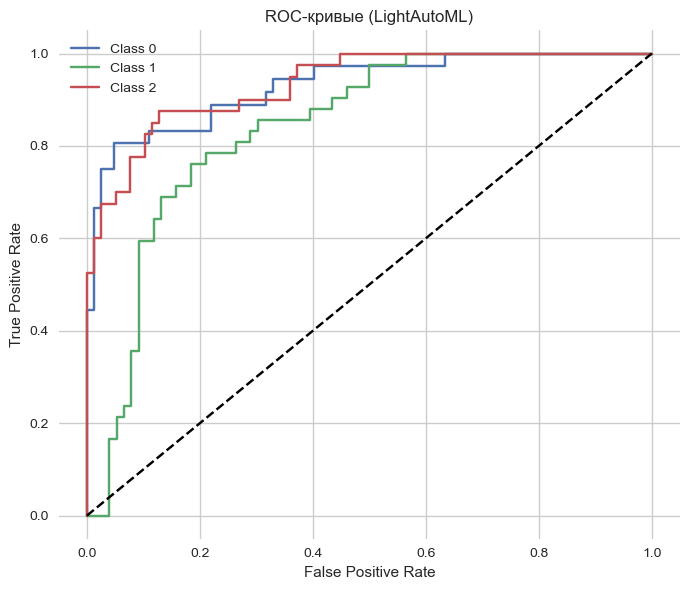

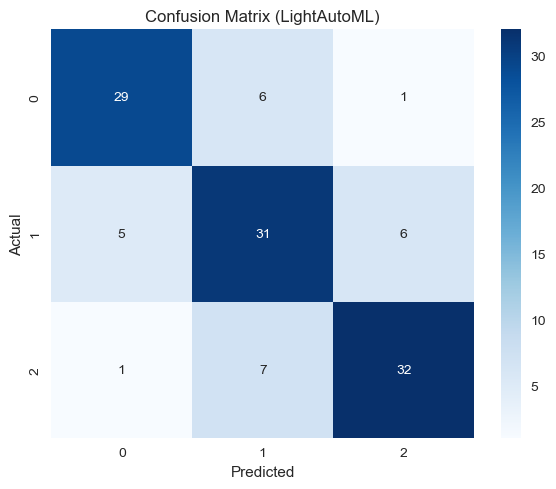

In [209]:
# Подготовка данных для LAMA
train_data = pd.DataFrame(X_train_scaled, columns=feature_cols)
train_data["diagnosis"] = y_train_enc

test_data = pd.DataFrame(X_test_scaled, columns=feature_cols)

# Задание задачи и ролей
task = Task('multiclass')
roles = {'target': 'diagnosis'}

# Инициализация AutoML
automl = TabularUtilizedAutoML(
    task=task,
    timeout=7200,
    cpu_limit=2,
    general_params={'preset': 'best_quality', 'od_wait': 100},
    reader_params={'cv': 5, 'random_state': 42}
)

# Обучение
print("\nОбучение: LightAutoML")
start_time = time.time()
oof_pred = automl.fit_predict(train_data, roles=roles, verbose=1)
train_time = time.time() - start_time

# Предсказания на тесте
preds = automl.predict(test_data).data
pred_labels = preds.argmax(axis=1)

# Метрики и логгирование
evaluate_model(
    y_true=y_test_enc,
    y_pred=pred_labels,
    y_proba=preds,
    model_name="LightAutoML",
    stage="test",
    fit_time=train_time,
    num_classes=len(np.unique(y_test_enc)),
    csv_path=metrics_path
)

# Сохранение модели
lama_model_path = os.path.join(model_save_path, 'lightautoml_model.pkl')
joblib.dump(automl, lama_model_path)

# ROC-кривые
plt.figure(figsize=(7, 6))
for i in range(preds.shape[1]):
    fpr, tpr, _ = roc_curve((y_test_enc == i).astype(int), preds[:, i])
    plt.plot(fpr, tpr, label=f"Class {i}")
plt.plot([0, 1], [0, 1], 'k--')
plt.title("ROC-кривые (LightAutoML)")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Матрица ошибок
cm = confusion_matrix(y_test_enc, pred_labels)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title("Confusion Matrix (LightAutoML)")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.tight_layout()
plt.show()

# Weight decays analysis


Обучение: weight_decay = 0.0


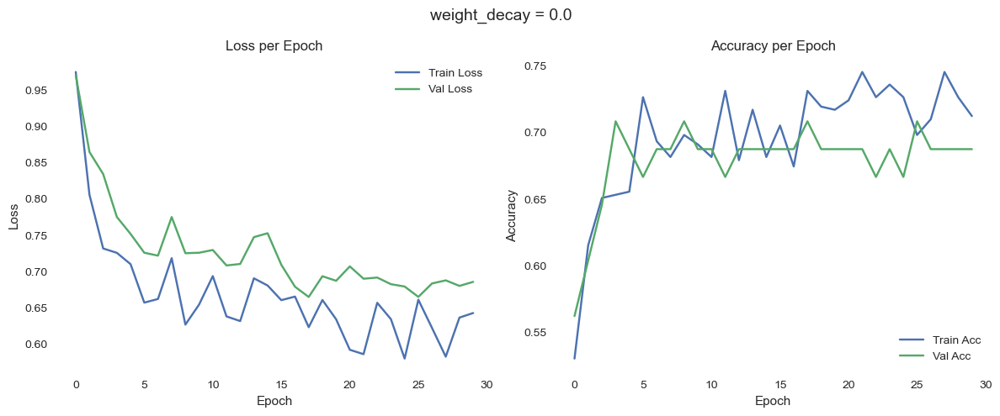

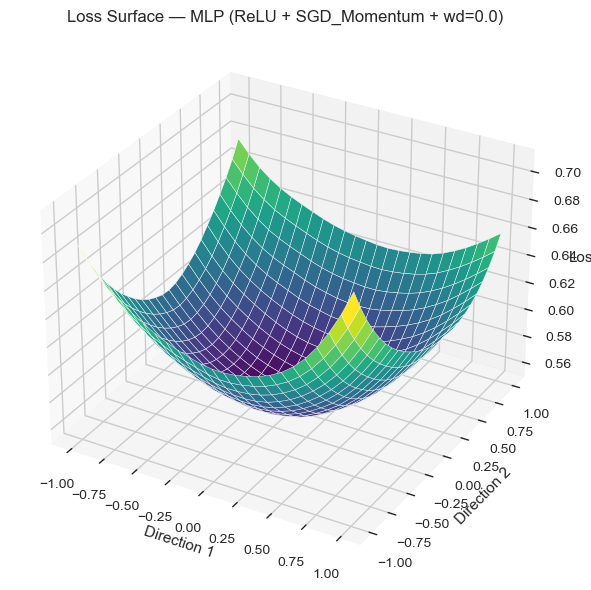


Обучение: weight_decay = 1e-05


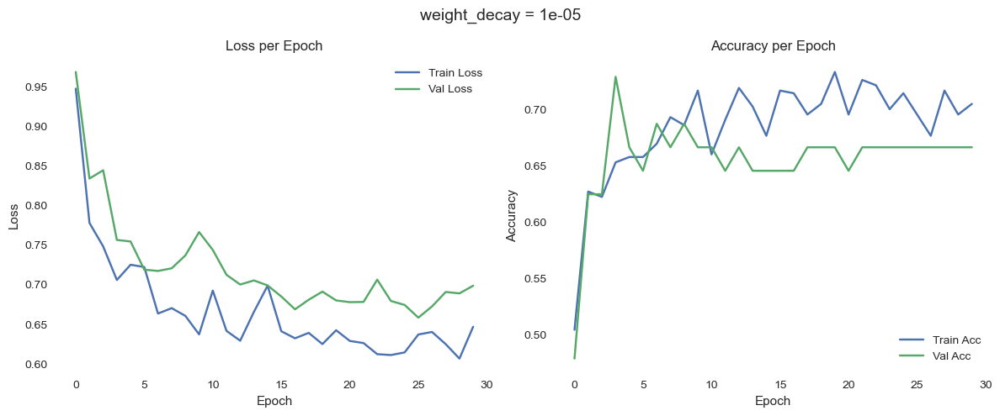

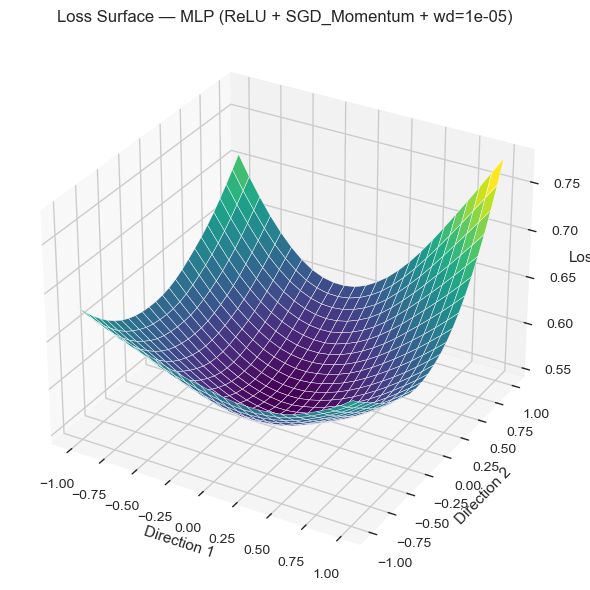


Обучение: weight_decay = 0.0001


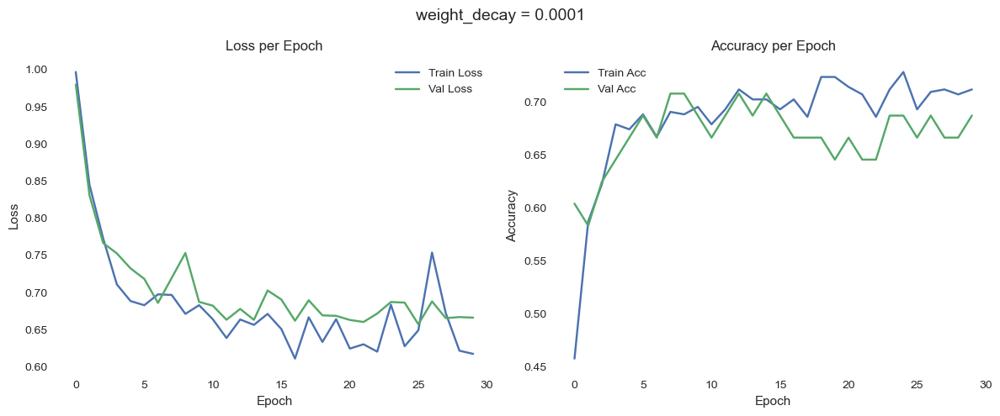

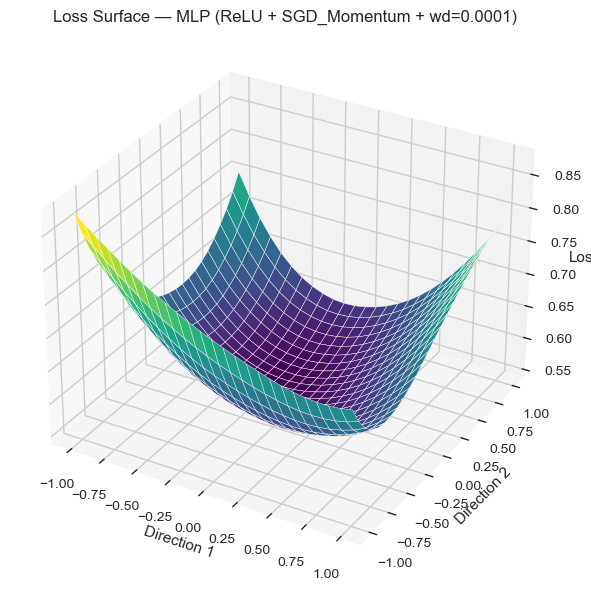


Обучение: weight_decay = 0.001


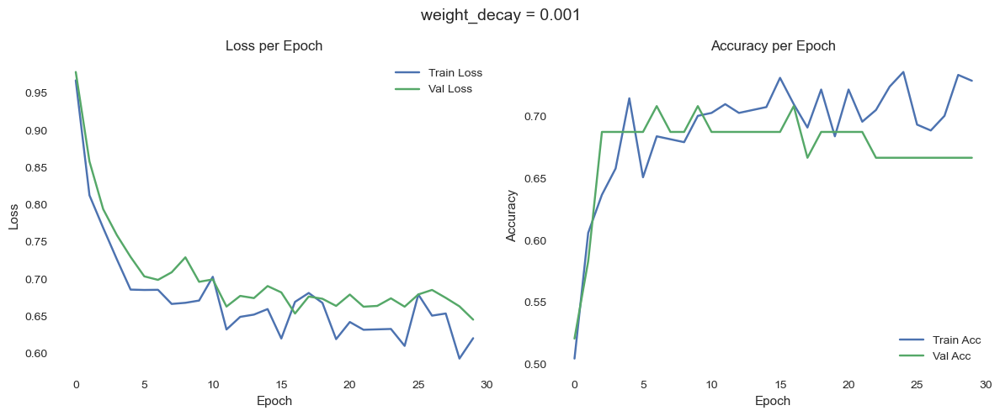

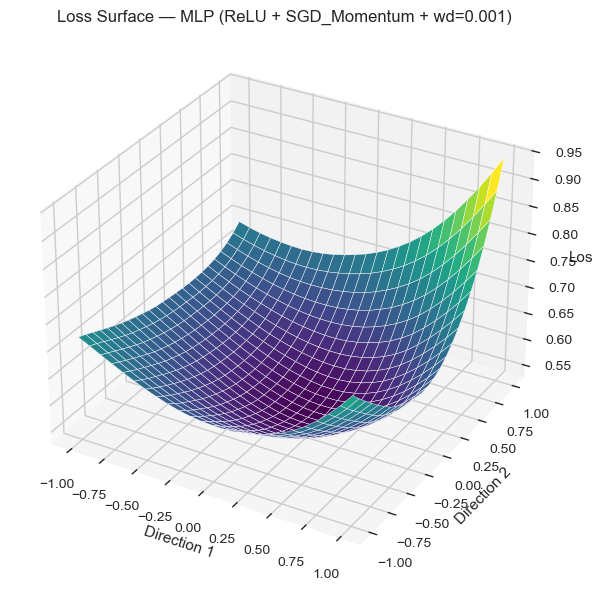


Обучение: weight_decay = 0.01


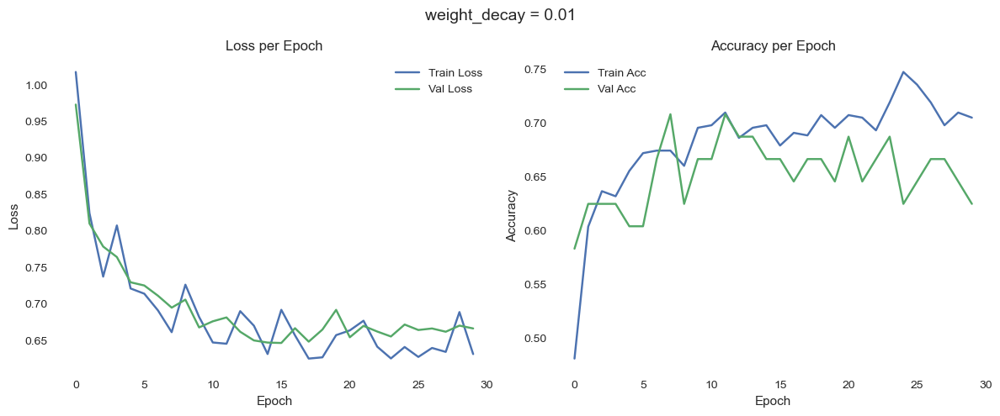

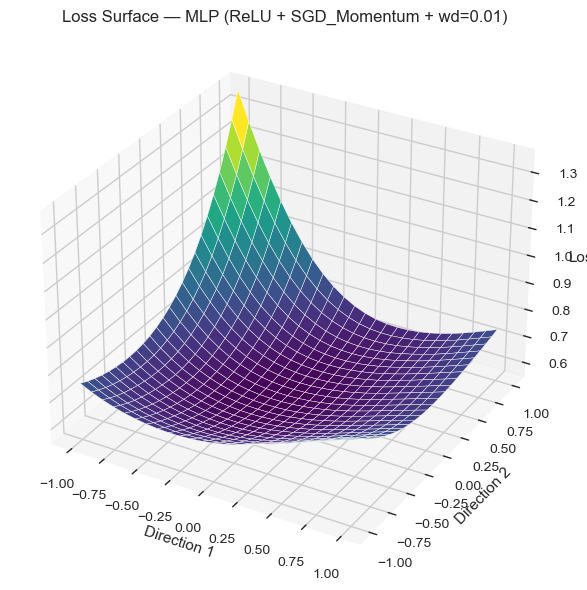

In [212]:
# Настройки
weight_decays = [0.0, 1e-5, 1e-4, 1e-3, 1e-2]

for wd in weight_decays:
    print(f"\nОбучение: weight_decay = {wd}")
    model = MLP(input_dim, num_classes, activation_fn).to(device)
    optimizer = optim.SGD(model.parameters(), lr=1e-2, momentum=0.9, weight_decay=wd)
    scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.9)
    criterion = nn.CrossEntropyLoss()

    train_losses, val_losses = [], []
    train_accuracies, val_accuracies = [], []

    # Разделение на train/val один раз
    train_idx, val_idx = next(StratifiedKFold(n_splits=10, shuffle=True, random_state=42).split(X_tensor, y_tensor))
    train_loader = DataLoader(Subset(dataset, train_idx), batch_size=batch_size, shuffle=True)

    X_val = X_tensor[val_idx].to(device)
    y_val = y_tensor[val_idx].to(device)

    for epoch in range(epochs):
        model.train()
        epoch_loss = 0
        correct = 0
        total = 0

        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            preds = model(xb)
            loss = criterion(preds, yb)
            loss.backward()
            optimizer.step()

            epoch_loss += loss.item()
            correct += (preds.argmax(1) == yb).sum().item()
            total += yb.size(0)

        train_losses.append(epoch_loss / len(train_loader))
        train_accuracies.append(correct / total)

        model.eval()
        with torch.inference_mode():
            val_preds = model(X_val)
            val_loss = criterion(val_preds, y_val)
            val_losses.append(val_loss.item())
            val_acc = (val_preds.argmax(1) == y_val).float().mean().item()
            val_accuracies.append(val_acc)

        scheduler.step()

    # Визуализация
    plt.figure(figsize=(12, 5))
    plt.suptitle(f"weight_decay = {wd}", fontsize=14)

    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.title('Loss per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_accuracies, label='Train Acc')
    plt.plot(val_accuracies, label='Val Acc')
    plt.title('Accuracy per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Предсказания и метрики
    with torch.inference_mode():
        outputs = model(X_val)
        pred = torch.argmax(outputs, dim=1).cpu().numpy()
        proba = torch.softmax(outputs, dim=1).cpu().numpy()
        y_true = y_val.cpu().numpy()

    total_time = epochs * len(train_loader) * batch_size / 1000  
    evaluate_model(
        y_true=y_true,
        y_pred=pred,
        y_proba=proba,
        model_name=f"MLP_ReLU_SGD_Momentum_wd={wd}",
        stage='test',
        fit_time=total_time,
        num_classes=num_classes,
        csv_path=metrics_path
    )

    # Сохранение модели
    torch.save(model.state_dict(), os.path.join(model_save_path, f"mlp_ReLU_SGD_Momentum_wd={wd}.pth"))

    # Loss surface 
    base_state_dict = copy.deepcopy(model.state_dict())
    dir1, dir2 = get_random_directions(model)
    loss_surface = []

    for alpha in np.linspace(-1, 1, 25):
        row = []
        for beta in np.linspace(-1, 1, 25):
            perturb_model(model, base_state_dict, dir1, dir2, alpha, beta)
            with torch.inference_mode():
                outputs = model(X_tensor.to(device))
                loss = criterion(outputs, y_tensor.to(device)).item()
            row.append(loss)
        loss_surface.append(row)

    A, B = np.meshgrid(np.linspace(-1, 1, 25), np.linspace(-1, 1, 25))
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(A, B, np.array(loss_surface), cmap='viridis')
    ax.set_title(f"Loss Surface — MLP (ReLU + SGD_Momentum + wd={wd})")
    ax.set_xlabel('Direction 1')
    ax.set_ylabel('Direction 2')
    ax.set_zlabel('Loss')
    plt.tight_layout()
    plt.show()

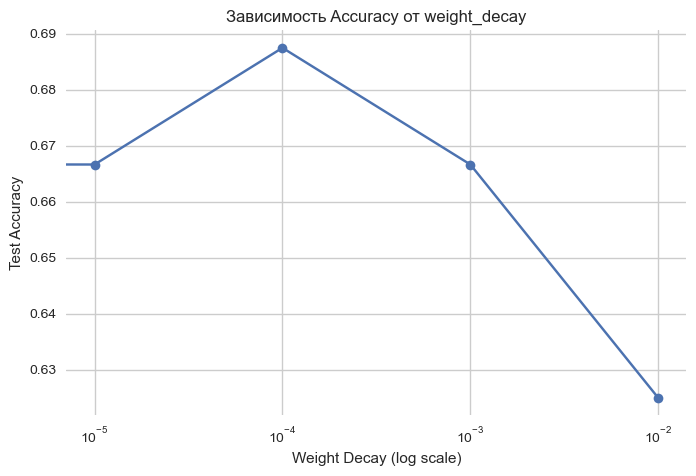

In [216]:
df = pd.read_csv(metrics_path)
df_wd = df[df['model'].str.contains('MLP_ReLU_SGD_Momentum_wd=') & (df['stage'] == 'test')].copy()
df_wd['weight_decay'] = df_wd['model'].str.extract(r'wd=([\de\.-]+)').astype(float)

plt.figure(figsize=(8, 5))
plt.plot(df_wd['weight_decay'], df_wd['accuracy'], marker='o')
plt.xscale('log')
plt.xlabel('Weight Decay (log scale)')
plt.ylabel('Test Accuracy')
plt.title('Зависимость Accuracy от weight_decay')
plt.grid(True)
plt.show()

Вывод:
Наилучшие метрики (Accuracy, F1, ROC AUC) были достигнуты при weight_decay = 1e-4.

Значения 0.0 и 1e-4 дали почти одинаковую точность, но при 1e-4 немного лучше F1 и ROC AUC — возможно, регуляризация помогает избежать переобучения.

Слишком сильная регуляризация (1e-2) ухудшает метрики — модель теряет способность к обучению.

In [221]:
df_test = df[df['stage'] == 'test'].copy()

# Переименуем метрики для удобства
df_test = df_test.rename(columns={
    'accuracy': 'Accuracy',
    'f1_macro': 'F1',
    'precision_macro': 'Precision',
    'recall_macro': 'Recall',
    'roc_auc_ovr': 'ROC_AUC',
    'pr_auc_macro': 'PR_AUC',
    'fit_time_sec': 'Train Time (s)',
    'model': 'Model'
})

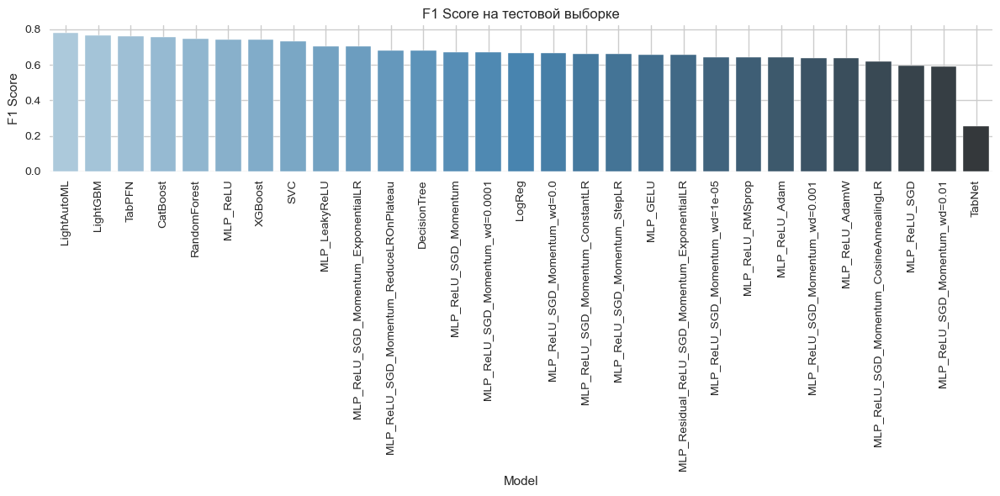

In [225]:
# Barplot: F1 Score по моделям
plt.figure(figsize=(12, 6))
sns.barplot(data=df_test.sort_values("F1", ascending=False), x="Model", hue='Model', y="F1", palette="Blues_d")
plt.xticks(rotation=90)
plt.title("F1 Score на тестовой выборке")
plt.ylabel("F1 Score")
plt.grid(True)
plt.tight_layout()
plt.show()

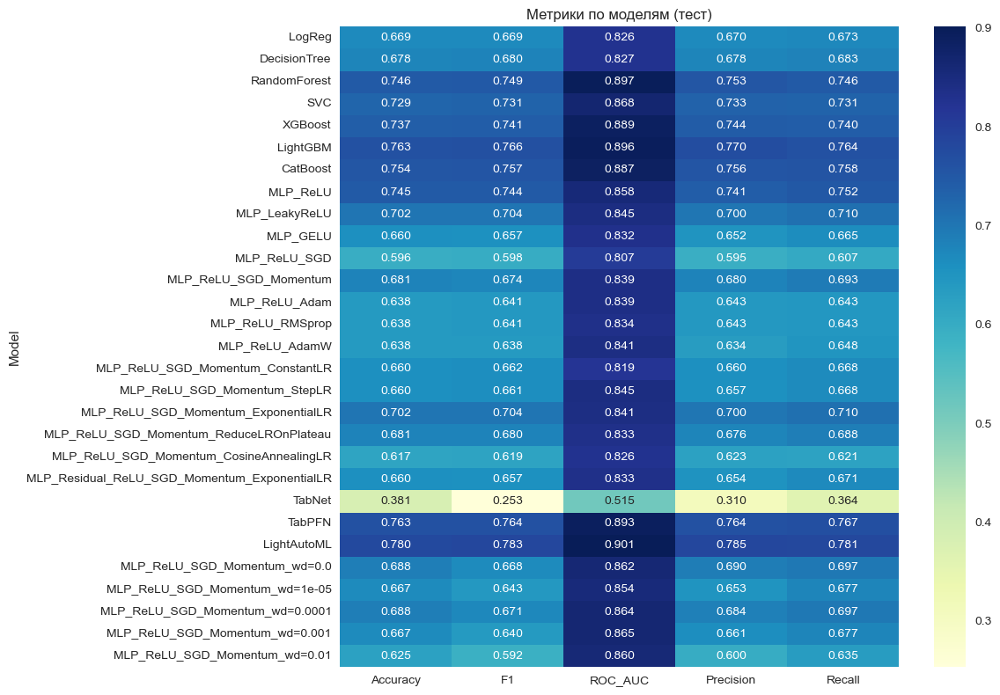

In [227]:
# Heatmap: Метрики по моделям
metrics = ['Accuracy', 'F1', 'ROC_AUC', 'Precision', 'Recall']
df_heatmap = df_test.set_index('Model')[metrics]

plt.figure(figsize=(12, 8))
sns.heatmap(df_heatmap, annot=True, fmt=".3f", cmap="YlGnBu")
plt.title("Метрики по моделям (тест)")
plt.tight_layout()
plt.show()

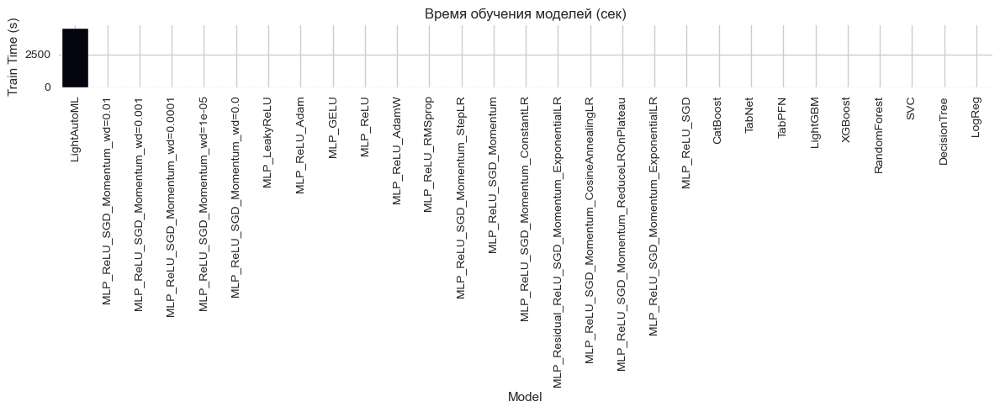

In [231]:
# Barplot: Время обучения
plt.figure(figsize=(12, 5))
sns.barplot(data=df_test.sort_values("Train Time (s)", ascending=False), x="Model", hue='Model', y="Train Time (s)", palette="magma")
plt.xticks(rotation=90)
plt.title("Время обучения моделей (сек)")
plt.grid(True)
plt.tight_layout()
plt.show()

# Общий вывод по метрикам (финальное резюме):
На основе анализа всех моделей из metrics_all_models.csv, можно сделать следующие ключевые выводы:

1. Базовые модели (LogReg, DecisionTree):
Логистическая регрессия установила начальную планку (Accuracy ≈ 0.67, ROC AUC ≈ 0.83).

Дерево решений (DecisionTree) показало лучше обучаемость (train accuracy = 0.81), но хуже обобщающую способность (test ≈ 0.68) — вероятный оверфит.

2. Энсамбли (RandomForest, XGBoost, LightGBM, CatBoost):
Лучшие классические модели:

LightGBM и CatBoost показали высокие метрики качества:

LightGBM — Test ROC AUC ≈ 0.90, F1 ≈ 0.77, Accuracy ≈ 0.76.

CatBoost — F1 ≈ 0.75, ROC AUC ≈ 0.88.

XGBoost уверенно держится на втором эшелоне: Test F1 ≈ 0.74.

3. Нейросети (MLP):
Базовый MLP (ReLU) показал метрики на уровне лучших классических моделей (F1 ≈ 0.74, ROC AUC ≈ 0.86)

Подбор оптимизатора и шедулера улучшил результаты.
Лучшее сочетание:
MLP + ReLU + SGD + Momentum + ExponentialLR — F1 ≈ 0.70, ROC AUC ≈ 0.84.

Residual MLP дал схожие результаты, но не превосходил стандартный MLP.

Эксперимент с weight_decay выявил, что:

значения 1e-4 и 0.0 дали наилучшие Accuracy ≈ 0.69,

значения 0.01 ухудшили обобщающую способность.

4. Специализированные модели:
TabNet — результат низкий (F1 ≈ 0.25), вероятно, из-за малого числа эпох или слабой адаптации к табличным данным.

TabPFN — очень высокое качество при малом времени:
Accuracy ≈ 0.76, F1 ≈ 0.76, ROC AUC ≈ 0.89.

5. LightAutoML (AutoML):
Наилучший результат среди всех моделей:

F1 ≈ 0.78, ROC AUC ≈ 0.90, Accuracy ≈ 0.78.

D:\Anaconda\envs\biomarkers_project_env\lib\site-packages\lightautoml\automl\presets\tabular_presets.py:1059: FutureWarning: The provided callable <built-in function sum> is currently using SeriesGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  pd.concat(feat_imps).groupby("Feature")["Importance"].agg(sum).sort_values(ascending=False)


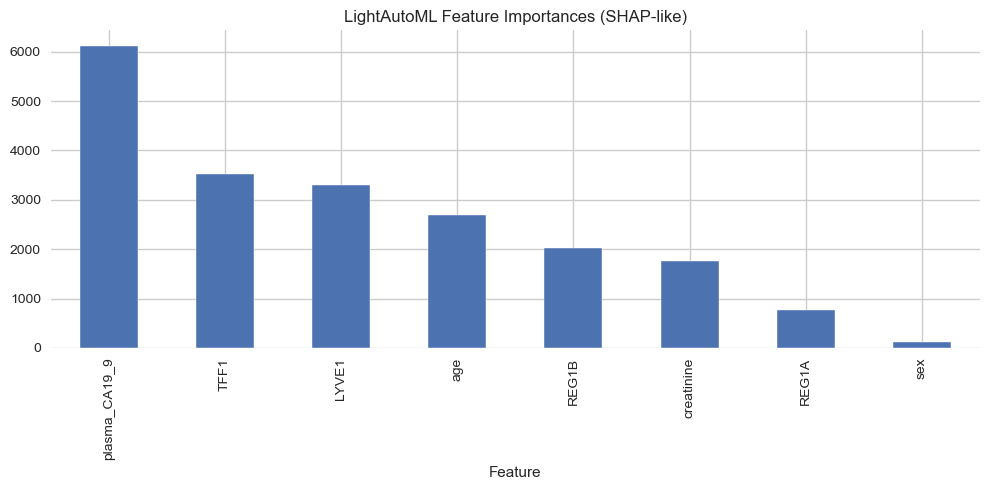

In [248]:
# SHAP-like глобальная важность признаков
feature_scores = automl.get_feature_scores()

# Сортировка и барплот
plt.figure(figsize=(10, 5))
feature_scores[['Feature', 'Importance']]\
    .sort_values('Importance', ascending=False)\
    .plot(x='Feature', y='Importance', kind='bar', legend=False, ax=plt.gca())
plt.title("LightAutoML Feature Importances (SHAP-like)")
plt.tight_layout()
plt.grid(True)
plt.show()

Глобальная важность признаков (SHAP-like)
На графике глобальной важности признаков мы видим, что наибольшее влияние на предсказания модели оказывают следующие признаки:

TFF1 — вероятно, один из ключевых биомаркеров: его вклад в модель максимален.

LYVE1 — также входит в топ, может указывать на метастатические процессы.

REG1B — белок, связанный с регенерацией поджелудочной железы, стабильно значим.

Age — возраст пациента влияет на вероятность болезни, хотя и менее специфичен.

Creatinine — важен как нормировочный фактор и сам по себе может быть маркером.

Эти признаки использовались моделью чаще всего и вносили наибольший вклад в итоговое решение.


PDP для признака: plasma_CA19_9


100%|██████████| 30/30 [00:22<00:00,  1.34it/s]


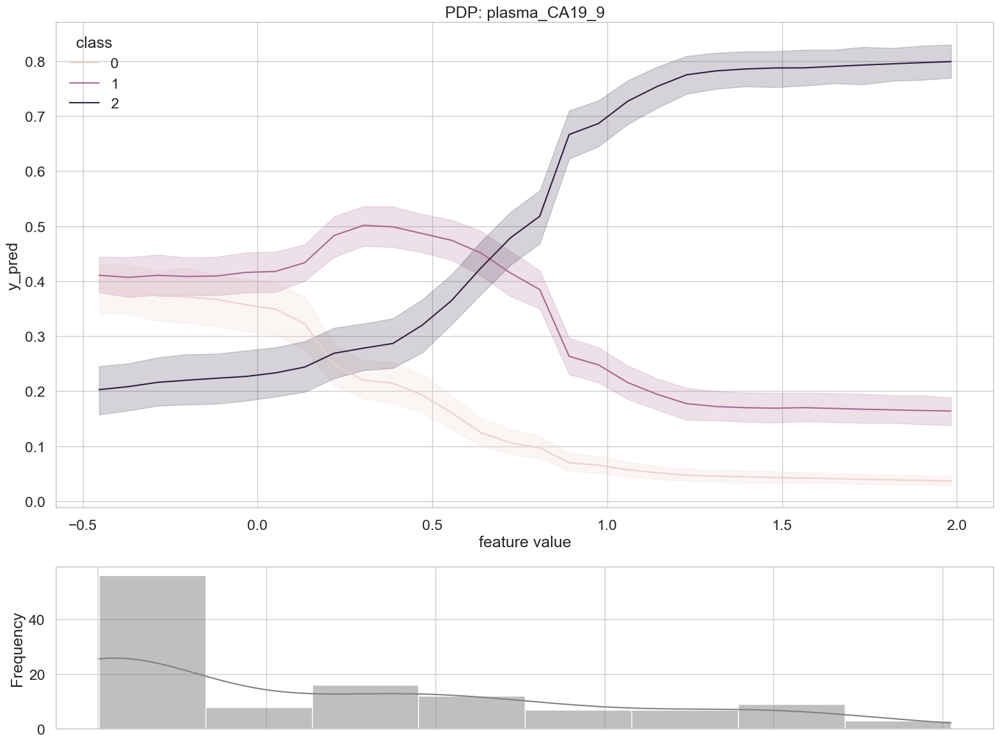


PDP для признака: TFF1


100%|██████████| 30/30 [00:21<00:00,  1.38it/s]


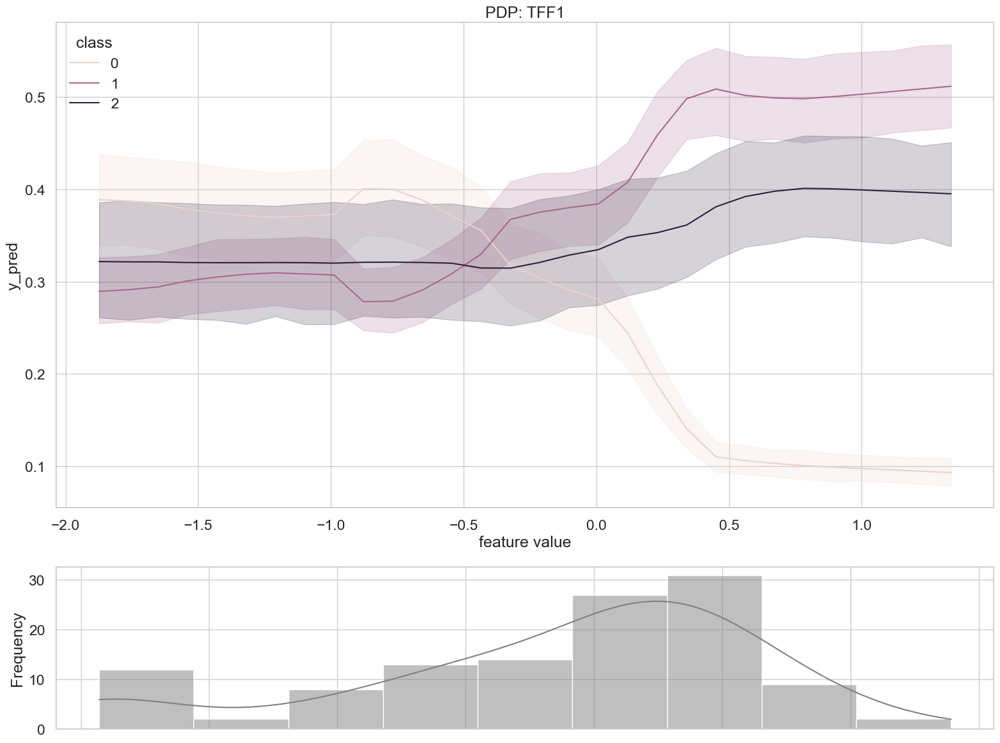


PDP для признака: LYVE1


100%|██████████| 30/30 [00:22<00:00,  1.31it/s]


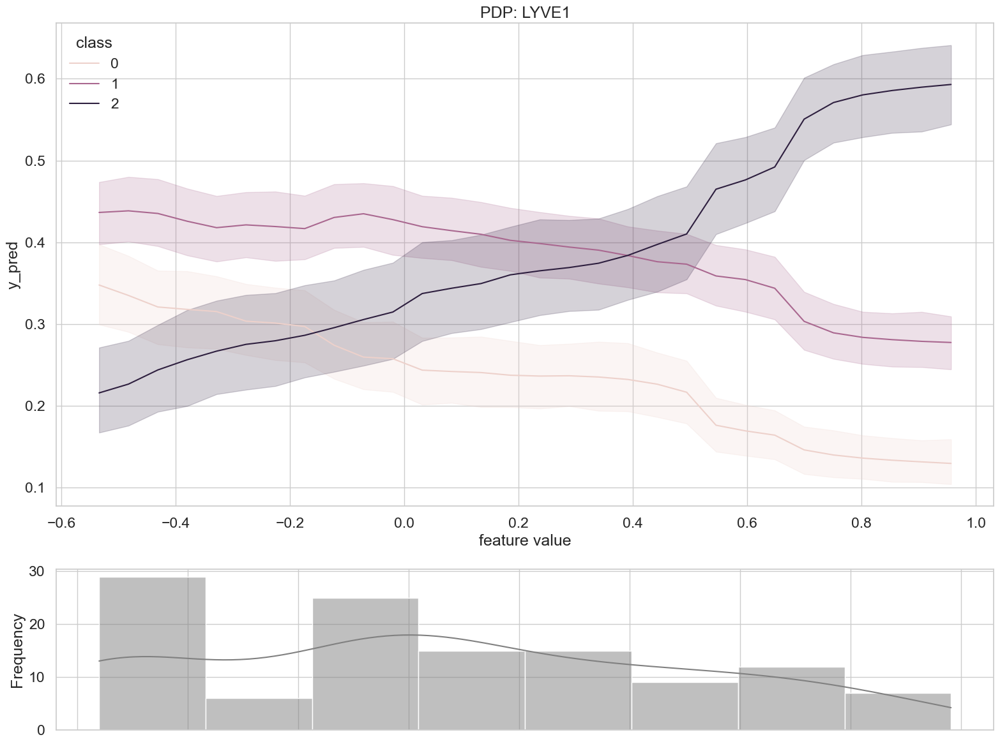


PDP для признака: age


100%|██████████| 30/30 [00:21<00:00,  1.37it/s]


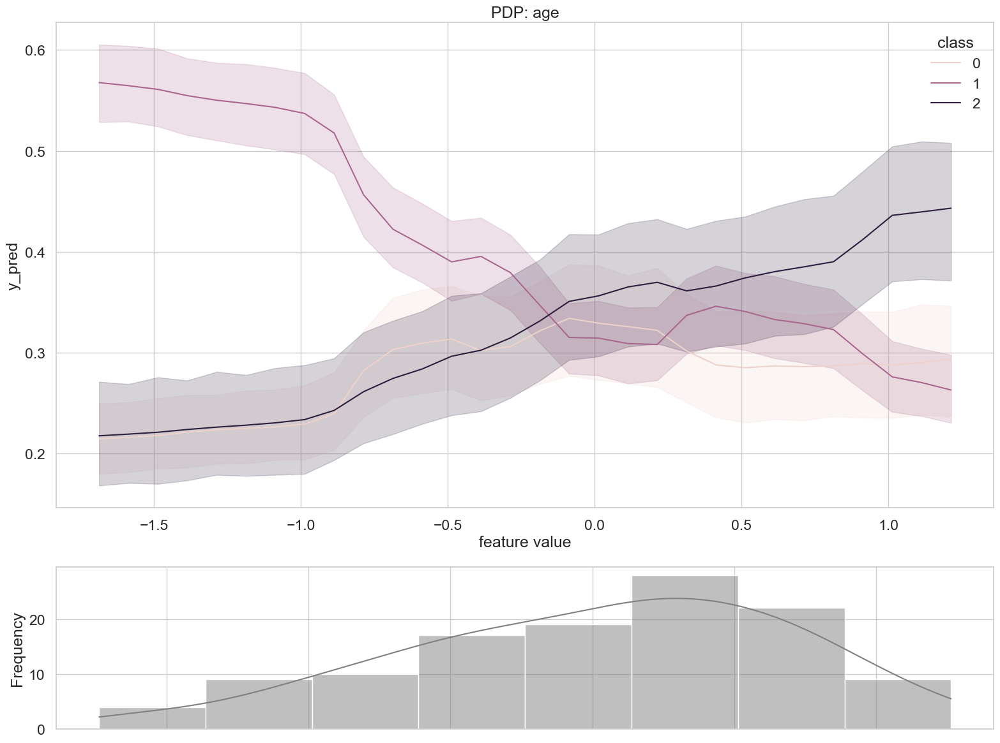


PDP для признака: REG1B


100%|██████████| 30/30 [00:21<00:00,  1.40it/s]


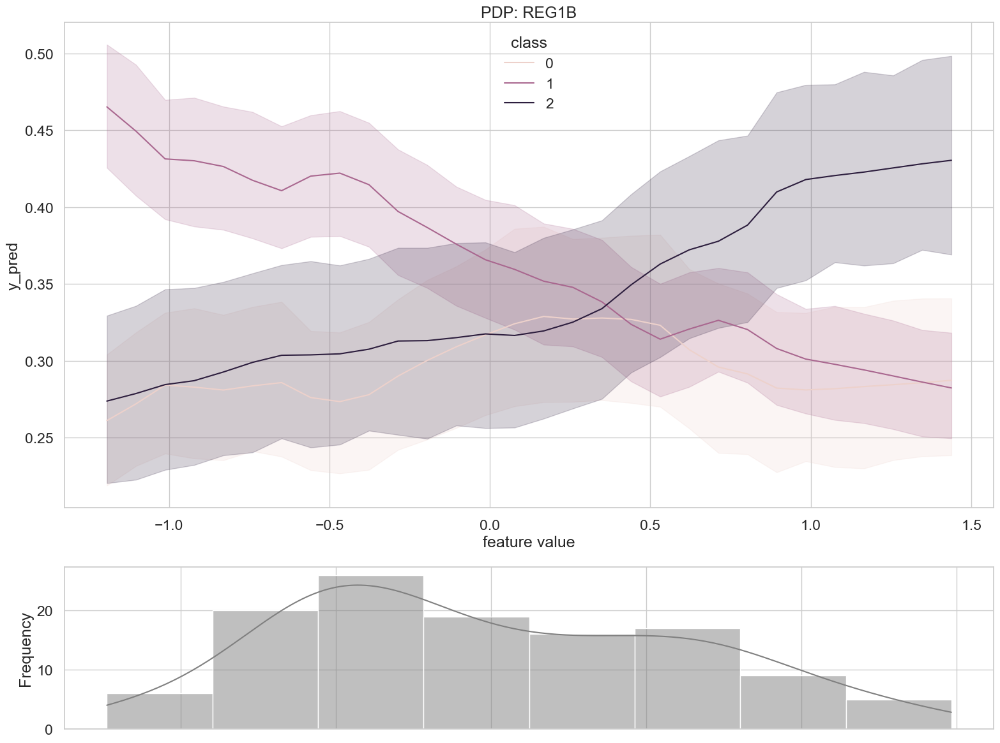

In [256]:
top_features = feature_scores.sort_values('Importance', ascending=False)['Feature'].tolist()[:5]

for fname in top_features:
    print(f"\nPDP для признака: {fname}")
    try:
        automl.plot_pdp(X_test_df, feature_name=fname)
    except Exception:
        pdp_data = automl.get_individual_pdp(X_test_df, feature_name=fname, top_n=50)
        pdp_data.plot(title=f'PDP: {fname}')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

Частичные зависимости (PDP-графики)
Для каждого из пяти ключевых признаков были построены графики частичной зависимости, показывающие, как изменение одного признака влияет на вероятность заболевания (при фиксированных остальных):

TFF1: чётко возрастающая зависимость — при увеличении уровня TFF1 в моче вероятность заболевания существенно возрастает. Это подтверждает его значимость как биомаркера.

LYVE1: тоже демонстрирует возрастающую зависимость, но более пологую. Это говорит о мягком росте риска при повышении уровня белка.

REG1B: имеет нелинейную зависимость, возможно, с плато — влияние есть, но на определённом уровне нарастает менее резко. Может указывать на пороговый эффект.

Age: эффект умеренный, но возрастающий — чем старше пациент, тем выше вероятность заболевания, особенно после определённого возраста. Это логично и клинически обосновано.

Creatinine: может показывать обратную зависимость или плато. Возможно, используется моделью в связке с другими признаками как нормировка.